<a href="https://colab.research.google.com/github/becha2003/ROP-optimization/blob/main/ROP_prediction_github.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Import packages

In [2]:
import pandas as pd
import numpy as np

In [3]:
import scipy.stats
from scipy.stats import normaltest

In [4]:
import seaborn
import seaborn as sns

import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
%matplotlib inline
plt.style.use('seaborn-white')

import warnings
warnings.filterwarnings('ignore')

In [5]:
pd.set_option('max.columns', 200)

In [6]:
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import r2_score
from sklearn.cluster import KMeans
from sklearn.model_selection import train_test_split

In [7]:
!pip3 install catboost

     |████████████████████████████████| 76.3 MB 22 kB/s 


In [8]:
from lightgbm import LGBMRegressor
from xgboost import XGBRegressor
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import GradientBoostingRegressor
from catboost import CatBoostRegressor
from sklearn.linear_model import LinearRegression

In [9]:
import missingno as msno
import joblib

In [10]:
pip install --upgrade pyswarm

  Created wheel for pyswarm: filename=pyswarm-0.6-py3-none-any.whl size=4479 sha256=40af5e5b8cc70cae91a81976737274522cbea746268926d322e24c109c6b190b
  Stored in directory: /root/.cache/pip/wheels/ac/69/65/926e9c51b9fa99757cb43e8f6b74c5e6bb8b41a038b35c2db1
Successfully built pyswarm


In [11]:
from pyswarm import pso

# Lists


In [12]:
random_state=12345678

In [13]:
# list of drilling parameters
drilling_param = ['SPP', 'ROP', 'Torque', 'RPM', 'WOB'] 
drilling_param_3 = ['SPP', 'ROP', 'RPM', 'WOB'] 
drilling_param_2 = ['ROP', 'RPM', 'WOB']

In [14]:
# list of formations
formation_list = ['form_A', 'form_B', 'form_C', 'form_D', 'form_E', 'form_F',
       'form_G', 'form_H', 'form_I', 'form_J', 'form_K']

In [15]:
# list of wells
wells = ['well_Q', 'well_W', 'well_E', 'well_R', 'well_T']

In [16]:
# list of models for ROP prediction
list_models = ['LGBMRegressor',
               'XGBRegressor',
               'DecisionTreeRegressor',
               'RandomForestRegressor',
               'KNeighborsRegressor',
               'GradientBoostingRegressor',
               'CatBoostRegressor',
               'LinearRegression']

In [17]:
# models ROP prediction

models = [
          LGBMRegressor(verbosity=0, random_state=random_state),
          XGBRegressor(verbosity=0, random_state=random_state),
          DecisionTreeRegressor(),
          RandomForestRegressor(),
          KNeighborsRegressor(),
          GradientBoostingRegressor(verbose=0, random_state=random_state),
          CatBoostRegressor(verbose=0, random_state=random_state),
          LinearRegression()
               ]

# --- READ ---

In [31]:
section = pd.read_csv('/content/drive/My Drive/ROP/!_ROP_final_code/section_16_data/section_16_art.csv')

In [32]:
section.shape

(62307, 24)

In [33]:
section.head(4)

,MD,LM,LM_DLM,DLM,DLM_C,E_GA,E_KMN,EXTR,SHC,SHS,SILT,UNS,SND,GR,DTC,RHOB,SPP,ROP,Torque,RPM,WOB,Formation,Well,MD_form
0,358.83,0.49,0.0,0.0,38.77,55.0,0.0,0.0,5.74,0.0,0.0,0.0,0.0,15.46,58.20,2.35,627.62,0.46,1601.82,48.97,9.50,form_A,well_Q,0.00
1,358.96,1.00,0.0,0.0,37.50,55.0,0.0,0.0,6.50,0.0,0.0,0.0,0.0,20.07,63.45,2.22,406.22,0.78,870.23,38.25,3.25,form_A,well_Q,0.15
2,359.08,1.51,0.0,0.0,36.22,55.0,0.0,0.0,7.26,0.0,0.0,0.0,0.0,24.11,69.39,2.07,392.69,2.40,765.67,33.05,2.21,form_A,well_Q,0.30
3,359.21,2.02,0.0,0.0,34.96,55.0,0.0,0.0,8.02,0.0,0.0,0.0,0.0,26.26,75.44,1.95,388.57,2.86,742.12,34.66,2.54,form_A,well_Q,0.45


# Clustering

### function for visualization

In [34]:
def fun_pso_results_vizual(data, data_form):
  fig = plt.figure(figsize=(50,13))
 
  gs1 = GridSpec(1, 37, left=0.05, right=0.95, hspace=0.05, wspace=0.1, width_ratios=[
                          0.4, 0.7, 1, 1, 1, 1, 1, 1, 1, 1, 1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1])


  ax0 = fig.add_subplot(gs1[0,0]) # MD
  ax1 = fig.add_subplot(gs1[0,1], sharey=ax0) # GR # sharey - чтобы сетка была как в ах0
  
  ax2 = fig.add_subplot(gs1[0,2], sharey=ax0) # DTC
  ax2_1 = ax2.twiny()
  ax2_2 = ax2.twiny()
  ax2_3 = ax2.twiny()
  ax2_4 = ax2.twiny()

  ax3 = fig.add_subplot(gs1[0,3], sharey=ax0) # RHOB
  ax3_1 = ax3.twiny()
  ax3_2 = ax3.twiny()
  ax3_3 = ax3.twiny()
  ax3_4 = ax3.twiny()
#-----------------------------------------------------------------------------------------------  
  ax4 = fig.add_subplot(gs1[0,4], sharey=ax0) # SPP
#-----------------------------------------------------------------------------------------------
  ax8 = fig.add_subplot(gs1[0,5], sharey=ax0)  # Torque
#-----------------------------------------------------------------------------------------------
  ax13 = fig.add_subplot(gs1[0,6], sharey=ax0)  # RPM
#-----------------------------------------------------------------------------------------------
  ax17 = fig.add_subplot(gs1[0,7], sharey=ax0)  # WOB
#-----------------------------------------------------------------------------------------------
  ax21 = fig.add_subplot(gs1[0,8], sharey=ax0) # ROP
#-----------------------------------------------------------------------------------------------
  ax23 = fig.add_subplot(gs1[0,9], sharey=ax0) # кластеры
  ax23_1 = ax23.twiny()
  ax23_2 = ax23.twiny()
  ax23_3 = ax23.twiny()
  ax23_4 = ax23.twiny()

#-----------------------------------------------------------------------------------------------
  ax_list =    [ax1, ax2, ax3, ax4, ax8, ax13, ax17, ax21, ax23]
  track_list = [ax1, ax2, ax3, ax4, ax8, ax13, ax17, ax21, ax23] # линии сетки

############################ фон для всех графиков ############################################
  for ax in track_list:
    #ax.grid(True, color='0.8', dashes=(5,2,1,2))
    ax.grid(True, color='#EEEEEE', linestyle=':', linewidth=0.5)
    ax.set_facecolor('#ffffed')
  
  for ax in ax_list:
    plt.setp(ax.get_yticklabels(), visible = False)

  ############################ track 0: depth ############################################
  ax0.plot(np.zeros(len(data['MD'])), data['MD'], color='k', alpha=.1, lw=1, ls= '-') # по Х всё заполнили нулями
  
  ax0.tick_params(axis="y",direction="in", pad=-38)
  
  ax0.set_xlabel('MD(m)', fontsize = '12' )
  ax0.xaxis.set_label_position("top")
  ax0.set_xticklabels('')
  ax0.tick_params(axis='y', colors="lightyellow", labelsize=12)
  ax0.set_facecolor('k')
  ax0.set_xticks([0, 1])
  ax0.set_xlim(0, 1)
 ############################ track 1: GR ############################################
  ax1.plot(data['GR'], data['MD'], color='red', alpha=1, lw=0.4, ls= '-')
  ax1.fill_betweenx(data['MD'], data['GR'],0, facecolor='gray', alpha=.4)

  ax1.set_xlabel("Gamma Ray", fontsize = '8' )
  ax1.xaxis.set_label_position("top")
  ax1.xaxis.set_ticks_position("top")
  ax1.xaxis.label.set_color("g")
  
  ax1.set_xlim(0, 100)
 
  ax1.tick_params(axis='x', colors="g") # шкала по Х
  ax1.spines["top"].set_edgecolor("g") # цвет оси по Х
  ax1.spines["top"].set_position(("axes", 1.0)) # расстояние между именем и линией 
  ax1.set_xticks([0, 50, 100])    # шкала 
  ax1.tick_params(labelsize=8) # размер шрифта шкалы по Х
  ax1.invert_yaxis()           # переворот 
  
  ############################ tracks ЛОГИ  ############################################
  #log_method(data, ax2, 'DTC', 'blue', 1.0, 'DTC', 'DTC', data_form, 'statter')
  log_method(data.query('clusters == 1'), ax2_1, 'DTC', 'orange', 1.0, 'DTC', 'DTC', data_form, 'statter')
  log_method(data.query('clusters == 2'), ax2_2, 'DTC', 'red', 1.0, 'DTC', 'DTC', data_form, 'statter')
  log_method(data.query('clusters == 3'), ax2_3, 'DTC', 'blue', 1.0, 'DTC', 'DTC', data_form, 'statter')
  log_method(data.query('clusters == 4'), ax2_4, 'DTC', 'green', 1.0, 'DTC', 'DTC', data_form, 'statter')
  
  #log_method(data, ax3, 'RHOB', 'blue', 1.0, 'RHOB', 'RHOB', data_form, 'statter')
  log_method(data.query('clusters == 1'), ax3_1, 'RHOB', 'orange', 1.0, 'RHOB', 'RHOB', data_form, 'statter')
  log_method(data.query('clusters == 2'), ax3_2, 'RHOB', 'red', 1.0, 'RHOB', 'RHOB', data_form, 'statter')
  log_method(data.query('clusters == 3'), ax3_3, 'RHOB', 'blue', 1.0, 'RHOB', 'RHOB', data_form, 'statter')
  log_method(data.query('clusters == 4'), ax3_4, 'RHOB', 'green', 1.0, 'RHOB', 'RHOB', data_form, 'statter')
    
  ############################ tracks БУРЕНИЕ  ############################################
  
  # --------------------- SPP ---------------
  log_method(data, ax4, 'SPP',     'red',  1.0, 'SPP', 'SPP', data_form, 'line')

  # --------------------- Torque ---------------
  log_method(data, ax8,  'Torque',     'red',  1.0,    'Torque', 'Torque', data_form, 'line')

  # --------------------- RPM ---------------
  log_method(data, ax13, 'RPM',     'red',  1.0,  'RPM', 'RPM', data_form, 'line')
  
  # --------------------- WOB ---------------
  log_method(data, ax17, 'WOB',     'red',  1.0,  'WOB', 'WOB', data_form, 'line')

  # --------------------- ROP ---------------
  log_method(data, ax21, 'ROP',     'red',  1.0, 'ROP', 'ROP', data_form, 'line')
    
  # --------------------- кластеры ---------------
  log_method(data.query('clusters == 1'), ax23_1, 'clusters', 'orange', 1.0, 'clusters', 'clusters', data_form, 'statter')
  log_method(data.query('clusters == 2'), ax23_2, 'clusters', 'red', 1.0, 'clusters', 'clusters', data_form, 'statter')
  log_method(data.query('clusters == 3'), ax23_3, 'clusters', 'blue', 1.0, 'clusters', 'clusters', data_form, 'statter')
  log_method(data.query('clusters == 4'), ax23_4, 'clusters', 'green', 1.0, 'clusters', 'clusters', data_form, 'statter')



In [35]:
# subfunction for logs visualization

def log_method(data, number_plot, method, color, second, method_scale, legend, data_form, plot):
  
  if plot == 'line':
    number_plot.plot(data[method], data['MD'], color=color, alpha=1, lw=0.8, ls= '-')
  else:
    number_plot.scatter(x = data[method], y = data['MD'], marker = '.', color = color, s = 10, label = '')

  number_plot.set_xlabel(legend, fontsize = '8' )
  number_plot.xaxis.set_label_position("top")
  number_plot.xaxis.set_ticks_position("top")
  number_plot.xaxis.label.set_color(color)
  
  
  number_plot.set_xlim(data_form[method_scale].min()*0.75, data_form[method_scale].max()*1.1)
  

  number_plot.tick_params(axis='x', colors=color) # шкала по Х
  number_plot.spines["top"].set_edgecolor(color) # цвет оси по Х
  number_plot.spines["top"].set_position(("axes", second)) # расстояние между именем и линией
  
  number_plot.tick_params(labelsize=7)    # размер шрифта шкалы по Х

## ['RHOB', 'DTC']

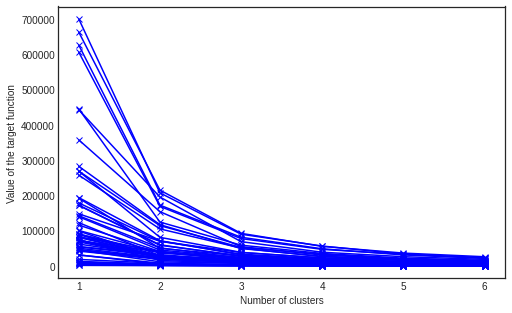

In [36]:
table_clusters = pd.DataFrame(columns = range(1, 7))
param_clusters = ['RHOB', 'DTC']
plt.figure(figsize=(8, 5))

for formation in formation_list:
  temp = section.query('Formation == @formation')

  for well in wells:
    temp_2 = temp.query('Well == @well')
    
    distortion = []
    K = range(1, 7)
    for k in K:
      model = KMeans(n_clusters=k, random_state=12345)
      model.fit(temp_2[param_clusters])
      distortion.append(model.inertia_)
  
    plt.plot(K, distortion, 'bx-')
    plt.xlabel('Number of clusters')
    plt.ylabel('Value of the target function')


In [37]:
temp = section.query('Well == "well_Q" and Formation == "form_A"')

In [38]:
param_clusters = ['RHOB', 'DTC']

In [39]:
distortion = []
K = range(1, 7)
for k in K:
    model = KMeans(n_clusters=k, random_state=12345)
    model.fit(temp[param_clusters])

    distortion.append(model.inertia_)

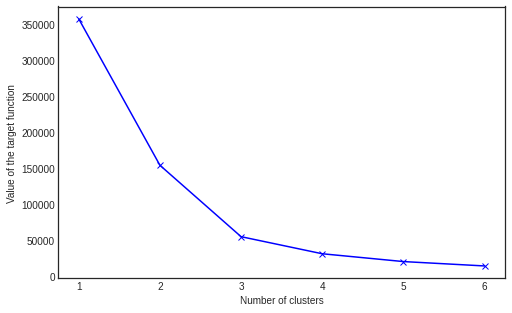

In [40]:
plt.figure(figsize=(8, 5))
plt.plot(K, distortion, 'bx-')
plt.xlabel('Number of clusters')
plt.ylabel('Value of the target function')
plt.show()

In [41]:
model = KMeans(n_clusters=4, random_state=12345)
model.fit(temp[param_clusters])
    
temp['clust'] = model.labels_.astype(str)
temp['clusters'] = model.labels_.astype(float)


(40.0, 160.0)

<Figure size 576x576 with 0 Axes>

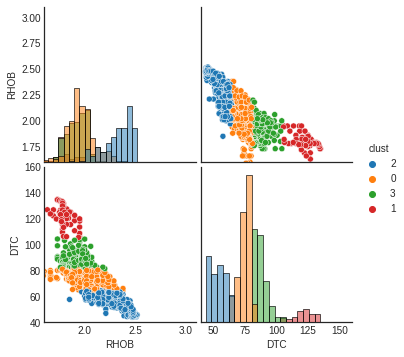

In [42]:
plt.figure(figsize=(8,8))

ax = sns.pairplot(temp[['RHOB', 'DTC', 'clust']], hue='clust', diag_kind='hist', diag_kws={'bins': 20})

ax.axes[0,0].set_xlim((1.6,3.1))  # RHOB
ax.axes[0,1].set_xlim((40,160))   # DTC

ax.axes[0,0].set_ylim((1.6, 3.1)) # RHOB
ax.axes[1,0].set_ylim((40, 160))  # DTC

In [43]:
temp['clusters'] = temp['clusters'] + 1

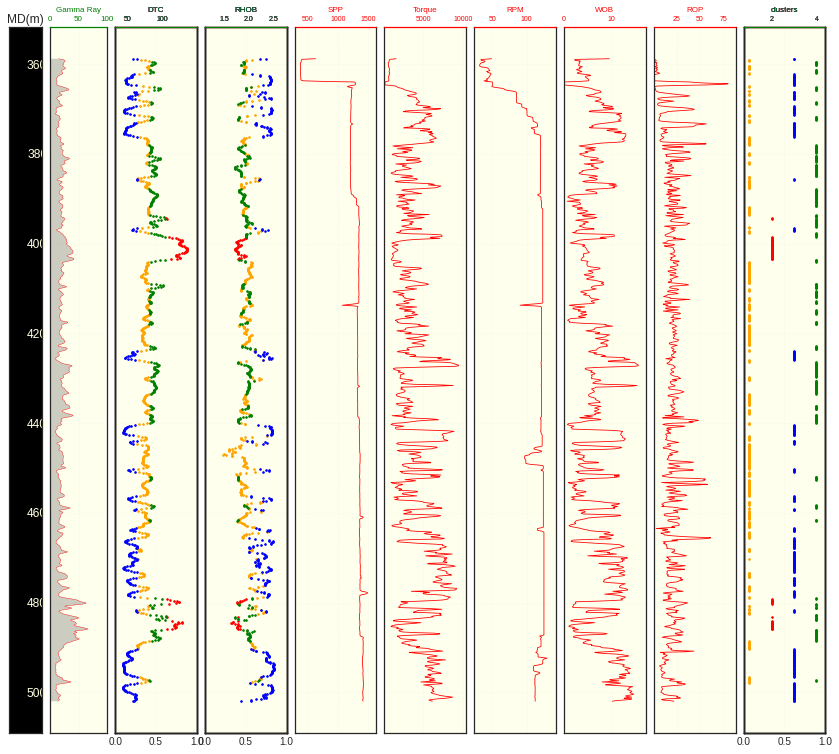

In [44]:
fun_pso_results_vizual(temp, temp)

## clusterization

In [45]:
param_clusters = ['RHOB', 'DTC']

section_clust = pd.DataFrame() 

for formation in formation_list:
  TEMP_1 = section.query('Formation == @formation')
  for well in wells:
    TEMP_2 = TEMP_1.query('Well == @well')
  
    model = KMeans(n_clusters=4, random_state=12345)
    model.fit(TEMP_2[param_clusters])
    
    TEMP_2['label'] = model.labels_.astype(str)
    TEMP_2['clusters'] = model.labels_.astype(float)
  
    section_clust = pd.concat([section_clust, TEMP_2])

In [47]:
section = section_clust.copy()

In [48]:
section.head(3)

,MD,LM,LM_DLM,DLM,DLM_C,E_GA,E_KMN,EXTR,SHC,SHS,SILT,UNS,SND,GR,DTC,RHOB,SPP,ROP,Torque,RPM,WOB,Formation,Well,MD_form,label,clusters
0,358.83,0.49,0.0,0.0,38.77,55.0,0.0,0.0,5.74,0.0,0.0,0.0,0.0,15.46,58.20,2.35,627.62,0.46,1601.82,48.97,9.50,form_A,well_Q,0.00,2,2.0
1,358.96,1.00,0.0,0.0,37.50,55.0,0.0,0.0,6.50,0.0,0.0,0.0,0.0,20.07,63.45,2.22,406.22,0.78,870.23,38.25,3.25,form_A,well_Q,0.15,2,2.0
2,359.08,1.51,0.0,0.0,36.22,55.0,0.0,0.0,7.26,0.0,0.0,0.0,0.0,24.11,69.39,2.07,392.69,2.40,765.67,33.05,2.21,form_A,well_Q,0.30,0,0.0


# Anomalies

## Marking of anomalies

In [49]:
prob_list = ['SPP_prb','ROP_prb', 'Torque_prb', 'RPM_prb', 'WOB_prb']
prob_list_vld = ['SPP_prb_vld','ROP_prb_vld', 'Torque_prb_vld', 'RPM_prb_vld', 'WOB_prb_vld']

In [50]:
section[['SPP_prb', 'ROP_prb', 'Torque_prb', 'RPM_prb', 'WOB_prb']] = 1
section[['SPP_prb_vld', 'ROP_prb_vld', 'Torque_prb_vld', 'RPM_prb_vld', 'WOB_prb_vld']] = 1

In [52]:
# anomaly detection using IQR

def fun_min_for_norm(data, parameter):
  min_value = ''
  qnt = data[parameter].describe()
  min_value = qnt[4] - 1.5*(qnt[6]-qnt[4])
  if min_value < 0:
    min_value = 0   
  return min_value

def fun_max_for_norm(data, parameter):
  max_value = ''
  qnt = data[parameter].describe()
  max_value = qnt[6] + 1.5*(qnt[6]-qnt[4])
  return max_value  

In [53]:
section_prob = pd.DataFrame()

for formation in formation_list:
  TEMP_1 = section.query('Formation == @formation')

  for well in wells:
    TEMP_2 = TEMP_1.query('Well == @well')

    for parameter, prob, prob_vld in zip(drilling_param, prob_list, prob_list_vld):
      
      #-------------- probability for each value -----
      sample = TEMP_2[parameter].to_list()
      kde = scipy.stats.gaussian_kde(sample)
      all_samples = []
      for i in range(len(sample)):
        kde_pdf = kde.pdf(sample[i])
        all_samples.append(kde_pdf[0])
      TEMP_2[prob] = all_samples

      #-------------- normality test ---
   
      alpha = 0.05
      stat, p = normaltest(TEMP_2[parameter])

      if p > alpha:
        print(f'dist looks Gaussian -- {parameter}, {well}, {formation}')

        min_value = fun_min_for_norm(TEMP_2, parameter)
        max_value = fun_max_for_norm(TEMP_2, parameter)
        
        TEMP_2.loc[(TEMP_2[parameter] <= min_value) & (TEMP_2[parameter] >= max_value), prob_vld] = 0

      else:
        #-------------- cut 10% ---
        treshold_prob = TEMP_2[prob].max()*0.10
        TEMP_2.loc[(TEMP_2[prob] <= treshold_prob, prob_vld)] = 0

    section_prob = pd.concat([section_prob, TEMP_2])

dist looks Gaussian -- ROP, well_Q, form_F
dist looks Gaussian -- Torque, well_R, form_F
dist looks Gaussian -- Torque, well_T, form_F
dist looks Gaussian -- Torque, well_W, form_H
dist looks Gaussian -- Torque, well_T, form_H
dist looks Gaussian -- WOB, well_T, form_H
dist looks Gaussian -- Torque, well_W, form_I
dist looks Gaussian -- WOB, well_W, form_J
dist looks Gaussian -- Torque, well_E, form_J
dist looks Gaussian -- Torque, well_Q, form_K
dist looks Gaussian -- SPP, well_E, form_K
dist looks Gaussian -- Torque, well_R, form_K


In [54]:
section_prob.shape

(62307, 36)

In [55]:
section_prob[['SPP_prb', 'ROP_prb', 'Torque_prb', 'RPM_prb', 'WOB_prb']].describe()

,SPP_prb,ROP_prb,Torque_prb,RPM_prb,WOB_prb
count,62307.000000,62307.000000,6.230700e+04,62307.000000,62307.000000
mean,0.007347,0.037414,1.963218e-04,0.113279,0.157760
std,0.006436,0.025509,1.063127e-04,0.136223,0.095745
min,0.000005,0.000066,4.400883e-07,0.000083,0.000352
25%,0.003055,0.021447,1.178991e-04,0.041693,0.089958
50%,0.005433,0.033301,1.880553e-04,0.069557,0.139652
75%,0.009782,0.049596,2.587049e-04,0.131722,0.210189
max,0.048199,0.280407,5.152237e-04,0.857508,0.616484


In [56]:
section_prob[['SPP_prb_vld', 'ROP_prb_vld', 'Torque_prb_vld', 'RPM_prb_vld', 'WOB_prb_vld']].describe()

,SPP_prb_vld,ROP_prb_vld,Torque_prb_vld,RPM_prb_vld,WOB_prb_vld
count,62307.000000,62307.000000,62307.000000,62307.000000,62307.000000
mean,0.980371,0.964498,0.966007,0.956008,0.969201
std,0.138721,0.185045,0.181213,0.205079,0.172774
min,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1.000000,1.000000,1.000000,1.000000,1.000000
50%,1.000000,1.000000,1.000000,1.000000,1.000000
75%,1.000000,1.000000,1.000000,1.000000,1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000


## visualization of distribution  

In [58]:
def summary_plot(data, formation, well):
  fig, ax = plt.subplots(4, len(drilling_param), figsize=(30, 15), constrained_layout=True, gridspec_kw={'height_ratios': [2, 1, 2, 10]})

  i = -1
  for parameter, prob, prob_vld in zip(drilling_param, prob_list, prob_list_vld):
    i = i+1
    #----------------------------
    data[[parameter]].hist(bins=30, ax=ax[0,i], density = True, alpha=.6)  
    ax[0,i].axvline(data[parameter].mean(), color='green', linestyle='--', label = 'mean')     # mean
    ax[0,i].axvline(data[parameter].median(), color='blue', linestyle='--', label = 'median')  # median
    
    # normality test to visualise cases where the distribution is normal
    alpha = 0.05
    stat, p = normaltest(data[parameter])
    if p < alpha:
      ax[0,i].axvline(data[parameter].quantile(0.5 - 0.975/2), color='red', linestyle='--', label = 'perc 2.5%')  # quantile 0.025 %
      ax[0,i].axvline(data[parameter].quantile(0.5 + 0.975/2), color='red', linestyle='--', label = 'perc 97.5%')  # quantile 0.975 %
    else:
      ax[0,i].axvline(fun_min_for_norm(data, parameter), color='black', linestyle='--', label = '--NORM-- Q1-1.5*IQR')  # Q1 - 1.5*IQR
      ax[0,i].axvline(fun_max_for_norm(data, parameter), color='black',   linestyle='--', label = '--NORM-- Q3+1.5*IQR')  # Q3 + 1.5*IQR
    
    ax[0,i].legend(prop={'size': 9}) 
    #----------------------------
    data[[parameter]].boxplot(vert = False, ax=ax[1,i])
    #----------------------------
    data[prob].hist(bins=100, ax=ax[2,i])
    ax[2,i].axvline(data[prob].max()*0.10, color='blue', linestyle='--', label = 'min.prob.treshold')
    ax[2,i].legend(prop={'size': 8}) 
    #----------------------------
    ax[3, i].plot(data[parameter], data['MD'], alpha=.6, lw=0.4, ls= '-', color = 'black', label = 'original')
    ax[3, i].scatter(x = data[parameter], y = data['MD'], marker = '.', color = 'black', s = 10, alpha=.6)
    
    TEMP_3 = data.loc[data[prob_vld] == 0]
    ax[3, i].scatter(x = TEMP_3[parameter], y = TEMP_3['MD'], marker = '.', color = 'red', label = 'anomalies')
    
    ax[3, i].legend(prop={'size': 12})
    ax[3, i].invert_yaxis()           
    ax[3, i].set_ylabel('depth', fontsize = '12')
    ax[3, i].set_xlabel(parameter, fontsize = '12' )
    
    #----------------------------
    fig.suptitle(f' {formation} and {well}', y = 0.92, fontsize = 15, color = 'r')
  return

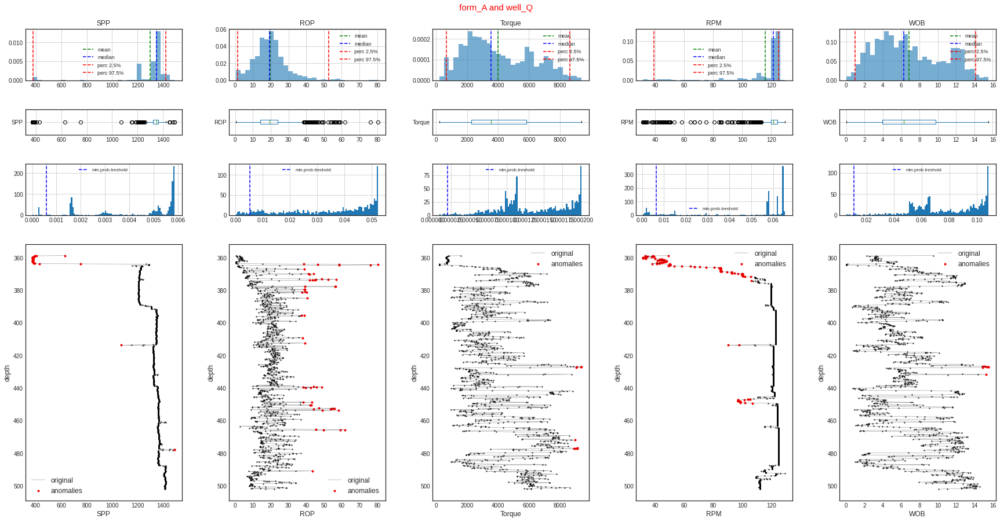

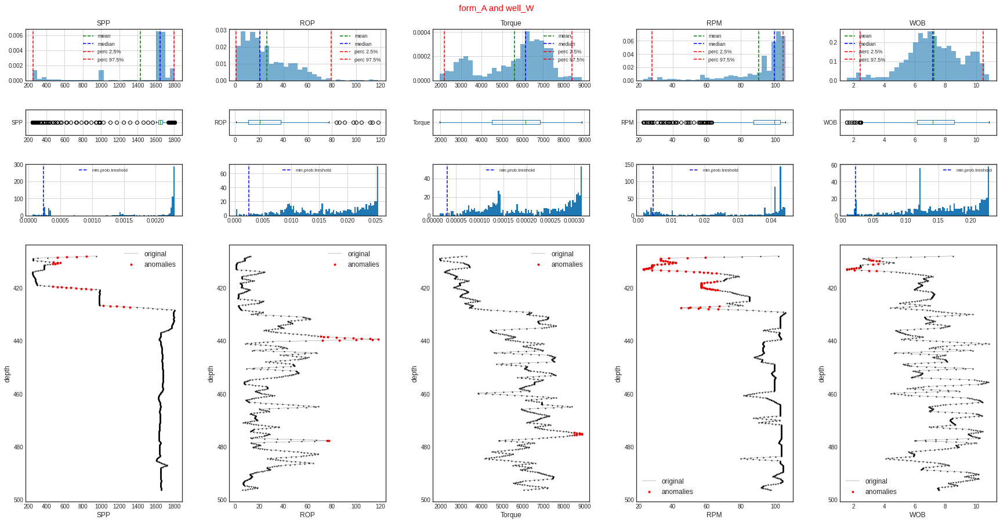

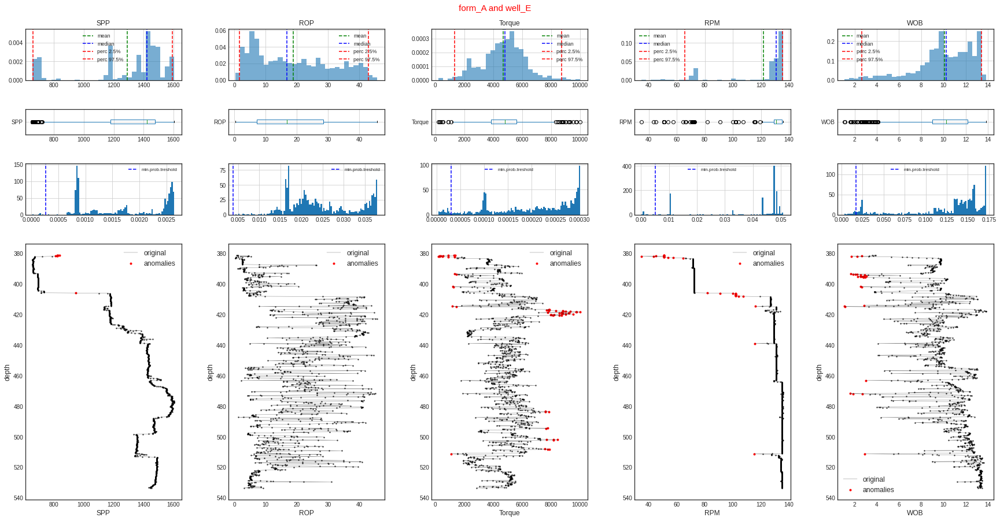

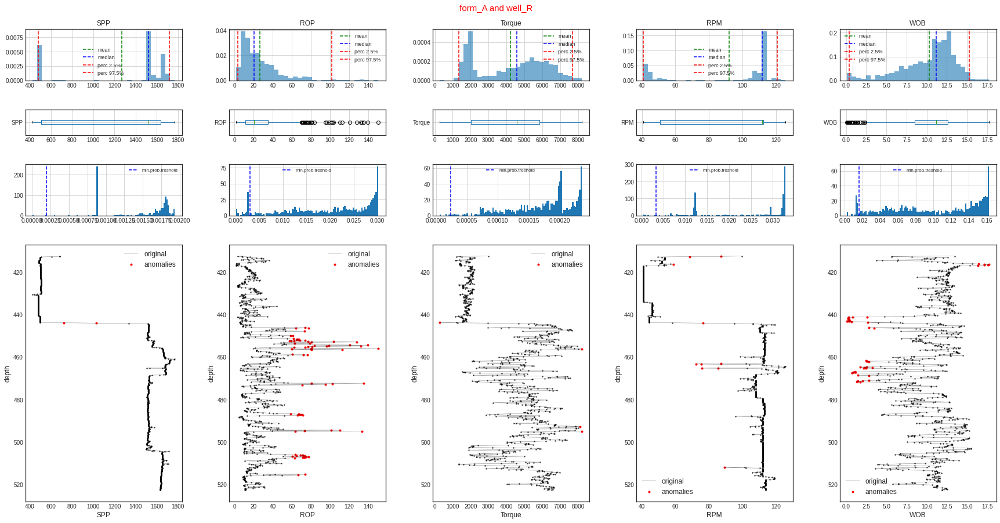

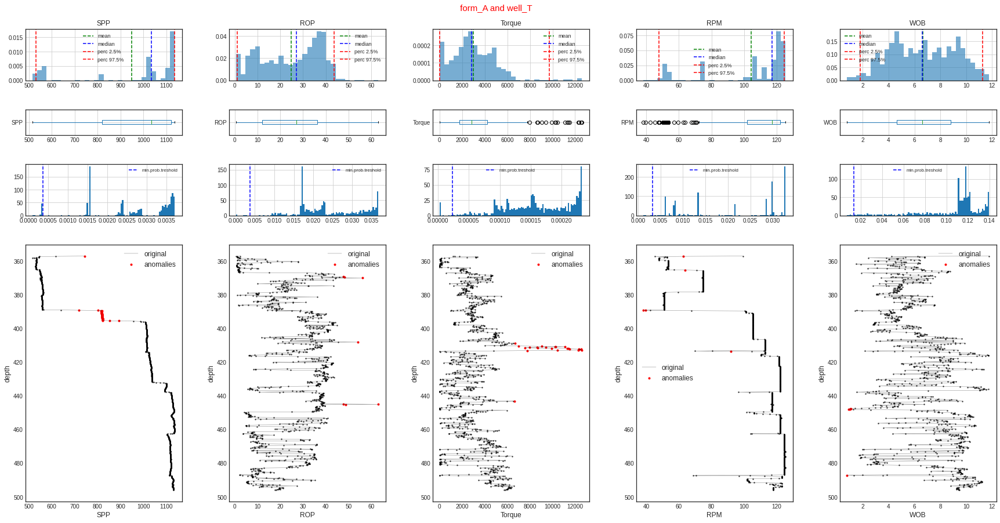

...

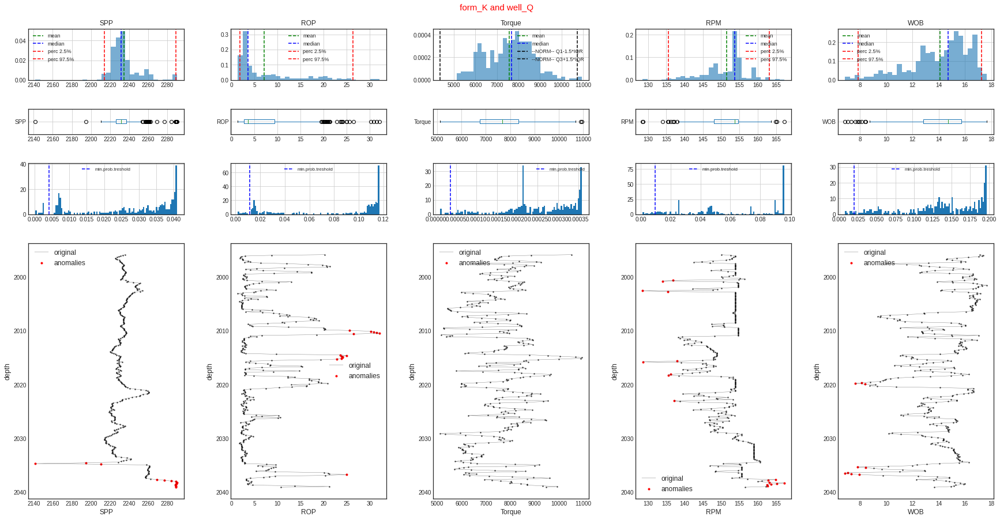

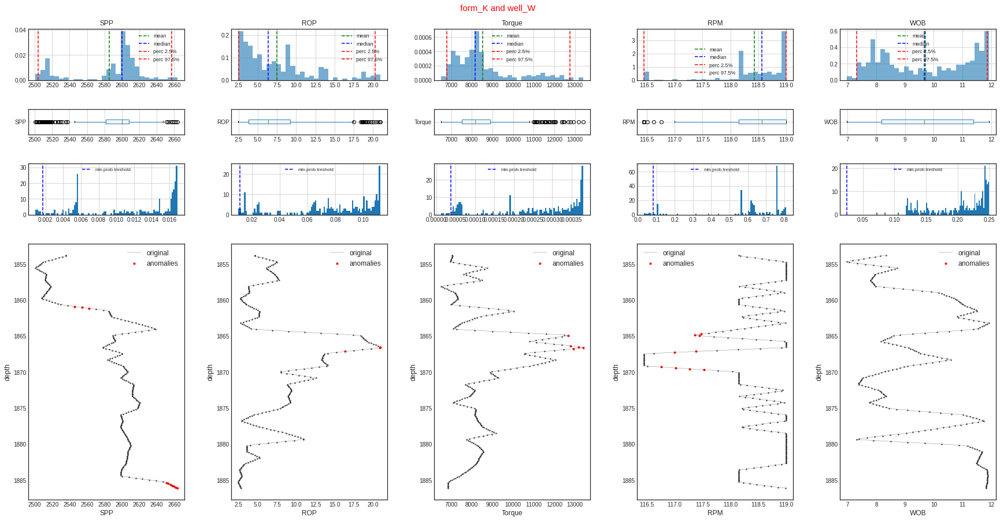

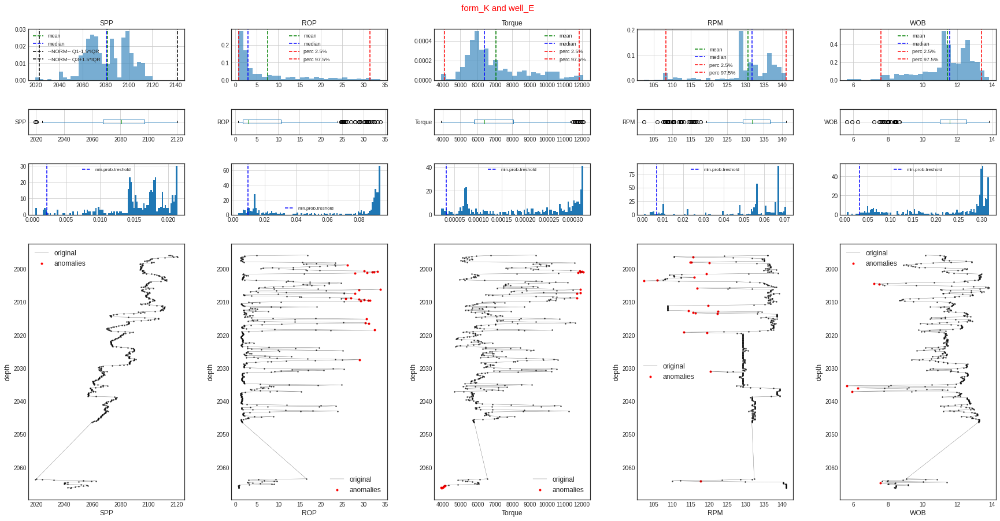

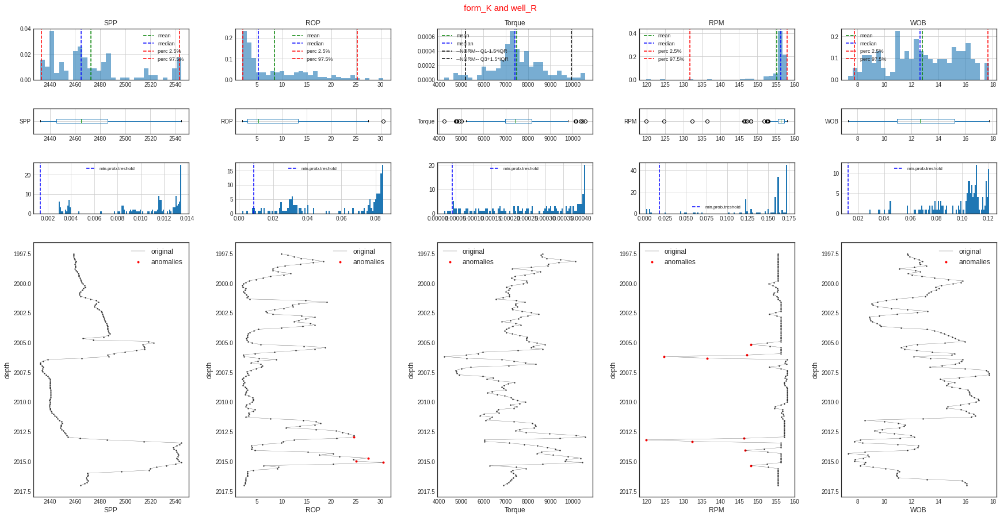

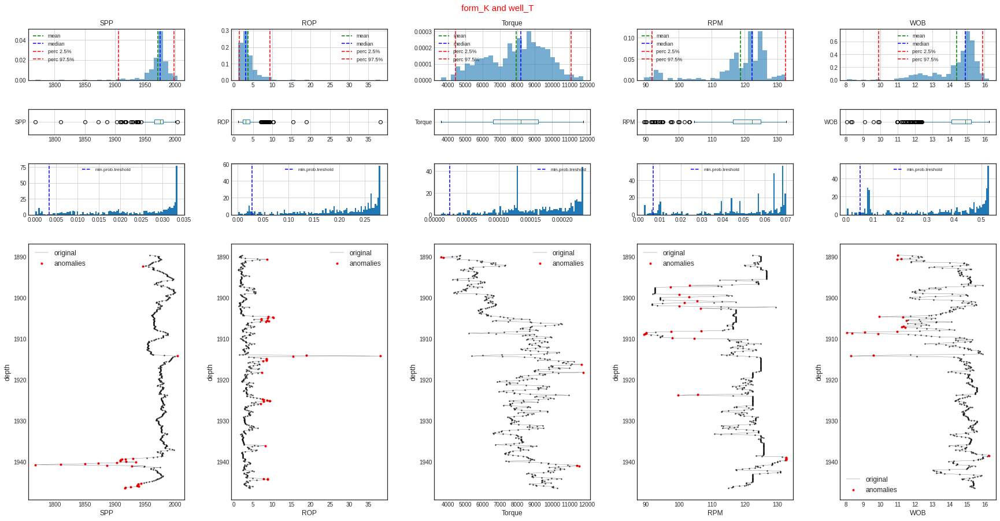

In [59]:
for formation in formation_list:
  TEMP_1 = section_prob.query('Formation == @formation')

  for well in wells:
    TEMP_2 = TEMP_1.query('Well == @well')

    summary_plot(TEMP_2, formation, well)

## results of anomaly detection

In [60]:
# columns for summary for each set of features and based on results for anomaly detection for each parameter
section_prob[['no_clean','clean_5', 'clean_4', 'clean_3']] = 1

In [61]:
# 4 features and target were checked

section_prob.loc[(section_prob['SPP_prb_vld'] == 0) | 
                 (section_prob['ROP_prb_vld'] == 0) | 
                 (section_prob['Torque_prb_vld'] == 0) | 
                 (section_prob['RPM_prb_vld'] == 0) | 
                 (section_prob['WOB_prb_vld'] == 0), 'clean_5'] = 0

In [62]:
len(section_prob.loc[(section_prob['clean_5'] == 0)])

8035

In [63]:
# 3 features and target were checked
section_prob.loc[(section_prob['SPP_prb_vld'] == 0) | 
                 (section_prob['ROP_prb_vld'] == 0) |  
                 (section_prob['RPM_prb_vld'] == 0) | 
                 (section_prob['WOB_prb_vld'] == 0), 'clean_4'] = 0

In [64]:
len(section_prob.loc[(section_prob['clean_4'] == 0)])

6954

In [65]:
# 2 features and target were checked
section_prob.loc[(section_prob['ROP_prb_vld'] == 0) |  
                 (section_prob['RPM_prb_vld'] == 0) | 
                 (section_prob['WOB_prb_vld'] == 0), 'clean_3'] = 0

In [66]:
len(section_prob.loc[(section_prob['clean_3'] == 0)])

6100

In [67]:
# visualization with and without anomalies

def fun_viz_before_after(data, data_cl, drilling_param, wells):
  
  for parameter in drilling_param:

    fig, ax = plt.subplots(1, len(wells), figsize=(20, 4), constrained_layout=True)
  
    for i, well in enumerate(wells):
      section_with_anomalies = data.query('Well == @well')
      section_wo_anomalies = data_cl.query('Well == @well')

      ax[i].plot(section_with_anomalies[parameter],section_with_anomalies['MD'], color='red', alpha=.6, lw=0.4, ls= '-', label = 'origianal data')
      ax[i].scatter(x = section_wo_anomalies[parameter], y = section_wo_anomalies['MD'], marker = '.', color = 'black', label = 'without anomaies')
      
      ax[i].set_xlabel(well, fontsize = '12' )
      ax[i].set_ylabel('depth', fontsize = '12')

      ax[i].legend(prop={'size': 10})

      ax[i].xaxis.set_label_position("top")
      ax[i].xaxis.set_ticks_position("top")
      ax[i].xaxis.label.set_color("black")
    
      ax[i].set_xlim(section_with_anomalies[parameter].min(), section_with_anomalies[parameter].max())

      ax[i].tick_params(axis='x', colors="black") # шкала по Х
      ax[i].spines["top"].set_edgecolor("black") # цвет оси по Х
      ax[i].spines["top"].set_position(("axes", 1.0)) # расстояние между именем и линией 
      ax[i].tick_params(labelsize=8) # размер шрифта шкалы по Х
      ax[i].invert_yaxis()           # переворот
      fig.suptitle(parameter, y = 1.08, fontsize = 15, color = 'r')
      
  return 

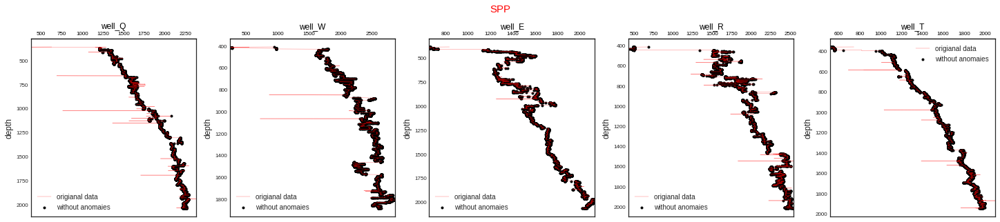

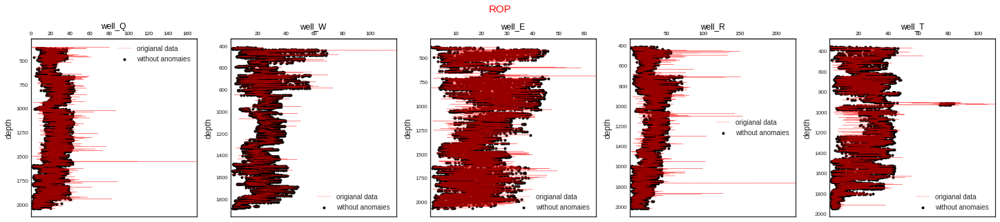

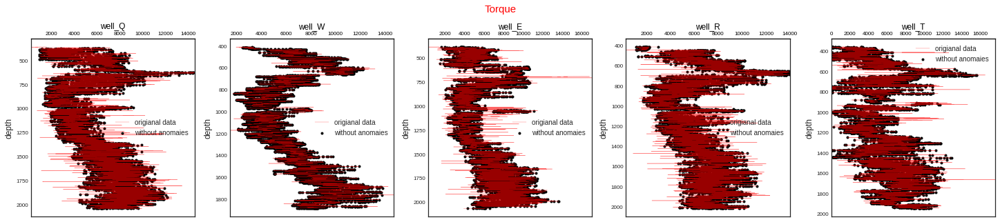

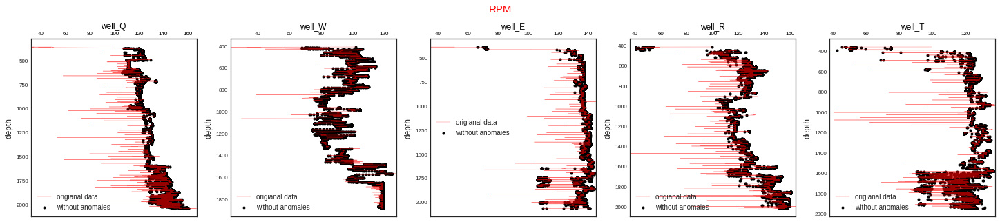

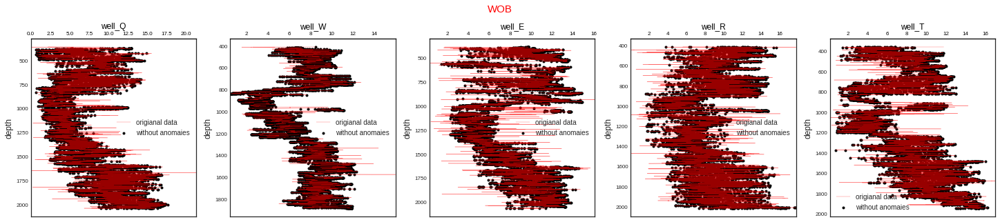

In [68]:
# visualization with and without anomalies

fun_viz_before_after(section_prob, section_prob.query('clean_5 == 1'), drilling_param, wells)

In [71]:
# % of outliers by formation

temp_table = pd.DataFrame(index = formation_list)


for formation in formation_list:
  temp = section_prob.query('Formation ==@formation')
  temp_5 = temp.query('clean_5 == 1')
  temp_3 = temp.query('clean_4 == 1')
  temp_2 = temp.query('clean_3 == 1')
  

  temp_table.loc[formation, 'raw data'] = len(temp)
  temp_table.loc[formation, '5_features (%)'] = round(100- len(temp_5)*100/len(temp), 1)
  temp_table.loc[formation, '4_features (%)'] = round(100- len(temp_3)*100/len(temp), 1)
  temp_table.loc[formation, '3_features (%)'] = round(100- len(temp_2)*100/len(temp), 1)

temp_table.loc['total', 'raw data'] = len(section_prob)
temp_table.loc['total', '5_features (%)'] = len(section_prob.query('clean_5 == 1'))
temp_table.loc['total', '4_features (%)'] = len(section_prob.query('clean_4 == 1'))
temp_table.loc['total', '3_features (%)'] = len(section_prob.query('clean_3 == 1'))

temp_table.loc['anomalies', 'raw data'] = 'n/a'
temp_table.loc['anomalies', '5_features (%)'] = len(section_prob) - len(section_prob.query('clean_5 == 1'))
temp_table.loc['anomalies', '4_features (%)'] = len(section_prob) - len(section_prob.query('clean_4 == 1'))
temp_table.loc['anomalies', '3_features (%)'] = len(section_prob) - len(section_prob.query('clean_3 == 1')) 

In [72]:
temp_table

,raw data,5_features (%),4_features (%),3_features (%)
form_A,4918,12.4,10.8,9.7
form_B,3602,14.0,13.4,11.3
form_C,2718,18.3,16.2,15.3
form_D,7624,8.3,6.8,5.5
form_E,4852,18.1,14.7,13.0
form_F,897,10.3,9.8,8.4
form_G,12341,15.8,12.5,12.3
form_H,8485,10.4,10.0,8.6
form_I,8415,9.6,8.3,6.7
form_J,6857,14.0,12.8,10.0


In [73]:
section = section_prob.copy()

In [75]:
section = section.drop(['SPP_prb',	'ROP_prb',	'Torque_prb',	'RPM_prb',	'WOB_prb',	'SPP_prb_vld',	'ROP_prb_vld',	'Torque_prb_vld',	'RPM_prb_vld',	'WOB_prb_vld'], axis='columns')

In [76]:
section.head(2)

,MD,LM,LM_DLM,DLM,DLM_C,E_GA,E_KMN,EXTR,SHC,SHS,SILT,UNS,SND,GR,DTC,RHOB,SPP,ROP,Torque,RPM,WOB,Formation,Well,MD_form,label,clusters,no_clean,clean_5,clean_4,clean_3
0,358.83,0.49,0.0,0.0,38.77,55.0,0.0,0.0,5.74,0.0,0.0,0.0,0.0,15.46,58.20,2.35,627.62,0.46,1601.82,48.97,9.50,form_A,well_Q,0.00,2,2.0,1,0,0,0
1,358.96,1.00,0.0,0.0,37.50,55.0,0.0,0.0,6.50,0.0,0.0,0.0,0.0,20.07,63.45,2.22,406.22,0.78,870.23,38.25,3.25,form_A,well_Q,0.15,2,2.0,1,0,0,0


# TRAIN and TEST

In [77]:
target_list = ['ROP', 'MD', 'MD_form', 'Well', 'Formation', 'RHOB', 'DTC', 'GR', 'clusters', 'clean_5',	'clean_4',	'clean_3', 'no_clean']

In [78]:
def fun_11(data, target_list):
  X_final = data.copy() 
  y_final = data[target_list] 
  return X_final, y_final

In [79]:
X_final, y_final = fun_11(section, target_list)
X_final.shape, y_final.shape

((62307, 30), (62307, 13))

## train-test split

In [80]:
def fun_train_test(data, targets, formation_list):
  
  #----------------------
  X_train = pd.DataFrame()
  X_test = pd.DataFrame()

  y_train = pd.DataFrame()
  y_test = pd.DataFrame()
  #----------------------
  
  # для каждой формации вырезаем 20% данных
  for well in wells:
    
    # срез по скважине 
    temp_1 = data.query('Well == @well')
    
    for formation in formation_list:
      
      # срез по пласту
      temp_2 = temp_1.query('Formation == @formation')

      for cluster in range(0,4):
        temp_3 = temp_2.query('clusters == @cluster') 

        # разделяем на train и test
        temp_X= temp_3.copy() # не удаляю лишние признаки - так как всё равно работаем со списком признаков
        temp_y = temp_3[targets] # признаки которые пойдут в в выборку с таргетами

        # вырезаем 20%
        temp_X_train, temp_X_test, temp_y_train, temp_y_test = train_test_split(temp_X, temp_y, test_size=0.20, random_state=random_state)
        
        # соединяем вырезанное для TRAIN
        X_train = pd.concat([X_train, temp_X_train])
        y_train = pd.concat([y_train, temp_y_train])
        
        # сортируем TRAIN после разделения выборок
        X_train = X_train.sort_values('MD', ascending=True)
        y_train = y_train.sort_values('MD', ascending=True)

        # соединяем вырезанное для TEST
        X_test = pd.concat([X_test, temp_X_test])
        y_test = pd.concat([y_test, temp_y_test])

        # сортируем TEST после разделения выборок
        X_test = X_test.sort_values('MD', ascending=True)
        y_test = y_test.sort_values('MD', ascending=True)

  return X_train, y_train, X_test, y_test 

In [81]:
# разделеляем выборку на train и test
X_train, y_train, X_test, y_test = fun_train_test(section, target_list, formation_list)

In [82]:
# размеры полученных выборок
X_train.shape, y_train.shape, X_test.shape, y_test.shape

((49766, 30), (49766, 13), (12541, 30), (12541, 13))

In [83]:
# проверка
X_train.shape[0] + X_test.shape[0]


62307

In [84]:
# соберем статистику по каждому пласту/скважине

def statistic_train_test(data):

  statistic = pd.DataFrame(index= formation_list, columns= wells)

  for formation in formation_list:

    temp_1 = data.query('Formation == @formation')

    for well in wells:
      temp_2 = temp_1.query('Well == @well')

      statistic.loc[formation, well] = len(temp_2)
      statistic.loc[formation, 'сумма'] = statistic.loc[formation, 'well_Q':'well_T'].sum()
      statistic.loc['сумма', well] = statistic.loc['form_A':'form_K', well].sum()

  statistic.loc['сумма', 'сумма'] = statistic.loc['form_A':'form_K', 'сумма'].sum()

  return statistic

In [85]:
# check statistics
statistic_train_test(X_test)

,well_Q,well_W,well_E,well_R,well_T,сумма
form_A,223,140,237,175,216,991.0
form_B,140,148,170,162,108,728.0
form_C,112,104,102,103,130,551.0
form_D,291,330,349,292,271,1533.0
form_E,204,165,164,244,200,977.0
form_F,41,34,35,35,42,187.0
form_G,536,454,499,591,396,2476.0
form_H,370,307,382,265,380,1704.0
form_I,333,318,374,326,338,1689.0
form_J,295,282,196,307,300,1380.0


In [86]:
statistic_train_test(X_train)

,well_Q,well_W,well_E,well_R,well_T,сумма
form_A,883,554,941,692,857,3927.0
form_B,551,585,671,644,423,2874.0
form_C,438,409,400,408,512,2167.0
form_D,1154,1310,1390,1158,1079,6091.0
form_E,807,653,655,969,791,3875.0
form_F,155,129,132,135,159,710.0
form_G,2135,1808,1986,2355,1581,9865.0
form_H,1473,1224,1523,1051,1510,6781.0
form_I,1323,1267,1489,1300,1347,6726.0
form_J,1173,1118,777,1218,1191,5477.0


In [89]:
# train - test visualization

def fun_visuzlization_56(data_test, formation_list, wells, x_min, x_max, target, X_final):
  for formation in formation_list:
    temp_11 = X_final.query('Formation == @formation') # все данные
    temp_12 = data_test.query('Formation == @formation') # test

    fig, ax = plt.subplots(1, len(wells), figsize=(20, 6), constrained_layout=True)
      
    for i, well in enumerate(wells):
      temp_21 = temp_11.query('Well == @well') # все данные
      temp_22 = temp_12.query('Well == @well') # test

      # все данные
      ax[i].plot(temp_21[target], temp_21['MD'], linewidth=0.5, color = 'black', label = 'train', alpha = 0.8)      
      # test
      ax[i].scatter(x = temp_22[target], y = temp_22['MD'], marker = '.', color = 'red', s = 50, label = 'test')
      ax[i].grid(b=None) # убираем линии сетки
      ax[i].set_xlim(x_min, x_max)
      ax[i].set_xlabel(well)
      ax[i].set_ylabel('depth')
      ax[i].invert_yaxis()
      ax[i].legend(prop={'size': 10})
      fig.suptitle(f'{target}, formation - {formation}', y = 1.05, fontsize = 20, color = 'r') 

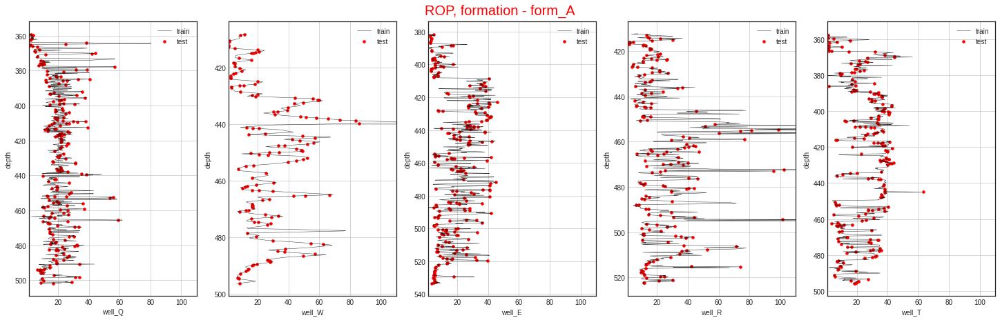

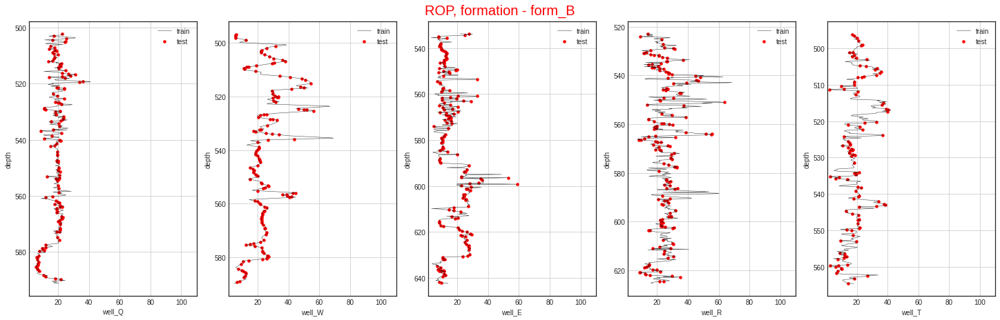

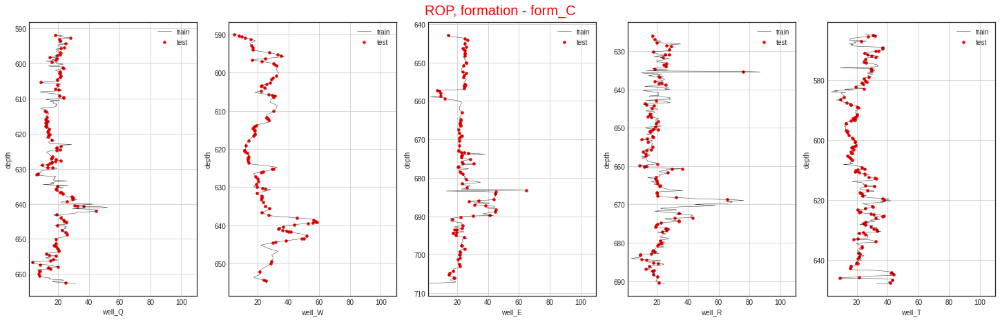

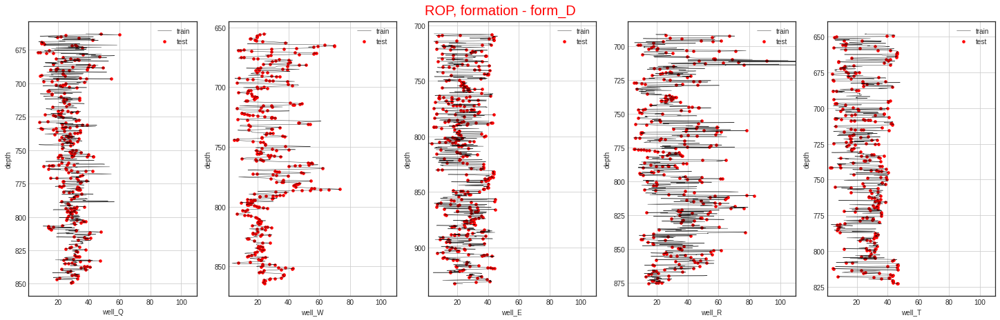

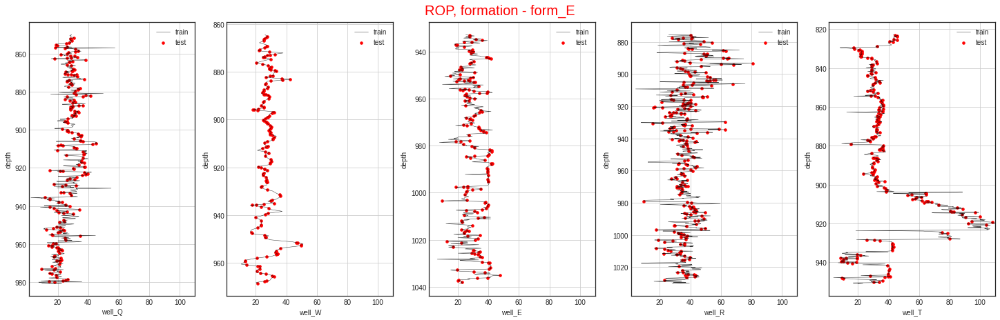

...

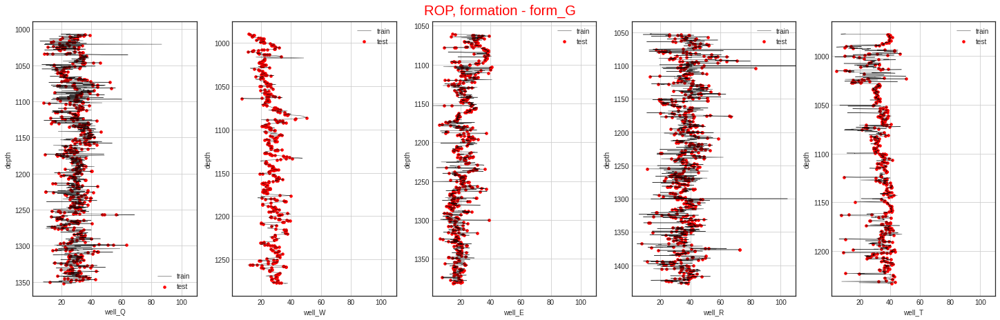

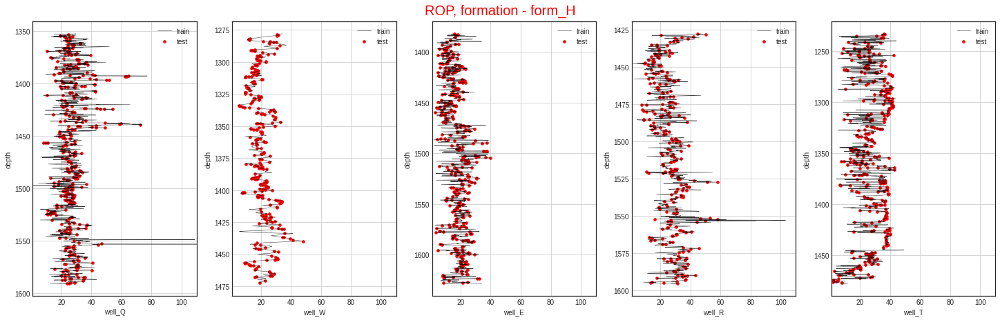

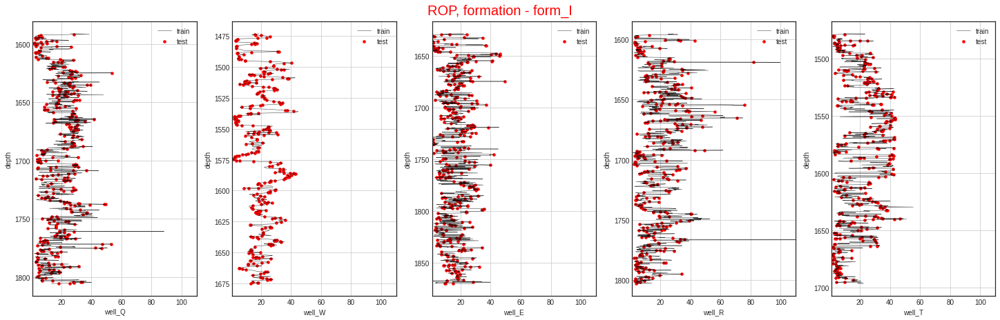

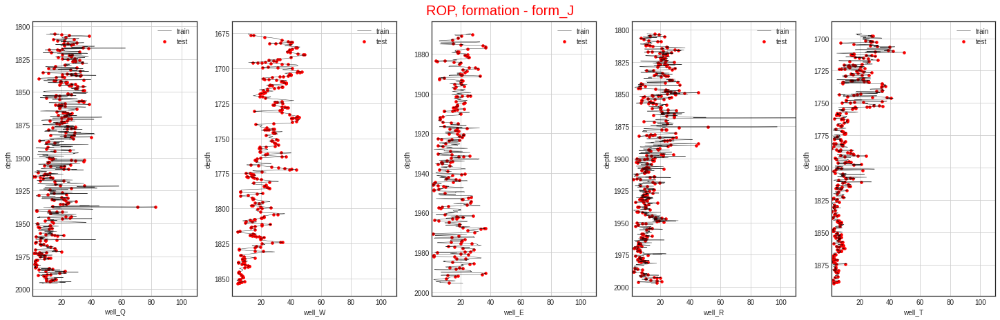

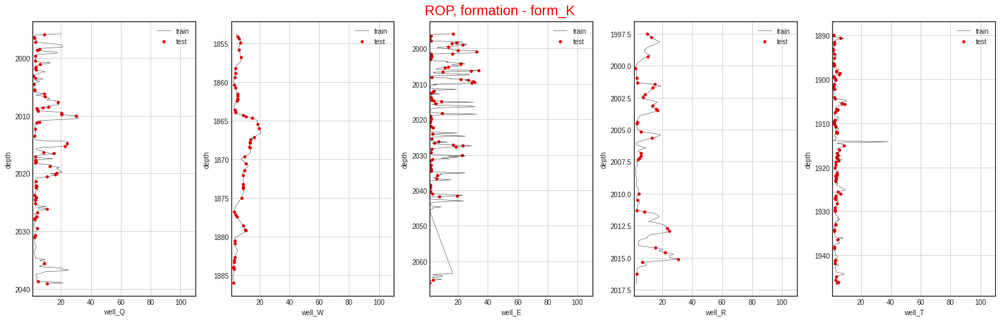

In [90]:
# train - test visualization 
fun_visuzlization_56(X_test, formation_list, wells, 1, 110, 'ROP', X_final)

## **comparison of train and test datasets distribution**

In [91]:
def fun_visuzlization_train_test_dist(data_X_train, data_X_test, drilling_param, text):
  fig, ax = plt.subplots(1, len(drilling_param), figsize=(30, 6), constrained_layout=True)

  for i, parameter in enumerate(drilling_param):
      data_X_train[[parameter]].hist(bins=100, ax=ax[i], density=True, color = 'red', alpha=0.75, 
                      label = f"train ср. - {data_X_train[parameter].mean():.2f}±{data_X_train[parameter].std():.1f} std, MAE - {round((data_X_train[parameter] - data_X_train[parameter].mean()).abs().mean(),1)}")
      data_X_test[[parameter]].hist(bins=100, ax=ax[i], density=True, color = 'green', alpha=0.75, 
                      label = f"test ср. - {data_X_test[parameter].mean():.2f}±{data_X_test[parameter].std():.1f} std, MAE - {round((data_X_test[parameter] - data_X_test[parameter].mean()).abs().mean(),1)}")
      ax[i].set_title(parameter)
      fig.suptitle(text, y = 1.01, fontsize = 20, color = 'r')
      ax[i].set_xlabel('values')
      ax[0].set_ylabel('density probability')
      ax[i].legend(prop={'size': 10})

In [93]:
sns.set_palette('PiYG')
sns.set_style('whitegrid',
              {'axes.facecolor': '1',
               'axes.edgecolor': '0.8',
               'axes.labelcolor': '0.2',
               'text.color': '0.2',
               'xtick.color': '0.2',
               'ytick.color': '0.2',
               'grid.color': '0.7',
               'figure.facecolor': '0.95',
               'figure.figsize': (10, 6),
               'figure.dpi': 300.0,
              }
             )

sns.set_context('notebook', font_scale=1.3)

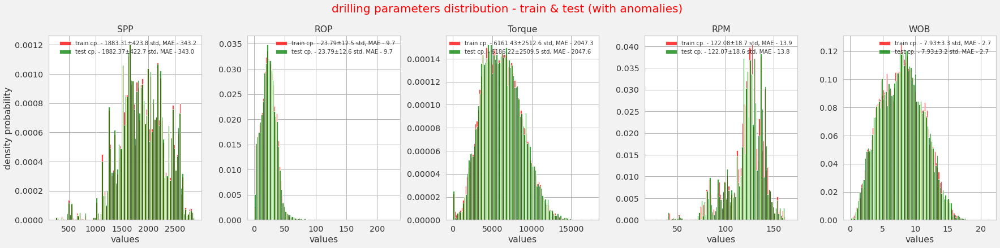

In [98]:
fun_visuzlization_train_test_dist(X_train, X_test, drilling_param, 'drilling parameters distribution - train & test (with anomalies)')

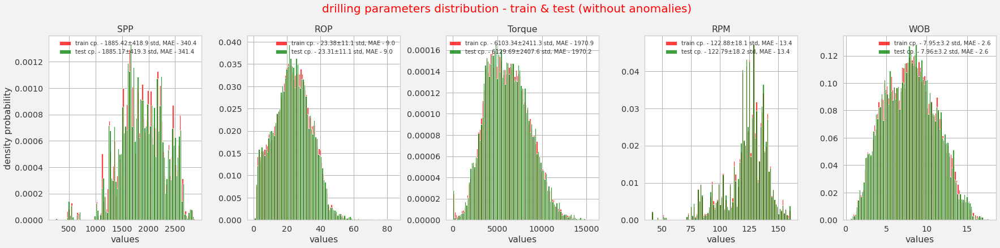

In [99]:
fun_visuzlization_train_test_dist(X_train.query('clean_5 == 1'), X_test.query('clean_5 == 1'), drilling_param, 'drilling parameters distribution - train & test (without anomalies)')

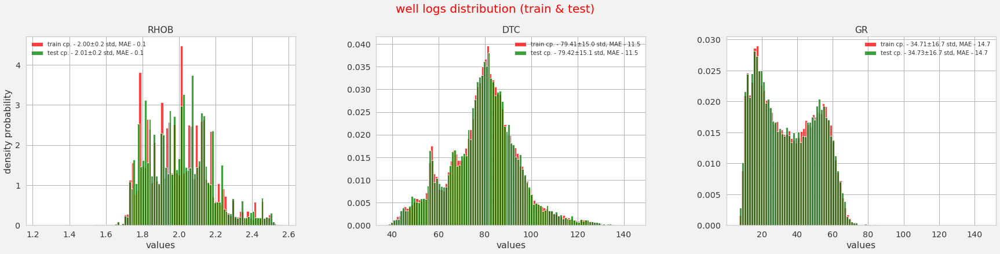

In [97]:
temp = ['RHOB', 'DTC', 'GR']
fun_visuzlization_train_test_dist(y_train, y_test, temp, 'well logs distribution (train & test)')

# ROP prediction

**select the best model to be used for ROP prediction**

In [100]:
def fun_predict_01(data_X_train, data_X_test, 
                   data_y_train, data_y_test, 
                   drilling_param_train, 
                   formation_list, 
                   target, 
                   list_models,
                   best_models_names,  
                   best_models_score):
  
  # -------- fill table with results of ROP prediction for each model  ------------
  y_test_predict_models = pd.DataFrame() # прогноз ROP
  for formation in formation_list:
    temp_X_train = data_X_train.query('Formation == @formation')
    temp_y_train = data_y_train.query('Formation == @formation') 
    temp_X_test =  data_X_test.query( 'Formation == @formation')
    temp_y_test =  data_y_test.query( 'Formation == @formation')

    for model, model_name in zip(models, list_models):
      model.fit(temp_X_train[drilling_param_train], temp_y_train[target])
      
      temp_y_test[model_name] = model.predict(temp_X_test[drilling_param_train])
    
    y_test_predict_models = pd.concat([y_test_predict_models, temp_y_test])

  # -------- fill next table with R2 -----------
  y_test_predict_models_R2 = pd.DataFrame(index = formation_list)
  for formation in formation_list:
    temp = y_test_predict_models.query('Formation == @formation')
    
    for model in list_models:
      y_test_predict_models_R2.loc[formation, model] = (r2_score(temp[target], temp[model]))

  # clean table
  y_test_predict_models.drop(columns = list_models, inplace = True)

  # ----------list of best models --------------------
  summary = pd.DataFrame(index = formation_list, columns = [best_models_names, best_models_score])
  best_model_list = []
  mean_score = []

  for formation in formation_list:
    best_model = y_test_predict_models_R2.loc[formation, :].idxmax(axis = 1)
    mean = y_test_predict_models_R2.loc[formation, best_model]

    summary.loc[formation, best_models_names] = best_model
    summary.loc[formation, best_models_score] = mean

  return summary

In [101]:
# tables for summary

columns_models = ['no_cln_6_feat', 'cln_6_feat', # MD, MD_form, WOB, RPM, Torque, SPP, - anomaly detection in - WOB, RPM, Torque, SPP + ROP
                  'no_cln_5_feat', 'cln_5_feat', # MD, MD_form, WOB, RPM, SPP          - anomaly detection in - WOB, RPM,       , SPP + ROP
                  'no_cln_3_feat', 'cln_3_feat', # WOB, RPM, SPP                       - anomaly detection in - WOB, RPM,       , SPP + ROP
                  'no_cln_2_feat', 'cln_2_feat'] # WOB, RPM                            - anomaly detection in - WOB, RPM,       ,     + ROP

columns_score = ['no_cln_6_feat_scr', 'cln_6_feat_scr', 
                  'no_cln_5_feat_scr', 'cln_5_feat_scr', 
                  'no_cln_3_feat_scr', 'cln_3_feat_scr', 
                  'no_cln_2_feat_scr', 'cln_2_feat_scr']

In [102]:
# lists for summary
drilling_param_train_6 = ['MD', 'MD_form', 'SPP', 'Torque','RPM','WOB']
drilling_param_train_5 = ['MD', 'MD_form', 'SPP', 'RPM', 'WOB']
drilling_param_train_3 = ['SPP', 'RPM', 'WOB']
drilling_param_train_2 = ['RPM', 'WOB']

drilling_param_train_list = [drilling_param_train_6, # MD, MD_form, WOB, RPM, Torque, SPP, - anomaly detection in - WOB, RPM, Torque, SPP + ROP 
                             drilling_param_train_6, 
                             drilling_param_train_5, # MD, MD_form, WOB, RPM, SPP          - anomaly detection in - WOB, RPM,       , SPP + ROP
                             drilling_param_train_5,
                             drilling_param_train_3, # WOB, RPM, SPP                       - anomaly detection in - WOB, RPM,       , SPP + ROP
                             drilling_param_train_3,
                             drilling_param_train_2, # WOB, RPM                            - anomaly detection in - WOB, RPM,       ,     + ROP
                             drilling_param_train_2]

In [103]:
column_list = ['no_clean', 'clean_5',	# anomaly detection in: WOB, RPM, Torque, SPP, ROP
               'no_clean', 'clean_4', # anomaly detection in: WOB, RPM,         SPP, ROP
               'no_clean', 'clean_4',	# anomaly detection in: WOB, RPM,         SPP, ROP
               'no_clean', 'clean_3'] # anomaly detection in: WOB, RPM,              ROP

In [129]:
summary_final = pd.DataFrame(index= formation_list)

for column, best_models_names, best_models_score, drill_param in zip(column_list, columns_models, columns_score, drilling_param_train_list):
    temp_X_train = X_train.loc[X_train.loc[:, column] == 1]
    temp_y_train = y_train.loc[y_train.loc[:, column] == 1]
    temp_X_test = X_test.loc[X_test.loc[:, column]    == 1]
    temp_y_test = y_test.loc[y_test.loc[:, column]    == 1]

    summary = fun_predict_01(temp_X_train, temp_X_test, 
                             temp_y_train, temp_y_test,
                             drill_param, 
                             formation_list, 
                             'ROP', 
                             list_models,
                             best_models_names, best_models_score)
    
    summary_final = pd.merge(summary_final, summary, left_index=True, right_index=True)


In [130]:
# + mean
for score in columns_score:
  summary_final.loc['mean', score] = summary_final.loc[:, score].mean()

In [137]:
summary_final

,no_cln_6_feat,no_cln_6_feat_scr,cln_6_feat,cln_6_feat_scr,no_cln_5_feat,no_cln_5_feat_scr,cln_5_feat,cln_5_feat_scr,no_cln_3_feat,no_cln_3_feat_scr,cln_3_feat,cln_3_feat_scr,no_cln_2_feat,no_cln_2_feat_scr,cln_2_feat,cln_2_feat_scr
form_A,CatBoostRegressor,0.812931,RandomForestRegressor,0.898108,RandomForestRegressor,0.800133,RandomForestRegressor,0.877061,RandomForestRegressor,0.70755,RandomForestRegressor,0.807307,LGBMRegressor,0.517054,LGBMRegressor,0.657593
form_B,CatBoostRegressor,0.894217,CatBoostRegressor,0.901931,RandomForestRegressor,0.887659,RandomForestRegressor,0.893796,RandomForestRegressor,0.736063,RandomForestRegressor,0.762429,CatBoostRegressor,0.445861,KNeighborsRegressor,0.495617
form_C,CatBoostRegressor,0.875648,RandomForestRegressor,0.932501,CatBoostRegressor,0.866019,RandomForestRegressor,0.933046,RandomForestRegressor,0.769016,RandomForestRegressor,0.855305,LGBMRegressor,0.553529,CatBoostRegressor,0.72372
form_D,RandomForestRegressor,0.799361,RandomForestRegressor,0.806133,RandomForestRegressor,0.798285,RandomForestRegressor,0.806057,RandomForestRegressor,0.679107,RandomForestRegressor,0.699384,CatBoostRegressor,0.367787,CatBoostRegressor,0.397364
form_E,RandomForestRegressor,0.910625,RandomForestRegressor,0.900331,RandomForestRegressor,0.910434,RandomForestRegressor,0.878935,RandomForestRegressor,0.837457,RandomForestRegressor,0.771426,CatBoostRegressor,0.567822,CatBoostRegressor,0.554257
form_F,CatBoostRegressor,0.932042,CatBoostRegressor,0.910867,CatBoostRegressor,0.903113,CatBoostRegressor,0.874709,CatBoostRegressor,0.743659,CatBoostRegressor,0.706876,CatBoostRegressor,0.64296,KNeighborsRegressor,0.573261
form_G,RandomForestRegressor,0.813407,RandomForestRegressor,0.876313,RandomForestRegressor,0.816526,RandomForestRegressor,0.870225,RandomForestRegressor,0.680848,RandomForestRegressor,0.751139,CatBoostRegressor,0.424444,LGBMRegressor,0.527808
form_H,RandomForestRegressor,0.872448,RandomForestRegressor,0.889676,RandomForestRegressor,0.877295,RandomForestRegressor,0.878621,RandomForestRegressor,0.73719,RandomForestRegressor,0.736445,LGBMRegressor,0.509031,CatBoostRegressor,0.538282
form_I,CatBoostRegressor,0.771701,CatBoostRegressor,0.874385,RandomForestRegressor,0.784897,RandomForestRegressor,0.842083,RandomForestRegressor,0.582539,RandomForestRegressor,0.696579,CatBoostRegressor,0.377158,CatBoostRegressor,0.487387
form_J,CatBoostRegressor,0.871805,CatBoostRegressor,0.904975,RandomForestRegressor,0.88312,RandomForestRegressor,0.90052,RandomForestRegressor,0.692443,RandomForestRegressor,0.71901,LGBMRegressor,0.413882,LGBMRegressor,0.455973


## best models for each case

In [148]:
summary_final_short_6 = summary_final[['no_cln_6_feat_scr', 'cln_6_feat_scr']].astype('float') 
summary_final_short_5 = summary_final[['no_cln_5_feat_scr', 'cln_5_feat_scr']].astype('float') 
summary_final_short_3 = summary_final[['no_cln_3_feat_scr', 'cln_3_feat_scr']].astype('float') 
summary_final_short_2 = summary_final[['no_cln_2_feat_scr', 'cln_2_feat_scr']].astype('float') 

In [149]:
new_table_summary_6 = pd.DataFrame(index = formation_list)
new_table_summary_5 = pd.DataFrame(index = formation_list)
new_table_summary_3 = pd.DataFrame(index = formation_list)
new_table_summary_2 = pd.DataFrame(index = formation_list)

In [150]:
# 6 features

for formation in formation_list:
  best_model = summary_final_short_6.loc[formation, :].idxmax(axis = 1) # get the column name for the biggest value in row
  
  if best_model == 'cln_6_feat_scr':
    new_table_summary_6.loc[formation, 'model_6_feat'] = summary_final.loc[formation, 'cln_6_feat']
    new_table_summary_6.loc[formation, 'score_6_feat'] = summary_final.loc[formation, 'cln_6_feat_scr']
    new_table_summary_6.loc[formation, 'cln_6_feat'] = 'yes' # means that we received better results from dataset without anomalies - i.e. from clean dataset
  else:
    new_table_summary_6.loc[formation, 'model_6_feat'] = summary_final.loc[formation, 'no_cln_6_feat']
    new_table_summary_6.loc[formation, 'score_6_feat'] = summary_final.loc[formation, 'no_cln_6_feat_scr']
    new_table_summary_6.loc[formation, 'cln_6_feat'] = 'no'

In [151]:
new_table_summary_6

,model_6_feat,score_6_feat,cln_6_feat
form_A,RandomForestRegressor,0.898108,yes
form_B,CatBoostRegressor,0.901931,yes
form_C,RandomForestRegressor,0.932501,yes
form_D,RandomForestRegressor,0.806133,yes
form_E,RandomForestRegressor,0.910625,no
form_F,CatBoostRegressor,0.932042,no
form_G,RandomForestRegressor,0.876313,yes
form_H,RandomForestRegressor,0.889676,yes
form_I,CatBoostRegressor,0.874385,yes
form_J,CatBoostRegressor,0.904975,yes


In [152]:
# 5 features

for formation in formation_list:
  best_model = summary_final_short_5.loc[formation, :].idxmax(axis = 1) # get the column name for the biggest value in row
  
  if best_model == 'cln_5_feat_scr':
    new_table_summary_5.loc[formation, 'model_5_feat'] = summary_final.loc[formation, 'cln_5_feat']
    new_table_summary_5.loc[formation, 'score_5_feat'] = summary_final.loc[formation, 'cln_5_feat_scr']
    new_table_summary_5.loc[formation, 'cln_5_feat'] = 'yes'
  else:
    new_table_summary_5.loc[formation, 'model_5_feat'] = summary_final.loc[formation, 'no_cln_5_feat']
    new_table_summary_5.loc[formation, 'score_5_feat'] = summary_final.loc[formation, 'no_cln_5_feat_scr']
    new_table_summary_5.loc[formation, 'cln_5_feat'] = 'no'

In [153]:
new_table_summary_5

,model_5_feat,score_5_feat,cln_5_feat
form_A,RandomForestRegressor,0.877061,yes
form_B,RandomForestRegressor,0.893796,yes
form_C,RandomForestRegressor,0.933046,yes
form_D,RandomForestRegressor,0.806057,yes
form_E,RandomForestRegressor,0.910434,no
form_F,CatBoostRegressor,0.903113,no
form_G,RandomForestRegressor,0.870225,yes
form_H,RandomForestRegressor,0.878621,yes
form_I,RandomForestRegressor,0.842083,yes
form_J,RandomForestRegressor,0.900520,yes


In [154]:
# 3 features

for formation in formation_list:
  best_model = summary_final_short_3.loc[formation, :].idxmax(axis = 1) # get the column name for the biggest value in row
  
  if best_model == 'cln_3_feat_scr':
    new_table_summary_3.loc[formation, 'model_3_feat'] = summary_final.loc[formation, 'cln_3_feat']
    new_table_summary_3.loc[formation, 'score_3_feat'] = summary_final.loc[formation, 'cln_3_feat_scr']
    new_table_summary_3.loc[formation, 'cln_3_feat'] = 'yes'
  else:
    new_table_summary_3.loc[formation, 'model_3_feat'] = summary_final.loc[formation, 'no_cln_3_feat']
    new_table_summary_3.loc[formation, 'score_3_feat'] = summary_final.loc[formation, 'no_cln_3_feat_scr']
    new_table_summary_3.loc[formation, 'cln_3_feat'] = 'no'

In [155]:
new_table_summary_3

,model_3_feat,score_3_feat,cln_3_feat
form_A,RandomForestRegressor,0.807307,yes
form_B,RandomForestRegressor,0.762429,yes
form_C,RandomForestRegressor,0.855305,yes
form_D,RandomForestRegressor,0.699384,yes
form_E,RandomForestRegressor,0.837457,no
form_F,CatBoostRegressor,0.743659,no
form_G,RandomForestRegressor,0.751139,yes
form_H,RandomForestRegressor,0.737190,no
form_I,RandomForestRegressor,0.696579,yes
form_J,RandomForestRegressor,0.719010,yes


In [156]:
# 2 features

for formation in formation_list:
  best_model = summary_final_short_2.loc[formation, :].idxmax(axis = 1) # get the column name for the biggest value in row
  
  if best_model == 'cln_2_feat_scr':
    new_table_summary_2.loc[formation, 'model_2_feat'] = summary_final.loc[formation, 'cln_2_feat']
    new_table_summary_2.loc[formation, 'score_2_feat'] = summary_final.loc[formation, 'cln_2_feat_scr']
    new_table_summary_2.loc[formation, 'cln_2_feat'] = 'yes'
  else:
    new_table_summary_2.loc[formation, 'model_2_feat'] = summary_final.loc[formation, 'no_cln_2_feat']
    new_table_summary_2.loc[formation, 'score_2_feat'] = summary_final.loc[formation, 'no_cln_2_feat_scr']
    new_table_summary_2.loc[formation, 'cln_2_feat'] = 'no'

In [157]:
new_table_summary_2

,model_2_feat,score_2_feat,cln_2_feat
form_A,LGBMRegressor,0.657593,yes
form_B,KNeighborsRegressor,0.495617,yes
form_C,CatBoostRegressor,0.723720,yes
form_D,CatBoostRegressor,0.397364,yes
form_E,CatBoostRegressor,0.567822,no
form_F,CatBoostRegressor,0.642960,no
form_G,LGBMRegressor,0.527808,yes
form_H,CatBoostRegressor,0.538282,yes
form_I,CatBoostRegressor,0.487387,yes
form_J,LGBMRegressor,0.455973,yes


In [158]:
new_table_summary_final = pd.merge(new_table_summary_6, new_table_summary_5, left_index=True, right_index=True)
new_table_summary_final = pd.merge(new_table_summary_final, new_table_summary_3, left_index=True, right_index=True)
new_table_summary_final = pd.merge(new_table_summary_final, new_table_summary_2, left_index=True, right_index=True)

In [159]:
temp = ['score_6_feat', 'score_5_feat', 'score_3_feat', 'score_2_feat']
for score in temp:
  new_table_summary_final.loc['mean', score] = new_table_summary_final.loc[:, score].mean()

In [160]:
new_table_summary_final

,model_6_feat,score_6_feat,cln_6_feat,model_5_feat,score_5_feat,cln_5_feat,model_3_feat,score_3_feat,cln_3_feat,model_2_feat,score_2_feat,cln_2_feat
form_A,RandomForestRegressor,0.898108,yes,RandomForestRegressor,0.877061,yes,RandomForestRegressor,0.807307,yes,LGBMRegressor,0.657593,yes
form_B,CatBoostRegressor,0.901931,yes,RandomForestRegressor,0.893796,yes,RandomForestRegressor,0.762429,yes,KNeighborsRegressor,0.495617,yes
form_C,RandomForestRegressor,0.932501,yes,RandomForestRegressor,0.933046,yes,RandomForestRegressor,0.855305,yes,CatBoostRegressor,0.723720,yes
form_D,RandomForestRegressor,0.806133,yes,RandomForestRegressor,0.806057,yes,RandomForestRegressor,0.699384,yes,CatBoostRegressor,0.397364,yes
form_E,RandomForestRegressor,0.910625,no,RandomForestRegressor,0.910434,no,RandomForestRegressor,0.837457,no,CatBoostRegressor,0.567822,no
form_F,CatBoostRegressor,0.932042,no,CatBoostRegressor,0.903113,no,CatBoostRegressor,0.743659,no,CatBoostRegressor,0.642960,no
form_G,RandomForestRegressor,0.876313,yes,RandomForestRegressor,0.870225,yes,RandomForestRegressor,0.751139,yes,LGBMRegressor,0.527808,yes
form_H,RandomForestRegressor,0.889676,yes,RandomForestRegressor,0.878621,yes,RandomForestRegressor,0.737190,no,CatBoostRegressor,0.538282,yes
form_I,CatBoostRegressor,0.874385,yes,RandomForestRegressor,0.842083,yes,RandomForestRegressor,0.696579,yes,CatBoostRegressor,0.487387,yes
form_J,CatBoostRegressor,0.904975,yes,RandomForestRegressor,0.900520,yes,RandomForestRegressor,0.719010,yes,LGBMRegressor,0.455973,yes


In [161]:
# save resuts to lists

model_6_feat = new_table_summary_final['model_6_feat'].tolist()[:-1]
cln_6_feat = new_table_summary_final['cln_6_feat'].tolist()[:-1]

model_5_feat = new_table_summary_final['model_5_feat'].tolist()[:-1]
cln_5_feat = new_table_summary_final['cln_5_feat'].tolist()[:-1]        # anomaly detection in - WOB, RPM,       , SPP + ROP

model_3_feat = new_table_summary_final['model_3_feat'].tolist()[:-1]
cln_3_feat = new_table_summary_final['cln_3_feat'].tolist()[:-1]        # anomaly detection in - WOB, RPM,       , SPP + ROP

model_2_feat = new_table_summary_final['model_2_feat'].tolist()[:-1]
cln_2_feat = new_table_summary_final['cln_2_feat'].tolist()[:-1]

In [162]:
model_6_feat

['RandomForestRegressor',
 'CatBoostRegressor',
 'RandomForestRegressor',
 'RandomForestRegressor',
 'RandomForestRegressor',
 'CatBoostRegressor',
 'RandomForestRegressor',
 'RandomForestRegressor',
 'CatBoostRegressor',
 'CatBoostRegressor',
 'CatBoostRegressor']

In [163]:
cln_6_feat

['yes', 'yes', 'yes', 'yes', 'no', 'no', 'yes', 'yes', 'yes', 'yes', 'no']

In [252]:
# make dictionary - name of model + model

def fun_models_dict(list_models, models):

  names_models_dict = {}
  for i in range(len(list_models)):
      names_models_dict[list_models[i]] = models[i]

  return names_models_dict

In [253]:
# make dictionary - name of model + model
names_models_dict = fun_models_dict(list_models, models)
names_models_dict

{'CatBoostRegressor': <catboost.core.CatBoostRegressor at 0x7ff34d52e1d0>,
 'DecisionTreeRegressor': DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best'),
 'GradientBoostingRegressor': GradientBoostingRegressor(alpha=0.9, ccp_alpha=0.0, criterion='friedman_mse',
                           init=None, learning_rate=0.1, loss='ls', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
              

In [254]:
# make the list with best models
def fun_models_best(best_model_list, names_models_dict):
  best_models_models = []
  for model in best_model_list:
    best_models_models.append(names_models_dict[model])
  return best_models_models

In [172]:
# list of best models 
best_models_models_6 = fun_models_best(model_6_feat, names_models_dict)
best_models_models_5 = fun_models_best(model_5_feat, names_models_dict)
best_models_models_3 = fun_models_best(model_3_feat, names_models_dict)
best_models_models_2 = fun_models_best(model_2_feat, names_models_dict)

In [173]:
best_models_models_6

[RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                       max_depth=None, max_features='auto', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=None, oob_score=False,
                       random_state=None, verbose=0, warm_start=False),
 RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                       max_depth=None, max_features='auto', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=None, oob_score=False,
                       random_state=None, verbose=0, warm_star

In [166]:
# add more features to the model name (otherwise they overwrite themselves) 

def fun_remane_models(best_model_list, formation_list):
  
  best_model_list_long = best_model_list.copy()
  
  for i in range(len(best_model_list)):
    best_model_list_long[i] = best_model_list[i] + '_' + formation_list[i] + '.joblib'
  
  return best_model_list_long

In [167]:
# make lists of best models in order to train them on entire dataset and save for further use
model_6_feat_long = fun_remane_models(model_6_feat, formation_list)
model_5_feat_long = fun_remane_models(model_5_feat, formation_list)
model_3_feat_long = fun_remane_models(model_3_feat, formation_list)
model_2_feat_long = fun_remane_models(model_2_feat, formation_list)

In [168]:
model_2_feat_long

['LGBMRegressor_form_A.joblib',
 'KNeighborsRegressor_form_B.joblib',
 'CatBoostRegressor_form_C.joblib',
 'CatBoostRegressor_form_D.joblib',
 'CatBoostRegressor_form_E.joblib',
 'CatBoostRegressor_form_F.joblib',
 'LGBMRegressor_form_G.joblib',
 'CatBoostRegressor_form_H.joblib',
 'CatBoostRegressor_form_I.joblib',
 'LGBMRegressor_form_J.joblib',
 'CatBoostRegressor_form_K.joblib']

## -- SAVE / READ --

In [203]:
# save lits with best models names - we will need it later in order to upload models trained on entire dataset
# np.savetxt("/content/drive/My Drive/ROP/!_ROP_final_code/section_16_results/model_6_feat_long.csv", model_6_feat_long, delimiter=",", fmt='%s')
# np.savetxt("/content/drive/My Drive/ROP/!_ROP_final_code/section_16_results/model_5_feat_long.csv", model_5_feat_long, delimiter=",", fmt='%s')
# np.savetxt("/content/drive/My Drive/ROP/!_ROP_final_code/section_16_results/model_3_feat_long.csv", model_3_feat_long, delimiter=",", fmt='%s')
# np.savetxt("/content/drive/My Drive/ROP/!_ROP_final_code/section_16_results/model_2_feat_long.csv", model_2_feat_long, delimiter=",", fmt='%s')

## prediction

In [175]:
# function for ROP prediction

def fun_predict_prob(X_train, y_train, X_test, y_test,
                     formation_list,
             best_models_models,
             cleaning_results,
             column_clean,
             drilling_param, 
             target_predict,
             target):
  
  predict_results = pd.DataFrame()

  for formation, model, cleaning in zip(formation_list, best_models_models, cleaning_results):
    
    temp_X_train = X_train.query('Formation == @formation')
    temp_y_train = y_train.query('Formation == @formation') 
    temp_X_test =  X_test.query( 'Formation == @formation')
    temp_y_test =  y_test.query( 'Formation == @formation') 
    
    
    if cleaning == 'yes':
      temp_X_train = temp_X_train.loc[X_train.loc[:, column_clean] == 1]
      temp_y_train = temp_y_train.loc[y_train.loc[:, column_clean] == 1]
      temp_X_test  = temp_X_test.loc[X_test.loc[:,   column_clean] == 1]
      temp_y_test  = temp_y_test.loc[y_test.loc[:,   column_clean] == 1]
    
    else:
      temp_X_train = temp_X_train.loc[X_train.loc[:, 'no_clean'] == 1]
      temp_y_train = temp_y_train.loc[y_train.loc[:, 'no_clean'] == 1]
      temp_X_test = temp_X_test.loc[X_test.loc[:, 'no_clean']    == 1]
      temp_y_test = temp_y_test.loc[y_test.loc[:, 'no_clean']    == 1]      
    
    model.fit(temp_X_train[drilling_param], temp_y_train[target])
    temp_y_test[target_predict] = model.predict(temp_X_test[drilling_param])
    
    predict_results = pd.concat([predict_results, temp_y_test])
  
  return predict_results

In [176]:
# ROP prediction on 6 features
section_prob_6 = fun_predict_prob(X_train, y_train, X_test, y_test,
                                  formation_list,
                                  best_models_models_6, # predict на MD, MD_form, WOB, RPM, Torque, SPP
                                  cln_6_feat, 
                                  'clean_5',            # чистили -  WOB, RPM, Torque, SPP + ROP 
                                  drilling_param_train_6, 
                                  'predict_6_feat',
                                  'ROP')

In [177]:
section_prob_6

,ROP,MD,MD_form,Well,Formation,RHOB,DTC,GR,clusters,clean_5,clean_4,clean_3,no_clean,predict_6_feat
3847,0.55,357.27,0.31,well_T,form_A,1.38,47.43,15.40,0.0,1,1,1,1,15.907100
3850,1.22,357.66,0.77,well_T,form_A,1.39,48.84,15.81,0.0,1,1,1,1,1.606000
3862,1.28,359.22,2.60,well_T,form_A,2.41,48.45,11.53,0.0,1,1,1,1,4.207600
3865,4.80,359.60,3.05,well_T,form_A,2.32,58.13,12.35,0.0,1,1,1,1,7.050000
3874,15.61,360.77,4.42,well_T,form_A,2.22,61.40,17.29,0.0,1,1,1,1,13.802200
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61652,19.50,2041.55,53.76,well_E,form_K,1.95,66.79,28.10,3.0,1,1,1,1,16.771318
61653,7.49,2041.68,53.92,well_E,form_K,2.10,60.10,21.38,0.0,1,1,1,1,3.933680
61704,3.16,2065.24,81.63,well_E,form_K,2.24,83.85,55.58,1.0,1,1,1,1,1.931575
61707,0.73,2065.63,82.09,well_E,form_K,2.55,52.54,51.93,0.0,0,1,1,1,0.602095


In [178]:
# ROP prediction on 5 features
section_prob_5 = fun_predict_prob(X_train, y_train, X_test, y_test,
                                  formation_list,
                                  best_models_models_5, # predict на MD, MD_form, WOB, RPM, SPP
                                  cln_5_feat, 
                                  'clean_4',            # чистили -  WOB, RPM, SPP + ROP 
                                  drilling_param_train_5, 
                                  'predict_5_feat',
                                  'ROP')

In [179]:
section_prob_5

,ROP,MD,MD_form,Well,Formation,RHOB,DTC,GR,clusters,clean_5,clean_4,clean_3,no_clean,predict_5_feat
3847,0.55,357.27,0.31,well_T,form_A,1.38,47.43,15.40,0.0,1,1,1,1,13.670300
3850,1.22,357.66,0.77,well_T,form_A,1.39,48.84,15.81,0.0,1,1,1,1,1.668600
3862,1.28,359.22,2.60,well_T,form_A,2.41,48.45,11.53,0.0,1,1,1,1,4.041800
3865,4.80,359.60,3.05,well_T,form_A,2.32,58.13,12.35,0.0,1,1,1,1,5.573300
3874,15.61,360.77,4.42,well_T,form_A,2.22,61.40,17.29,0.0,1,1,1,1,14.499300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61652,19.50,2041.55,53.76,well_E,form_K,1.95,66.79,28.10,3.0,1,1,1,1,18.567160
61653,7.49,2041.68,53.92,well_E,form_K,2.10,60.10,21.38,0.0,1,1,1,1,6.492479
61704,3.16,2065.24,81.63,well_E,form_K,2.24,83.85,55.58,1.0,1,1,1,1,1.621292
61707,0.73,2065.63,82.09,well_E,form_K,2.55,52.54,51.93,0.0,0,1,1,1,0.872350


In [180]:
# ROP prediction on 3 features
section_prob_3 = fun_predict_prob(X_train, y_train, X_test, y_test,
                                  formation_list,
                                  best_models_models_3, # predict на WOB, RPM, SPP
                                  cln_5_feat, 
                                  'clean_4',            # чистили -  WOB, RPM, SPP + ROP 
                                  drilling_param_train_3, 
                                  'predict_3_feat',
                                  'ROP')

In [181]:
section_prob_3

,ROP,MD,MD_form,Well,Formation,RHOB,DTC,GR,clusters,clean_5,clean_4,clean_3,no_clean,predict_3_feat
3847,0.55,357.27,0.31,well_T,form_A,1.38,47.43,15.40,0.0,1,1,1,1,14.409300
3850,1.22,357.66,0.77,well_T,form_A,1.39,48.84,15.81,0.0,1,1,1,1,2.335900
3862,1.28,359.22,2.60,well_T,form_A,2.41,48.45,11.53,0.0,1,1,1,1,4.179900
3865,4.80,359.60,3.05,well_T,form_A,2.32,58.13,12.35,0.0,1,1,1,1,4.266500
3874,15.61,360.77,4.42,well_T,form_A,2.22,61.40,17.29,0.0,1,1,1,1,15.684600
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61652,19.50,2041.55,53.76,well_E,form_K,1.95,66.79,28.10,3.0,1,1,1,1,15.482466
61653,7.49,2041.68,53.92,well_E,form_K,2.10,60.10,21.38,0.0,1,1,1,1,5.250333
61704,3.16,2065.24,81.63,well_E,form_K,2.24,83.85,55.58,1.0,1,1,1,1,1.350576
61707,0.73,2065.63,82.09,well_E,form_K,2.55,52.54,51.93,0.0,0,1,1,1,1.812184


In [182]:
# ROP prediction on 2 features
section_prob_2 = fun_predict_prob(X_train, y_train, X_test, y_test,
                                  formation_list,
                                  best_models_models_2, # predict на WOB, RPM
                                  cln_5_feat, 
                                  'clean_3',            # чистили -  WOB, RPM,  + ROP 
                                  drilling_param_train_2, 
                                  'predict_2_feat',
                                  'ROP')

In [183]:
section_prob_2

,ROP,MD,MD_form,Well,Formation,RHOB,DTC,GR,clusters,clean_5,clean_4,clean_3,no_clean,predict_2_feat
3847,0.55,357.27,0.31,well_T,form_A,1.38,47.43,15.40,0.0,1,1,1,1,17.666035
3850,1.22,357.66,0.77,well_T,form_A,1.39,48.84,15.81,0.0,1,1,1,1,5.897184
3862,1.28,359.22,2.60,well_T,form_A,2.41,48.45,11.53,0.0,1,1,1,1,12.264980
3865,4.80,359.60,3.05,well_T,form_A,2.32,58.13,12.35,0.0,1,1,1,1,7.253732
3874,15.61,360.77,4.42,well_T,form_A,2.22,61.40,17.29,0.0,1,1,1,1,10.305417
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61652,19.50,2041.55,53.76,well_E,form_K,1.95,66.79,28.10,3.0,1,1,1,1,8.730146
61653,7.49,2041.68,53.92,well_E,form_K,2.10,60.10,21.38,0.0,1,1,1,1,4.968829
61704,3.16,2065.24,81.63,well_E,form_K,2.24,83.85,55.58,1.0,1,1,1,1,3.358550
61707,0.73,2065.63,82.09,well_E,form_K,2.55,52.54,51.93,0.0,0,1,1,1,2.706217


## **visualization**

In [189]:
# function for visualizing test vs predict
def fun_vizual_789(data_origin, data_predict, formation_list, wells, x_min, x_max, target, predict, number_features):
  for formation in formation_list:
    temp_1 = data_origin.query('Formation == @formation')
    temp_2 = data_predict.query('Formation == @formation')
    
    fig, ax = plt.subplots(1, len(wells), figsize=(20, 6), constrained_layout=True)
      
    for i, well in enumerate(wells):
      temp_11 = temp_1.query('Well == @well')
      temp_22 = temp_2.query('Well == @well')
      
      ax[i].plot(temp_11[target], temp_11['MD'], linewidth=0.5, color = 'black', label = "test data")
      ax[i].plot(temp_22[predict], temp_22['MD'], linewidth=0.5, color = 'red', label = number_features)
        
      ax[i].set_xlim(x_min, x_max)
      ax[i].set_xlabel(well)
      ax[i].set_ylabel('depth')
      ax[i].invert_yaxis()
      ax[i].legend(prop={'size': 10})
      fig.suptitle(f'formation - {formation}', y = 1.05, fontsize = 20, color = 'r')   

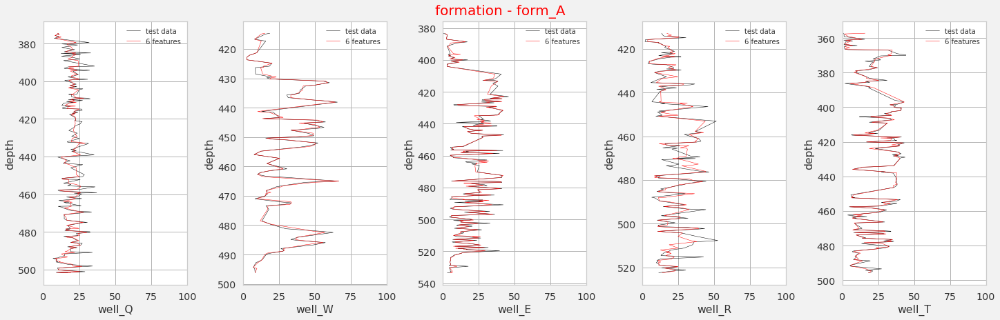

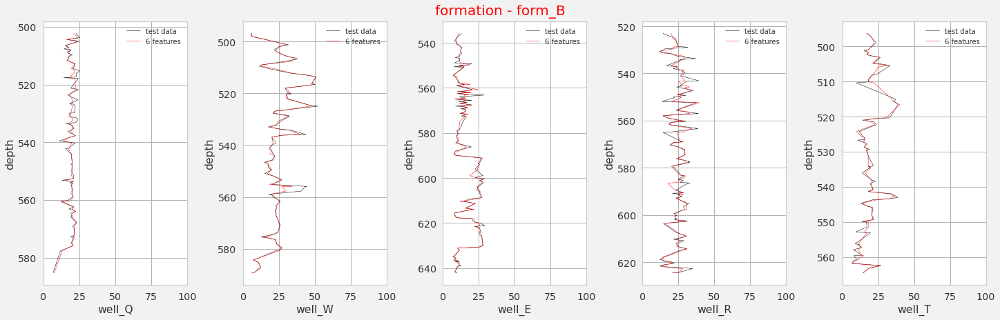

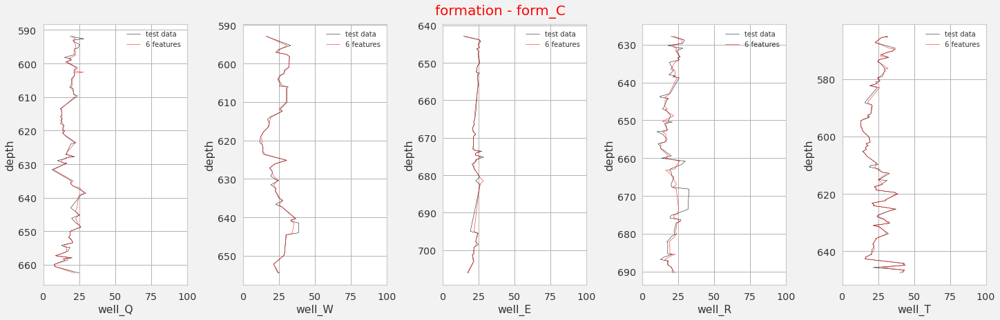

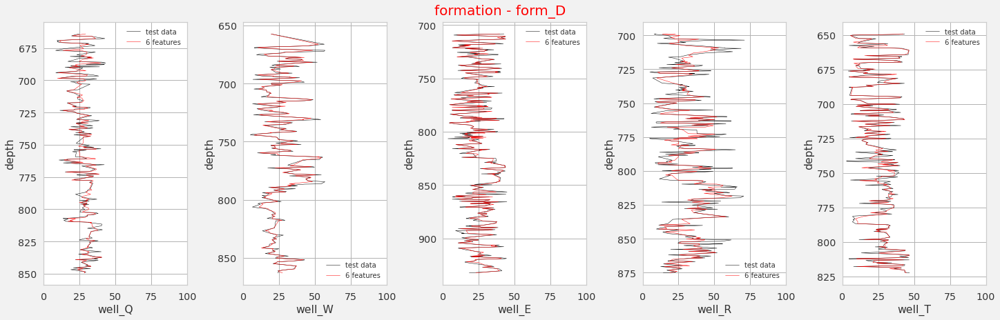

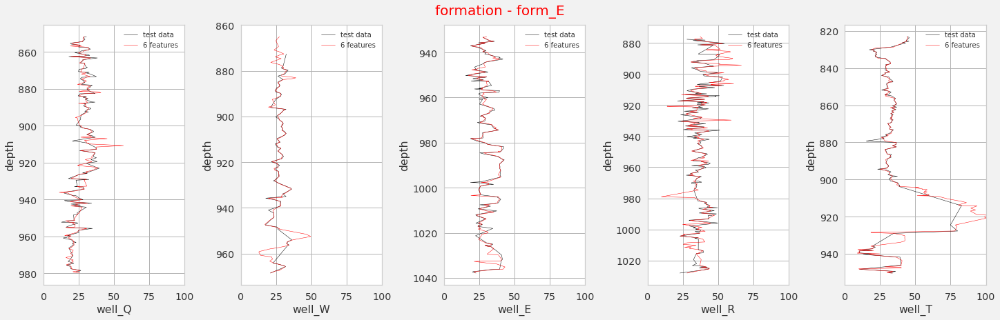

...

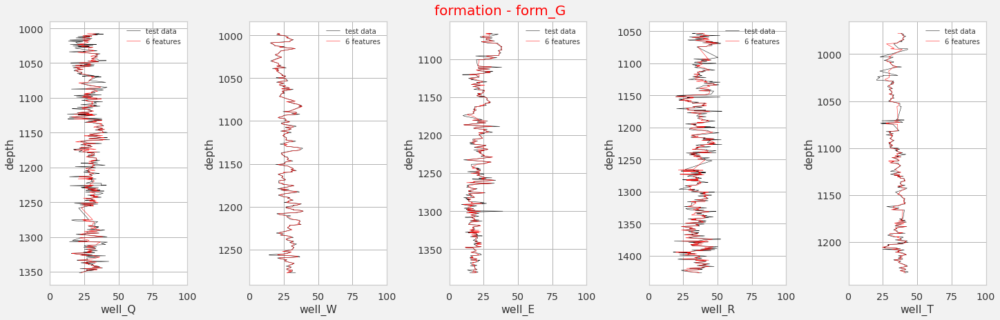

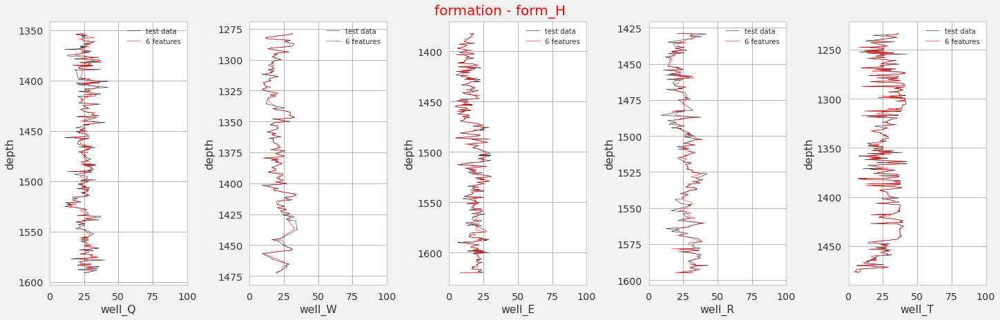

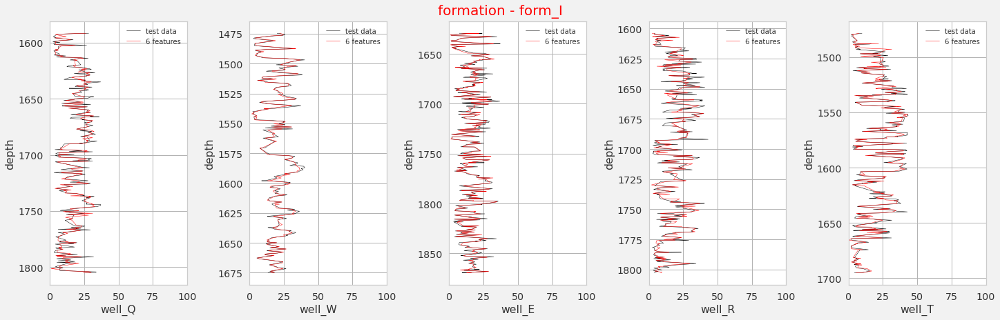

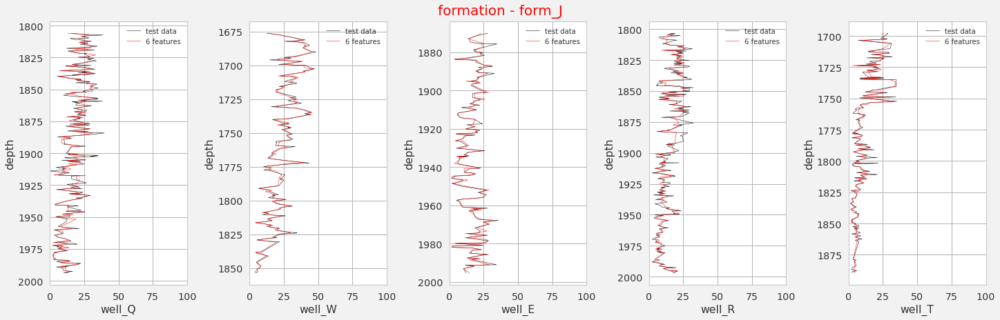

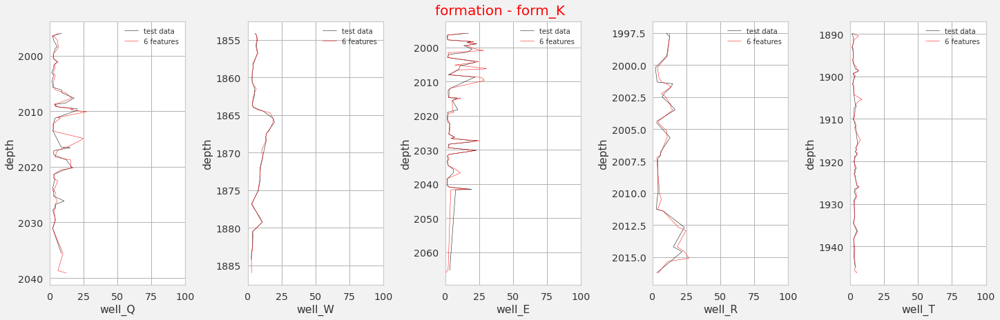

In [190]:
# визуализация результатов сравнения прогноза и факта данных с разбивкой по скважинам

fun_vizual_789(X_test.query('clean_5 == 1'), section_prob_6, formation_list, wells, 0, 100,'ROP', 'predict_6_feat', '6 features')   

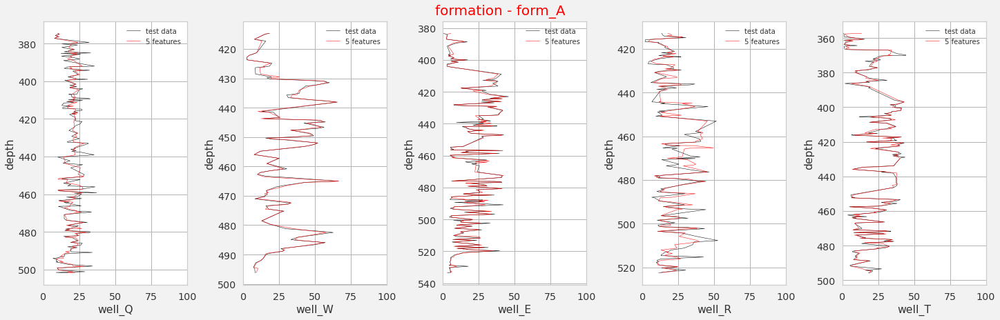

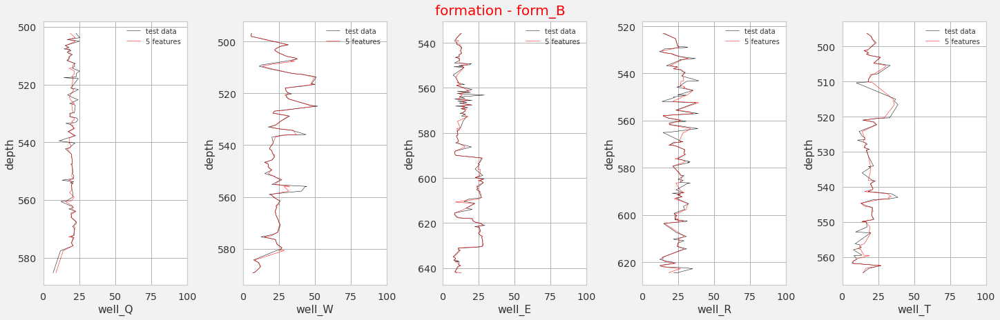

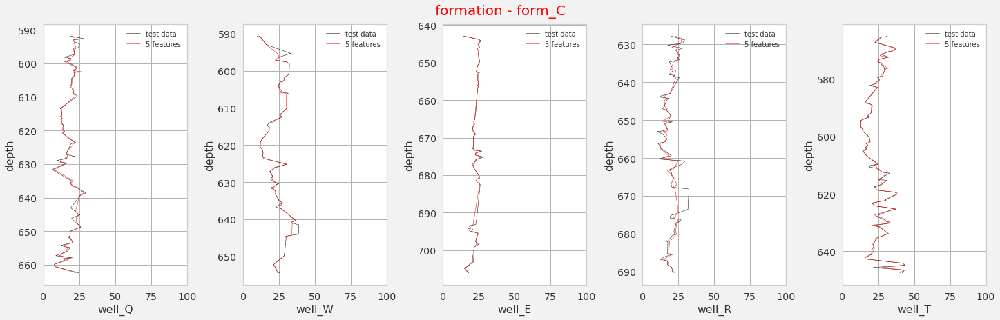

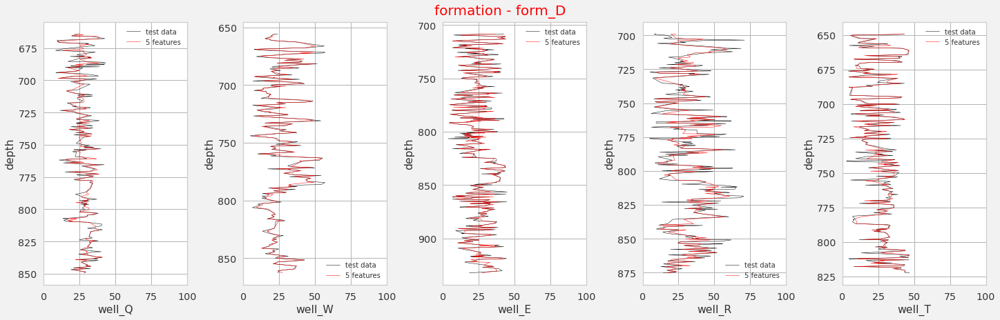

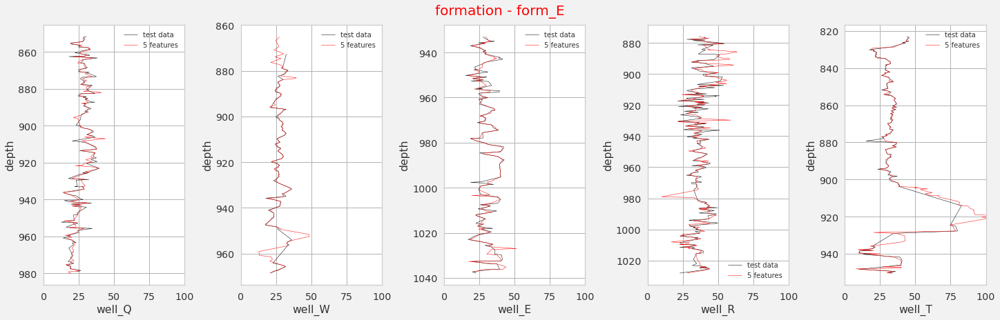

...

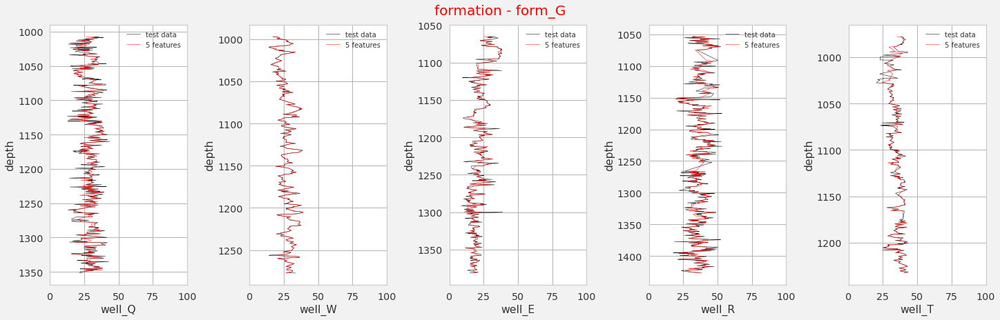

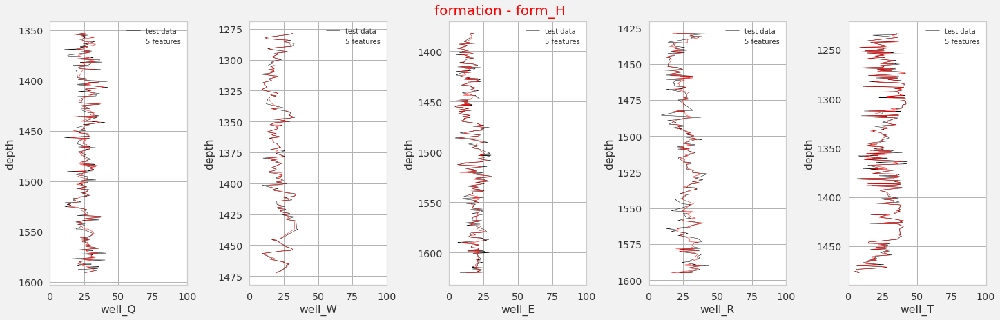

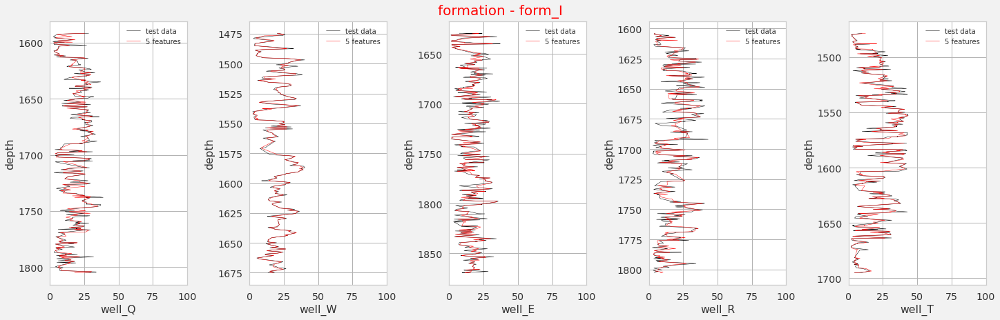

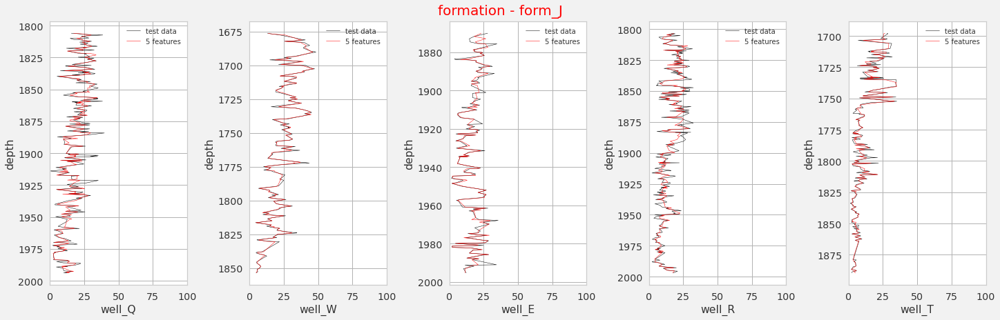

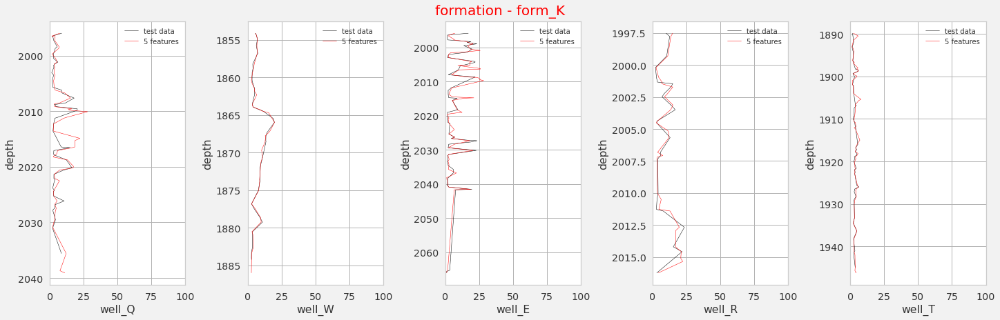

In [191]:
fun_vizual_789(X_test.query('clean_4 == 1'), section_prob_5, formation_list, wells, 0, 100,'ROP', 'predict_5_feat', '5 features')   

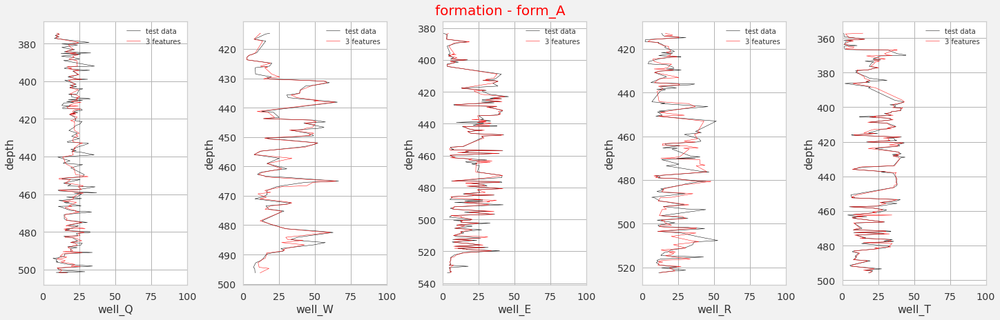

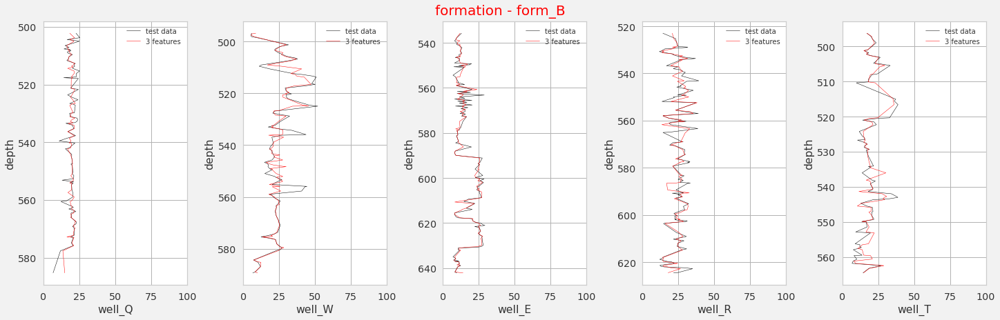

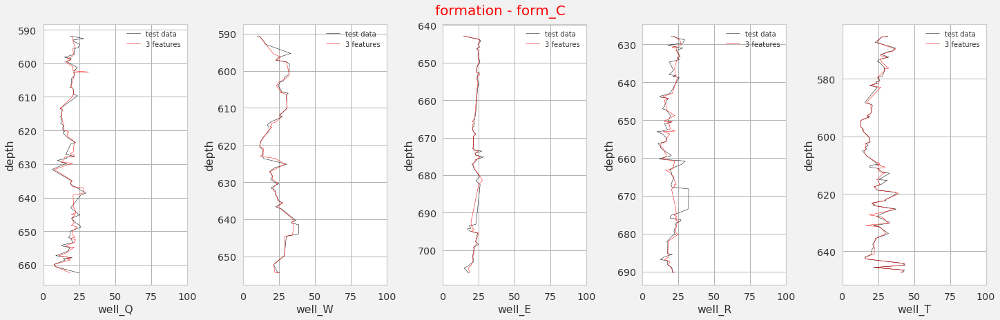

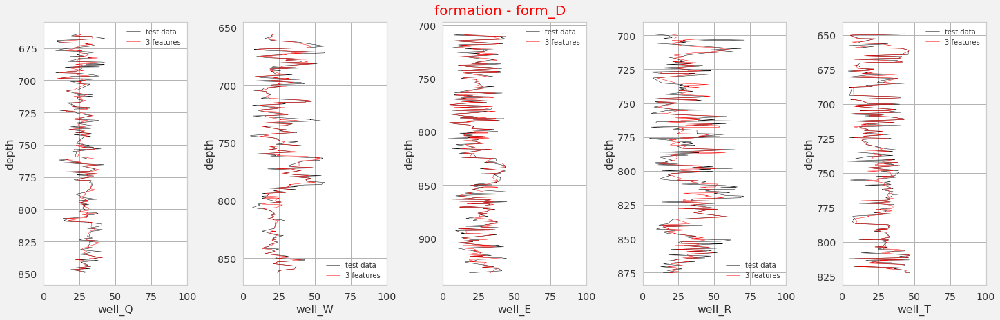

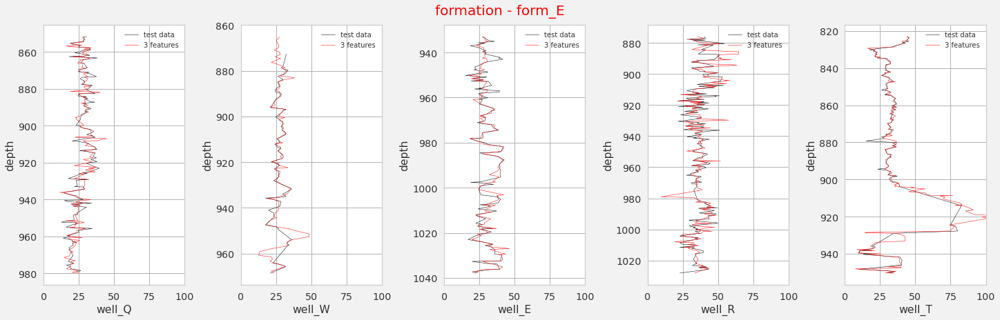

...

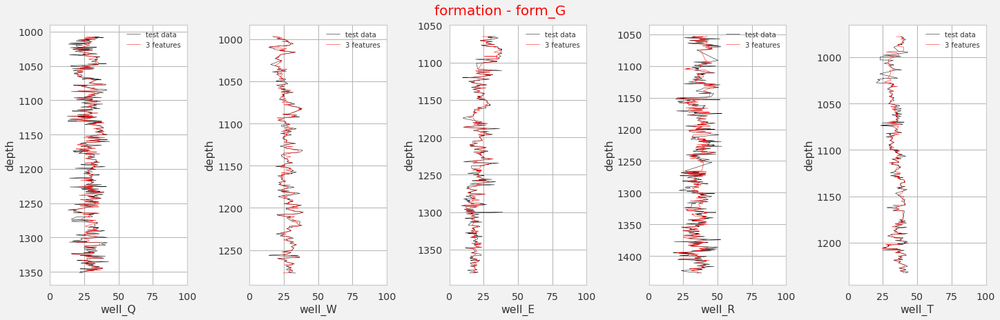

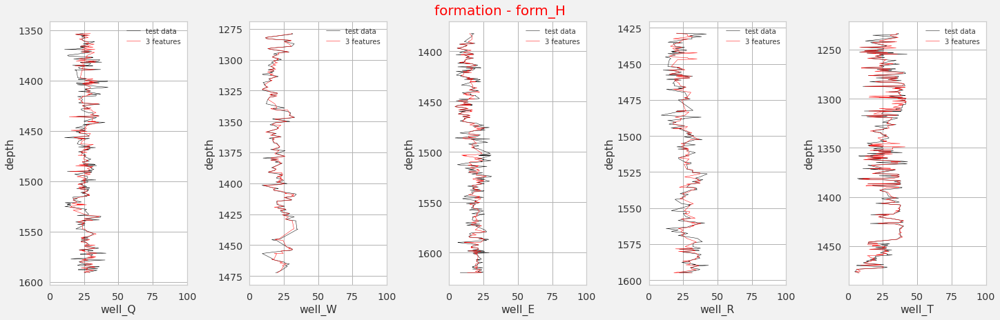

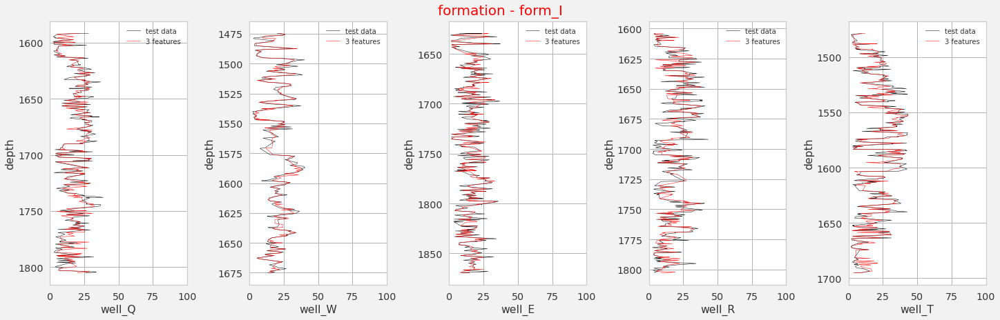

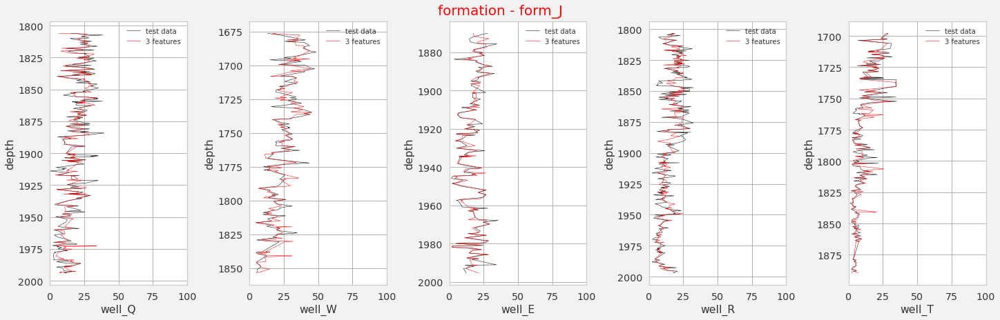

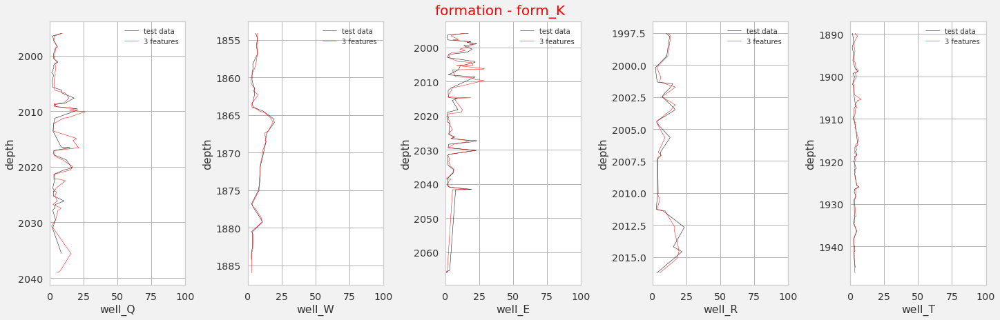

In [192]:
fun_vizual_789(X_test.query('clean_4 == 1'), section_prob_3, formation_list, wells, 0, 100,'ROP', 'predict_3_feat', '3 features')   

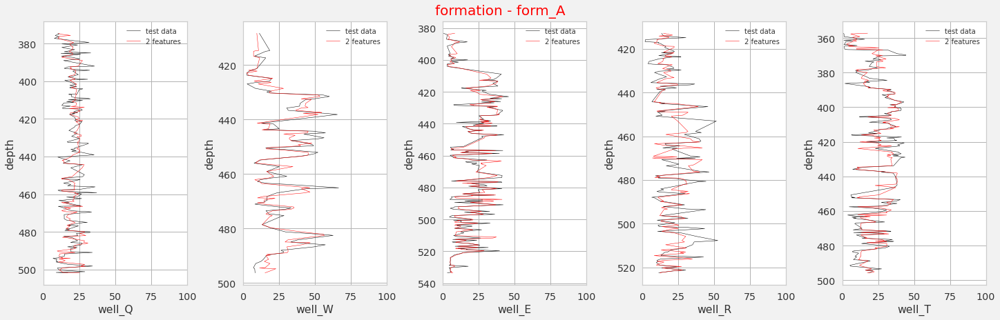

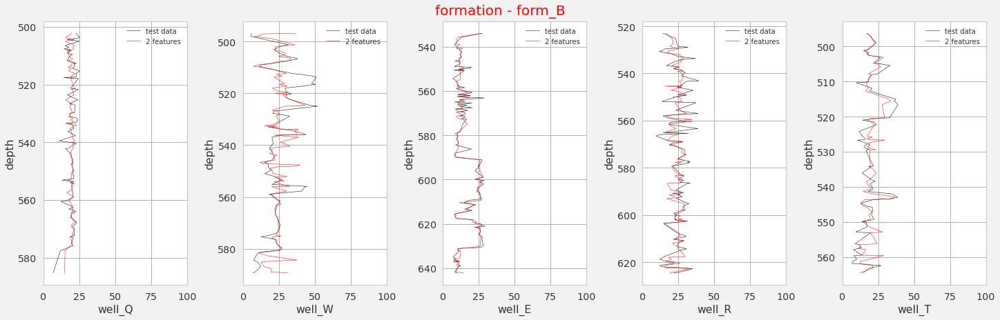

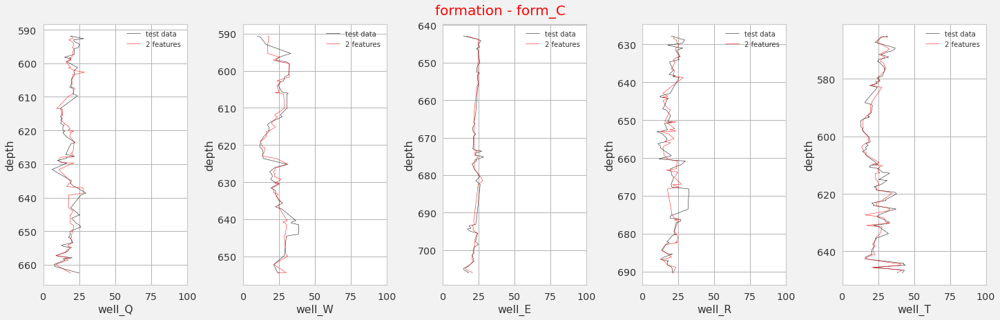

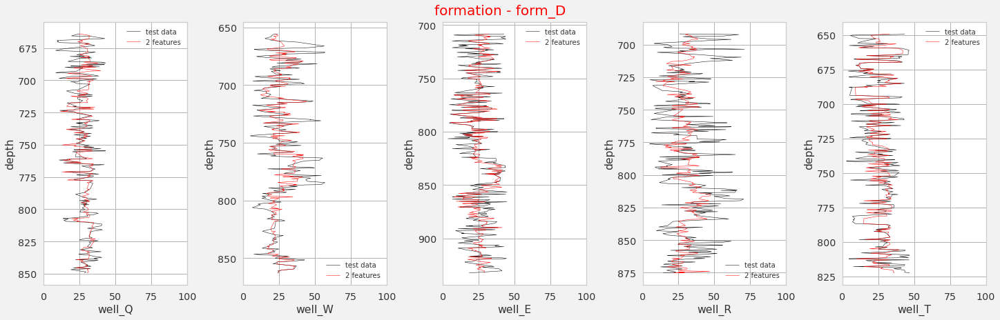

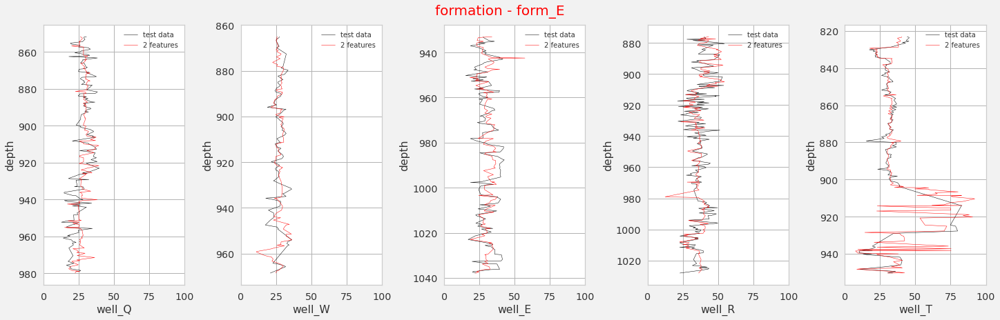

...

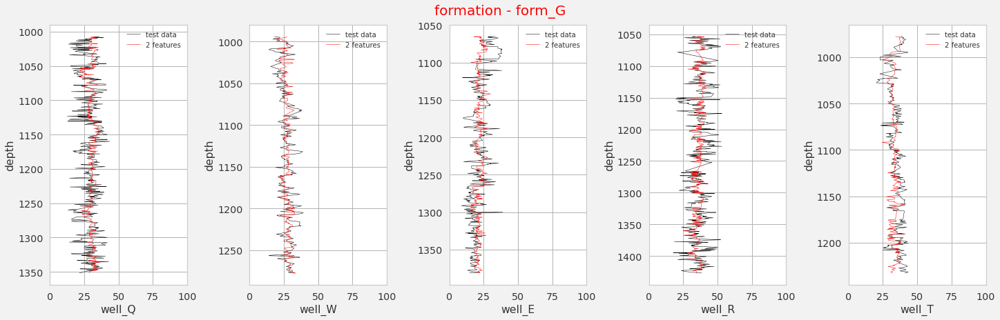

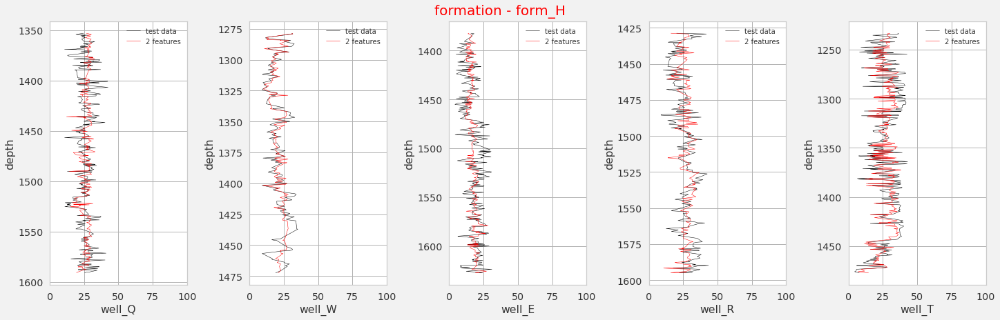

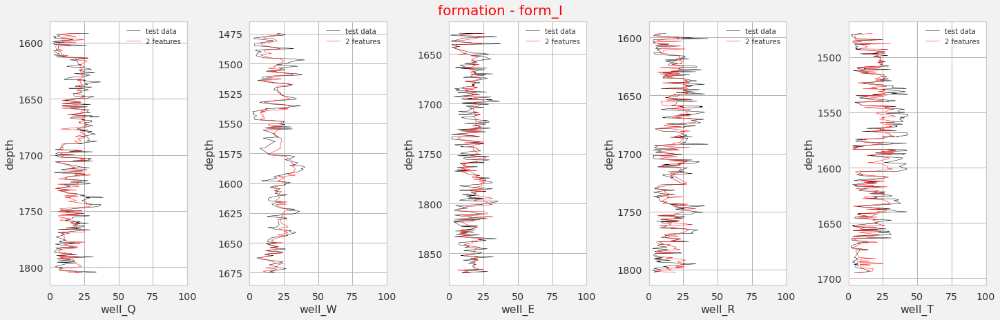

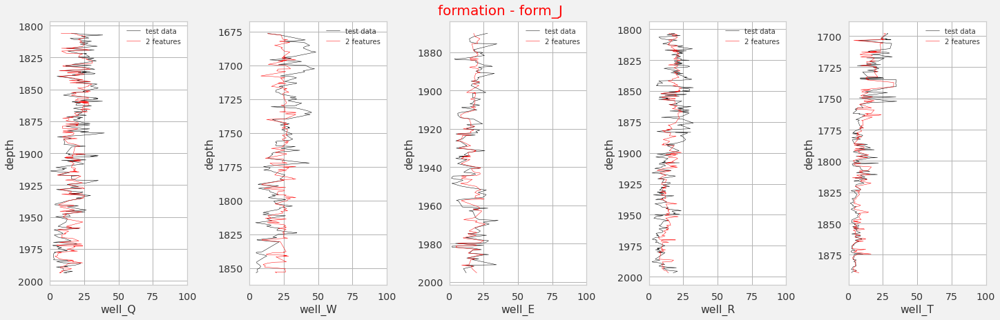

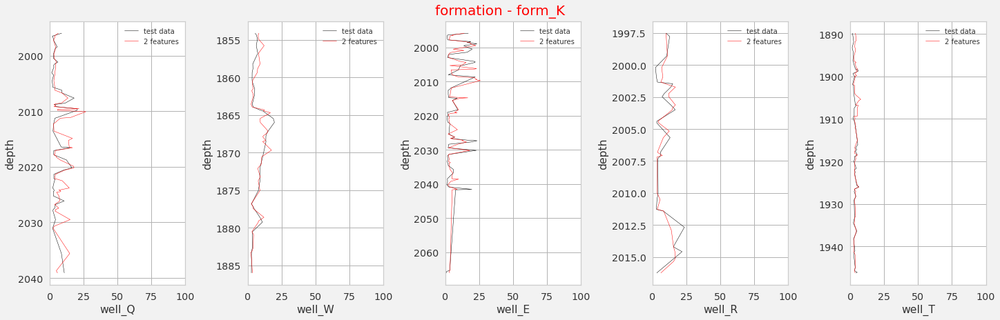

In [193]:
fun_vizual_789(X_test.query('clean_3 == 1'), section_prob_2, formation_list, wells, 0, 100,'ROP', 'predict_2_feat', '2 features')   

## train best models on entire dataset + SAVE

In [194]:
# what we have: 
# models:
best_models_models_6
best_models_models_5
best_models_models_3
best_models_models_2

# list of models:
model_6_feat
model_5_feat
model_3_feat
model_2_feat

# features for train
drilling_param_train_6
drilling_param_train_5
drilling_param_train_3
drilling_param_train_2

['RPM', 'WOB']

In [195]:
# what we have: 
# with/without cleaning better prediction was obtained
cln_6_feat, cln_5_feat, cln_3_feat, cln_2_feat

(['yes', 'yes', 'yes', 'yes', 'no', 'no', 'yes', 'yes', 'yes', 'yes', 'no'],
 ['yes', 'yes', 'yes', 'yes', 'no', 'no', 'yes', 'yes', 'yes', 'yes', 'no'],
 ['yes', 'yes', 'yes', 'yes', 'no', 'no', 'yes', 'no', 'yes', 'yes', 'no'],
 ['yes', 'yes', 'yes', 'yes', 'no', 'no', 'yes', 'yes', 'yes', 'yes', 'no'])

In [197]:
# train models on full data

def fun_full_data_fit_987(data_X_final, data_y_final, formation_list, best_model_list, best_models, column_clean, drilling_param_train, address, target, cleaning_results):
  
  for formation, model_name, model, cleaning in zip(formation_list, best_model_list, best_models, cleaning_results):
    temp_X_final = data_X_final.query('Formation == @formation')
    temp_y_final = data_y_final.query('Formation == @formation')
    
    # depending on yes/no train models on cleaned/raw entire dataset
    if cleaning == 'yes':
      temp_X_final = temp_X_final.loc[temp_X_final.loc[:, column_clean] == 1]
      temp_y_final = temp_y_final.loc[temp_y_final.loc[:, column_clean] == 1]
    
    else:
      temp_X_final = temp_X_final.loc[temp_X_final.loc[:, 'no_clean'] == 1]
      temp_y_final = temp_y_final.loc[temp_y_final.loc[:, 'no_clean'] == 1]

    model.fit(temp_X_final[drilling_param_train], temp_y_final[target])
    
    joblib.dump(model, f'/content/drive/My Drive/ROP/!_ROP_final_code/{address}/{model_name}')
  
  return

In [199]:
# 6 features
fun_full_data_fit_987(X_final, y_final, formation_list, model_6_feat_long, best_models_models_6, 'clean_5', drilling_param_train_6, 'section_16_models/models_article/models_6_features', 'ROP', cln_6_feat)

In [200]:
# 5 features
fun_full_data_fit_987(X_final, y_final, formation_list, model_5_feat_long, best_models_models_5, 'clean_4', drilling_param_train_5, 'section_16_models/models_article/models_5_features', 'ROP', cln_5_feat)

In [201]:
# 3 features
fun_full_data_fit_987(X_final, y_final, formation_list, model_3_feat_long, best_models_models_3, 'clean_4', drilling_param_train_3, 'section_16_models/models_article/models_3_features', 'ROP', cln_3_feat)

In [202]:
# 2 features
fun_full_data_fit_987(X_final, y_final, formation_list, model_2_feat_long, best_models_models_2, 'clean_3', drilling_param_train_2, 'section_16_models/models_article/models_2_features', 'ROP', cln_2_feat)

# well log prediction

## new dataset

In order to train models, 120 rows of data from the underlying formation were added to the dataset for each reservoir. Why 120 rows? In my case 120 rows or 18 meters is the minimum thickness of formation across all wells and I decides to stick with that number. Surely, it could be increased if necessary for each formation separately, as much as you want, but for purpose of top/bottom detection it’s more than enough. We don’t need include deeper intervals from underlying formation due to that could influence well log prediction.

In [224]:
section_prob =  pd.read_csv('/content/drive/My Drive/ROP/!_ROP_final_code/section_16_data/section_prob_art.csv')
section = section_prob.drop(['SPP_prb',	'ROP_prb',	'Torque_prb',	'RPM_prb',	'WOB_prb',	'SPP_prb_vld',	'ROP_prb_vld',	'Torque_prb_vld',	'RPM_prb_vld',	'WOB_prb_vld'], axis='columns')

In [225]:
section.shape

(62307, 30)

In [226]:
section.reset_index(drop = True)

,MD,LM,LM_DLM,DLM,DLM_C,E_GA,E_KMN,EXTR,SHC,SHS,SILT,UNS,SND,GR,DTC,RHOB,SPP,ROP,Torque,RPM,WOB,Formation,Well,MD_form,label,clusters,clean_5,clean_4,clean_3,no_clean
0,358.83,0.49,0.0,0.0,38.77,55.00,0.0,0.0,5.74,0.0,0.0,0.0,0.0,15.46,58.20,2.35,627.62,0.46,1601.82,48.97,9.50,form_A,well_Q,0.00,2,2.0,0,0,0,1
1,358.96,1.00,0.0,0.0,37.50,55.00,0.0,0.0,6.50,0.0,0.0,0.0,0.0,20.07,63.45,2.22,406.22,0.78,870.23,38.25,3.25,form_A,well_Q,0.15,2,2.0,0,0,0,1
2,359.08,1.51,0.0,0.0,36.22,55.00,0.0,0.0,7.26,0.0,0.0,0.0,0.0,24.11,69.39,2.07,392.69,2.40,765.67,33.05,2.21,form_A,well_Q,0.30,0,0.0,0,0,0,1
3,359.21,2.02,0.0,0.0,34.96,55.00,0.0,0.0,8.02,0.0,0.0,0.0,0.0,26.26,75.44,1.95,388.57,2.86,742.12,34.66,2.54,form_A,well_Q,0.45,0,0.0,0,0,0,1
4,359.35,2.52,0.0,0.0,33.69,55.00,0.0,0.0,8.78,0.0,0.0,0.0,0.0,26.59,81.00,1.95,388.62,2.73,752.28,39.10,3.42,form_A,well_Q,0.61,0,0.0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62302,1945.95,0.00,0.0,0.0,0.00,83.53,0.0,0.0,16.47,0.0,0.0,0.0,0.0,12.66,45.03,2.36,1938.12,4.06,9502.70,118.46,15.23,form_K,well_T,66.29,2,2.0,0,0,1,1
62303,1946.08,0.00,0.0,0.0,0.00,85.05,0.0,0.0,14.95,0.0,0.0,0.0,0.0,13.21,45.92,2.38,1939.74,4.99,10074.40,116.45,15.14,form_K,well_T,66.45,2,2.0,0,0,1,1
62304,1946.21,0.00,0.0,0.0,0.00,86.58,0.0,0.0,13.42,0.0,0.0,0.0,0.0,13.68,47.20,2.37,1925.84,4.16,10005.49,116.45,15.27,form_K,well_T,66.60,2,2.0,0,0,1,1
62305,1946.34,0.00,0.0,0.0,0.00,88.10,0.0,0.0,11.90,0.0,0.0,0.0,0.0,14.70,48.70,2.33,1917.11,3.82,10054.68,116.04,15.36,form_K,well_T,66.75,2,2.0,0,0,1,1


In [227]:
# new dataframe
section_GIS = pd.DataFrame()

# all formation with exeption for form_K. that formation will be used as is due to that is last one
for well in wells:
  temp_1 = section.query('Well == @well')
  
  for i in range(10):
    
    temp_2 = temp_1.loc[temp_1['Formation'] == formation_list[i]].reset_index(drop = True)
    temp_3 = temp_1.loc[temp_1.loc[:,'Formation'] == formation_list[i+1]].reset_index(drop = True).loc[:120, :]    
    temp_2['form_GIS_train'] = formation_list[i] # mark upper formation
    temp_3['form_GIS_train'] = formation_list[i] #  mark 121nd rows of underlying formation as upper formation
    temp_4 = pd.concat([temp_2, temp_3])

    section_GIS = pd.concat([section_GIS, temp_4])

In [228]:
# 6050 rows were added = 5 well * 10 formations * 121 rows 
len(section_GIS) - len(section.query('Formation != "form_K"'))

6050

In [229]:
# adding formation K 
form_K = section.query('Formation == "form_K"')
form_K.loc[form_K['Formation'] == "form_K", 'form_GIS_train']="form_K"

section_GIS = pd.concat([section_GIS, form_K]).reset_index(drop = True)

In [230]:
section_GIS

,MD,LM,LM_DLM,DLM,DLM_C,E_GA,E_KMN,EXTR,SHC,SHS,SILT,UNS,SND,GR,DTC,RHOB,SPP,ROP,Torque,RPM,WOB,Formation,Well,MD_form,label,clusters,clean_5,clean_4,clean_3,no_clean,form_GIS_train
0,358.83,0.49,0.0,0.0,38.77,55.00,0.0,0.0,5.74,0.0,0.0,0.0,0.0,15.46,58.20,2.35,627.62,0.46,1601.82,48.97,9.50,form_A,well_Q,0.00,2,2.0,0,0,0,1,form_A
1,358.96,1.00,0.0,0.0,37.50,55.00,0.0,0.0,6.50,0.0,0.0,0.0,0.0,20.07,63.45,2.22,406.22,0.78,870.23,38.25,3.25,form_A,well_Q,0.15,2,2.0,0,0,0,1,form_A
2,359.08,1.51,0.0,0.0,36.22,55.00,0.0,0.0,7.26,0.0,0.0,0.0,0.0,24.11,69.39,2.07,392.69,2.40,765.67,33.05,2.21,form_A,well_Q,0.30,0,0.0,0,0,0,1,form_A
3,359.21,2.02,0.0,0.0,34.96,55.00,0.0,0.0,8.02,0.0,0.0,0.0,0.0,26.26,75.44,1.95,388.57,2.86,742.12,34.66,2.54,form_A,well_Q,0.45,0,0.0,0,0,0,1,form_A
4,359.35,2.52,0.0,0.0,33.69,55.00,0.0,0.0,8.78,0.0,0.0,0.0,0.0,26.59,81.00,1.95,388.62,2.73,752.28,39.10,3.42,form_A,well_Q,0.61,0,0.0,0,0,0,1,form_A
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
68352,1945.95,0.00,0.0,0.0,0.00,83.53,0.0,0.0,16.47,0.0,0.0,0.0,0.0,12.66,45.03,2.36,1938.12,4.06,9502.70,118.46,15.23,form_K,well_T,66.29,2,2.0,0,0,1,1,form_K
68353,1946.08,0.00,0.0,0.0,0.00,85.05,0.0,0.0,14.95,0.0,0.0,0.0,0.0,13.21,45.92,2.38,1939.74,4.99,10074.40,116.45,15.14,form_K,well_T,66.45,2,2.0,0,0,1,1,form_K
68354,1946.21,0.00,0.0,0.0,0.00,86.58,0.0,0.0,13.42,0.0,0.0,0.0,0.0,13.68,47.20,2.37,1925.84,4.16,10005.49,116.45,15.27,form_K,well_T,66.60,2,2.0,0,0,1,1,form_K
68355,1946.34,0.00,0.0,0.0,0.00,88.10,0.0,0.0,11.90,0.0,0.0,0.0,0.0,14.70,48.70,2.33,1917.11,3.82,10054.68,116.04,15.36,form_K,well_T,66.75,2,2.0,0,0,1,1,form_K


In [232]:
len(section_GIS) - len(section)

# due to formation K was added without changes, it did not come to dataset increase

6050

## TRAIN and TEST for well logs

In [234]:
# features to be included in target
target_list_GIS = ['MD', 'MD_form', 'Well', 'Formation', 'RHOB', 'DTC', 'GR', 'clusters',  'no_clean', 'clean_5', 'form_GIS_train']

In [235]:
X_final_GIS, y_final_GIS = fun_11(section_GIS, target_list_GIS)
X_final_GIS.shape, y_final_GIS.shape

((68357, 31), (68357, 11))

In [237]:
# make train and test
def fun_train_test_GIS(data, targets, formation_list):
  #----------------------
  X_train = pd.DataFrame()
  X_test = pd.DataFrame()
  y_train = pd.DataFrame()
  y_test = pd.DataFrame()
  #----------------------
  # для каждой формации вырезаем 20% данных
  for well in wells:
    # срез по скважине 
    temp_1 = data.query('Well == @well')
    for formation in formation_list:
      # срез по пласту
      temp_2 = temp_1.query('form_GIS_train == @formation') # !!!!!! use form_GIS_train (+121)
      for cluster in range(0,4):
        temp_3 = temp_2.query('clusters == @cluster') 
        # разделяем на train и test
        temp_X= temp_3.copy() # не удаляю лишние признаки - так как всё равно работаем со списком признаков
        temp_y = temp_3[targets] # признаки которые пойдут в в выборку с таргетами
        # вырезаем 20%
        temp_X_train, temp_X_test, temp_y_train, temp_y_test = train_test_split(temp_X, temp_y, test_size=0.20, random_state=random_state)
        # соединяем вырезанное для TRAIN
        X_train = pd.concat([X_train, temp_X_train])
        y_train = pd.concat([y_train, temp_y_train])
        # сортируем TRAIN после разделения выборок
        X_train = X_train.sort_values('MD', ascending=True)
        y_train = y_train.sort_values('MD', ascending=True)
        # соединяем вырезанное для TEST
        X_test = pd.concat([X_test, temp_X_test])
        y_test = pd.concat([y_test, temp_y_test])
        # сортируем TEST после разделения выборок
        X_test = X_test.sort_values('MD', ascending=True)
        y_test = y_test.sort_values('MD', ascending=True)
  return X_train, y_train, X_test, y_test 

In [238]:
# split on train and test
# use form_GIS_train but not Formation
X_train_GIS, y_train_GIS, X_test_GIS, y_test_GIS = fun_train_test_GIS(section_GIS, target_list_GIS, formation_list)

In [239]:
# sizes
X_train_GIS.shape, y_train_GIS.shape, X_test_GIS.shape, y_test_GIS.shape

((54607, 31), (54607, 11), (13750, 31), (13750, 11))

In [240]:
# check
X_train_GIS.shape[0] + X_test_GIS.shape[0]


68357

## **comparison of train and test datasets distribution**

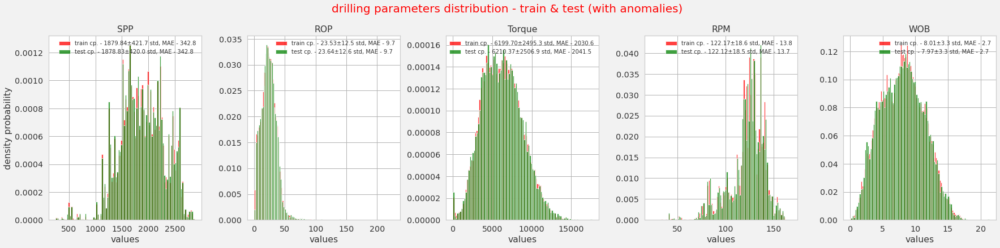

In [241]:
fun_visuzlization_train_test_dist(X_train_GIS, X_test_GIS, drilling_param, 'drilling parameters distribution - train & test (with anomalies)')

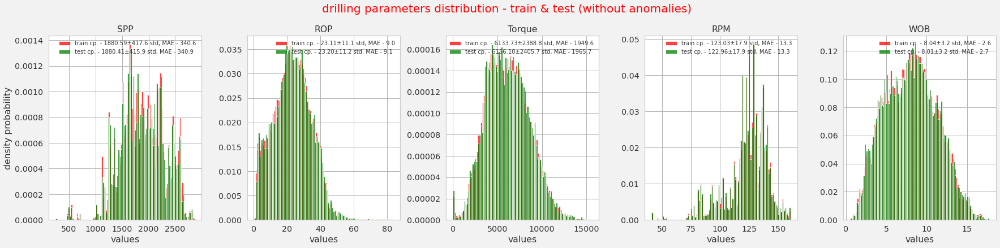

In [242]:
fun_visuzlization_train_test_dist(X_train_GIS.query('clean_5 == 1'), X_test_GIS.query('clean_5 == 1'), drilling_param, 'drilling parameters distribution - train & test (without anomalies)')

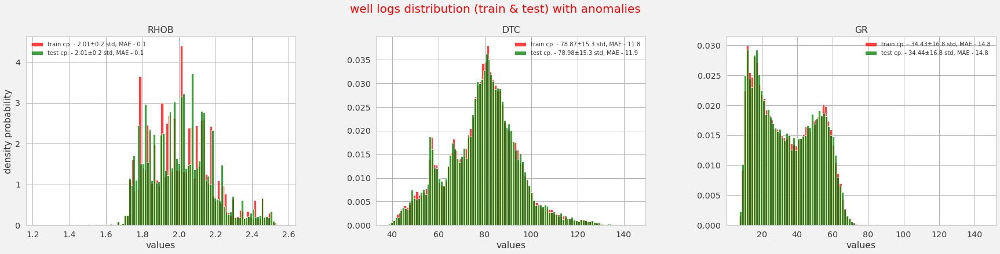

In [244]:
temp_GIS = ['RHOB', 'DTC', 'GR']
fun_visuzlization_train_test_dist(y_train_GIS, y_test_GIS, temp_GIS, 'well logs distribution (train & test) with anomalies')

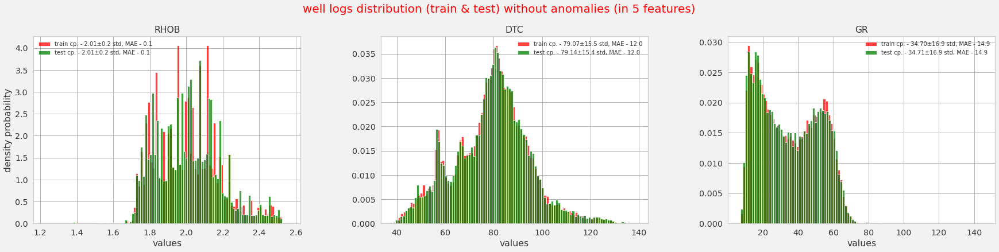

In [245]:
fun_visuzlization_train_test_dist(y_train_GIS.query('clean_5 == 1'), y_test_GIS.query('clean_5 == 1'), temp_GIS, 'well logs distribution (train & test) without anomalies (in 5 features)')

## functions and lists

In [246]:
# select the best model to be used for ROP prediction
def fun_predict_GIS(data_X_train, data_X_test, 
                   data_y_train, data_y_test, 
                   drilling_param_train, 
                   formation_list, 
                   target, 
                   list_models,
                   best_models_names,  
                   best_models_score):
  
  # -------- fill table with results of ROP prediction for each model ------------
  y_test_predict_models = pd.DataFrame() 
  for formation in formation_list:
    temp_X_train = data_X_train.query('form_GIS_train == @formation')  # -!!!!!! form_GIS_train but not Formation
    temp_y_train = data_y_train.query('form_GIS_train == @formation')  # -!!!!!! form_GIS_train but not Formation
    temp_X_test =  data_X_test.query( 'form_GIS_train == @formation')  # -!!!!!! form_GIS_train but not Formation
    temp_y_test =  data_y_test.query( 'form_GIS_train == @formation')  # -!!!!!! form_GIS_train but not Formation

    for model, model_name in zip(models, list_models):
      model.fit(temp_X_train[drilling_param_train], temp_y_train[target])
      
      temp_y_test[model_name] = model.predict(temp_X_test[drilling_param_train])
    
    y_test_predict_models = pd.concat([y_test_predict_models, temp_y_test])

  # -------- fill next table with R2 -----------
  y_test_predict_models_R2 = pd.DataFrame(index = formation_list)
  for formation in formation_list:
    temp = y_test_predict_models.query('Formation == @formation')
    
    for model in list_models:
      y_test_predict_models_R2.loc[formation, model] = (r2_score(temp[target], temp[model]))

  # clean table
  y_test_predict_models.drop(columns = list_models, inplace = True)

  # ----------list of best models --------------------
  summary = pd.DataFrame(index = formation_list, columns = [best_models_names, best_models_score])
  best_model_list = []
  mean_score = []

  for formation in formation_list:
    best_model = y_test_predict_models_R2.loc[formation, :].idxmax(axis = 1)
    mean = y_test_predict_models_R2.loc[formation, best_model]

    summary.loc[formation, best_models_names] = best_model
    summary.loc[formation, best_models_score] = mean

  return summary

In [248]:
# function for train on full data
def fun_predict_prob_GIS(X_train, y_train, X_test, y_test,
                     formation_list,
             best_models_models,
             cleaning_results,
             column_clean,
             drilling_param, 
             target_predict,
             target):
  
  predict_results = pd.DataFrame()

  for formation, model, cleaning in zip(formation_list, best_models_models, cleaning_results):
    
    temp_X_train = X_train.query('form_GIS_train == @formation')  # -!!!!!! form_GIS_train but not Formation
    temp_y_train = y_train.query('form_GIS_train == @formation')  # -!!!!!! 
    temp_X_test =  X_test.query( 'form_GIS_train == @formation')  # -!!!!!! 
    temp_y_test =  y_test.query( 'form_GIS_train == @formation')  # -!!!!!! 
    
    
    if cleaning == 'yes':
      temp_X_train = temp_X_train.loc[X_train.loc[:, column_clean] == 1]
      temp_y_train = temp_y_train.loc[y_train.loc[:, column_clean] == 1]
      temp_X_test  = temp_X_test.loc[X_test.loc[:,   column_clean] == 1]
      temp_y_test  = temp_y_test.loc[y_test.loc[:,   column_clean] == 1]
    
    else:
      temp_X_train = temp_X_train.loc[X_train.loc[:, 'no_clean'] == 1]
      temp_y_train = temp_y_train.loc[y_train.loc[:, 'no_clean'] == 1]
      temp_X_test = temp_X_test.loc[X_test.loc[:, 'no_clean']    == 1]
      temp_y_test = temp_y_test.loc[y_test.loc[:, 'no_clean']    == 1]   
    
    model.fit(temp_X_train[drilling_param], temp_y_train[target])
    temp_y_test[target_predict] = model.predict(temp_X_test[drilling_param])
    
    predict_results = pd.concat([predict_results, temp_y_test])
  
  return predict_results

In [279]:
# for visualization of test vs predict
def fun_vizual_GIS(data, formation_list, wells, x_min, x_max, target, predict):
  for formation in formation_list:
    temp_1      = data.query('form_GIS_train == @formation') 
    temp_border = data.query('Formation == @formation') # для того чтобы снять глубину границы пласта для визуализации
    fig, ax = plt.subplots(1, len(wells), figsize=(20, 6), constrained_layout=True)
      
    for i, well in enumerate(wells):
      temp_2 = temp_1.query('Well == @well')
      temp_border_2 = temp_border.query('Well == @well')

      form_border = temp_border_2['MD'].iloc[-1] # глубина границы верхнего пласта

      ax[i].plot(temp_2[target], temp_2['MD'],  linewidth=0.5, color = 'black', label = f"{target} - fact")
      ax[i].plot(temp_2[predict], temp_2['MD'], linewidth=0.5, color = 'red',   label = f"{target} - predict")
      
      ax[i].set_xlim(x_min, x_max)
      ax[i].set_xlabel(well)
      ax[i].set_ylabel('depth')
      ax[i].invert_yaxis()
      ax[i].legend(prop={'size': 10})
      
      ax[i].axhline(y = form_border, color = 'green', linestyle = '--')  

      fig.suptitle(f'formation - {formation}, {target}', y = 1.05, fontsize = 20, color = 'r')   

In [256]:
# use only single case - 7 features

GIS_models =      ['no_cln_7_feat',     'cln_7_feat']
GIS_model_score = ['no_cln_7_feat_scr', 'cln_7_feat_scr']

In [257]:
# 7 features
GIS_drilling_param_train = ['MD', 'MD_form', 'SPP', 'Torque','RPM','WOB', 'ROP']

In [258]:
# name of columns to compare accuracy of prediction with/without anomalies
GIS_column_list = ['no_clean', 'clean_5']

## GR

### best models selection

In [259]:
summary_final_GR = pd.DataFrame(index= formation_list)

for column, best_models_names, best_models_score in zip(GIS_column_list, GIS_models, GIS_model_score):
    temp_X_train = X_train_GIS.loc[X_train_GIS.loc[:, column] == 1]
    temp_y_train = y_train_GIS.loc[y_train_GIS.loc[:, column] == 1]
    temp_X_test  =  X_test_GIS.loc[X_test_GIS.loc[ :, column] == 1]
    temp_y_test  =  y_test_GIS.loc[y_test_GIS.loc[ :, column] == 1]

    summary = fun_predict_GIS(temp_X_train, temp_X_test, 
                             temp_y_train, temp_y_test,
                             GIS_drilling_param_train, 
                             formation_list, 
                             'GR', 
                             list_models,
                             best_models_names, best_models_score)
    
    summary_final_GR = pd.merge(summary_final_GR, summary, left_index=True, right_index=True)


In [260]:
summary_final_GR

,no_cln_7_feat,no_cln_7_feat_scr,cln_7_feat,cln_7_feat_scr
form_A,RandomForestRegressor,0.831064,RandomForestRegressor,0.829301
form_B,RandomForestRegressor,0.918375,RandomForestRegressor,0.89787
form_C,RandomForestRegressor,0.887794,RandomForestRegressor,0.790667
form_D,RandomForestRegressor,0.899211,RandomForestRegressor,0.894713
form_E,RandomForestRegressor,0.925266,RandomForestRegressor,0.920048
form_F,CatBoostRegressor,0.871984,CatBoostRegressor,0.861471
form_G,RandomForestRegressor,0.902573,RandomForestRegressor,0.905535
form_H,RandomForestRegressor,0.886038,RandomForestRegressor,0.873455
form_I,RandomForestRegressor,0.817217,RandomForestRegressor,0.807061
form_J,RandomForestRegressor,0.751397,RandomForestRegressor,0.740671


In [261]:
summary_final_GR_short = summary_final_GR[['no_cln_7_feat_scr', 'cln_7_feat_scr']]
new_table_summary_GR = pd.DataFrame(index = formation_list)

In [262]:
summary_final_GR_short

,no_cln_7_feat_scr,cln_7_feat_scr
form_A,0.831064,0.829301
form_B,0.918375,0.89787
form_C,0.887794,0.790667
form_D,0.899211,0.894713
form_E,0.925266,0.920048
form_F,0.871984,0.861471
form_G,0.902573,0.905535
form_H,0.886038,0.873455
form_I,0.817217,0.807061
form_J,0.751397,0.740671


In [263]:
summary_final_GR_short = summary_final_GR_short[['no_cln_7_feat_scr', 'cln_7_feat_scr']].astype('float')

In [264]:
summary_final_GR_short

,no_cln_7_feat_scr,cln_7_feat_scr
form_A,0.831064,0.829301
form_B,0.918375,0.897870
form_C,0.887794,0.790667
form_D,0.899211,0.894713
form_E,0.925266,0.920048
form_F,0.871984,0.861471
form_G,0.902573,0.905535
form_H,0.886038,0.873455
form_I,0.817217,0.807061
form_J,0.751397,0.740671


In [267]:
# GR

for formation in formation_list:
  best_model = summary_final_GR_short.loc[formation, :].idxmax(axis = 1) # # get the column name for the biggest value in row
  
  if best_model == 'cln_7_feat_scr':
    new_table_summary_GR.loc[formation, 'model_7_feat'] = summary_final_GR.loc[formation, 'cln_7_feat']
    new_table_summary_GR.loc[formation, 'score_7_feat'] = summary_final_GR.loc[formation, 'cln_7_feat_scr']
    new_table_summary_GR.loc[formation, 'cln_7_feat'] = 'yes'
  else:
    new_table_summary_GR.loc[formation, 'model_7_feat'] = summary_final_GR.loc[formation, 'no_cln_7_feat']
    new_table_summary_GR.loc[formation, 'score_7_feat'] = summary_final_GR.loc[formation, 'no_cln_7_feat_scr']
    new_table_summary_GR.loc[formation, 'cln_7_feat'] = 'no'

In [268]:
new_table_summary_GR

,model_7_feat,score_7_feat,cln_7_feat
form_A,RandomForestRegressor,0.831064,no
form_B,RandomForestRegressor,0.918375,no
form_C,RandomForestRegressor,0.887794,no
form_D,RandomForestRegressor,0.899211,no
form_E,RandomForestRegressor,0.925266,no
form_F,CatBoostRegressor,0.871984,no
form_G,RandomForestRegressor,0.905535,yes
form_H,RandomForestRegressor,0.886038,no
form_I,RandomForestRegressor,0.817217,no
form_J,RandomForestRegressor,0.751397,no


### list of the best models for prediction

In [270]:
model_7_feat_GIS = new_table_summary_GR['model_7_feat'].tolist()
cln_7_feat_GIS   = new_table_summary_GR['cln_7_feat'].tolist()

In [271]:
model_7_feat_GIS

['RandomForestRegressor',
 'RandomForestRegressor',
 'RandomForestRegressor',
 'RandomForestRegressor',
 'RandomForestRegressor',
 'CatBoostRegressor',
 'RandomForestRegressor',
 'RandomForestRegressor',
 'RandomForestRegressor',
 'RandomForestRegressor',
 'CatBoostRegressor']

In [272]:
cln_7_feat_GIS

['no', 'no', 'no', 'no', 'no', 'no', 'yes', 'no', 'no', 'no', 'yes']

In [273]:
# best models 
best_models_models_7_GIS = fun_models_best(model_7_feat_GIS, names_models_dict)

In [274]:
best_models_models_7_GIS

[RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                       max_depth=None, max_features='auto', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=None, oob_score=False,
                       random_state=None, verbose=0, warm_start=False),
 RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                       max_depth=None, max_features='auto', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=None, oob_score=False,
                       random_state=None, verbose=0, warm_star

### GR predict

In [275]:
GIS_predict_GR = fun_predict_prob_GIS(X_train_GIS, y_train_GIS, X_test_GIS, y_test_GIS,
                                  formation_list,
                                  best_models_models_7_GIS, # predict на MD, MD_form, WOB, RPM, Torque, SPP + ROP
                                  cln_7_feat_GIS, 
                                  'clean_5',            # чистили -  WOB, RPM, Torque, SPP + ROP 
                                  GIS_drilling_param_train, 
                                  'GR_predict',
                                  'GR')

In [276]:
GIS_predict_GR

,MD,MD_form,Well,Formation,RHOB,DTC,GR,clusters,no_clean,clean_5,form_GIS_train,GR_predict
53720,357.27,0.31,well_T,form_A,1.38,47.43,15.40,0.0,1,1,form_A,17.357600
53723,357.66,0.77,well_T,form_A,1.39,48.84,15.81,0.0,1,1,form_A,15.664200
53727,358.18,1.38,well_T,form_A,1.38,54.60,17.02,0.0,1,1,form_A,18.275300
53733,358.96,2.29,well_T,form_A,2.29,45.10,13.26,0.0,1,1,form_A,16.156400
4,359.35,0.61,well_Q,form_A,1.95,81.00,26.59,0.0,1,0,form_A,25.623800
...,...,...,...,...,...,...,...,...,...,...,...,...
67693,2040.38,52.39,well_E,form_K,2.44,48.17,12.82,2.0,1,1,form_K,14.019621
67697,2040.90,53.00,well_E,form_K,2.25,69.05,26.17,3.0,1,1,form_K,23.218476
67702,2041.55,53.76,well_E,form_K,1.95,66.79,28.10,3.0,1,1,form_K,33.150250
67703,2041.68,53.92,well_E,form_K,2.10,60.10,21.38,0.0,1,1,form_K,26.804139


### Visualization

In [277]:
GIS_predict_GR['GR_predict'].max(), GIS_predict_GR['GR_predict'].min()

(119.75270000000009, 7.995699999999988)

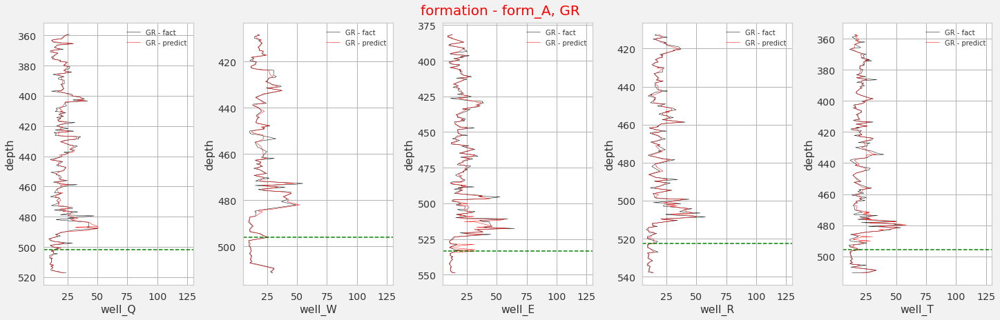

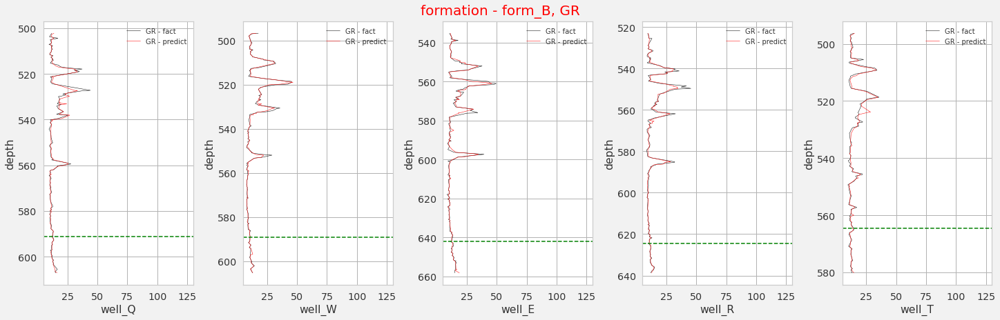

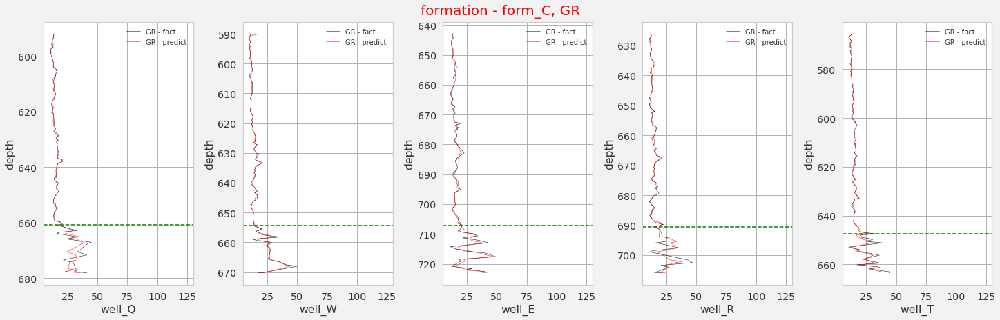

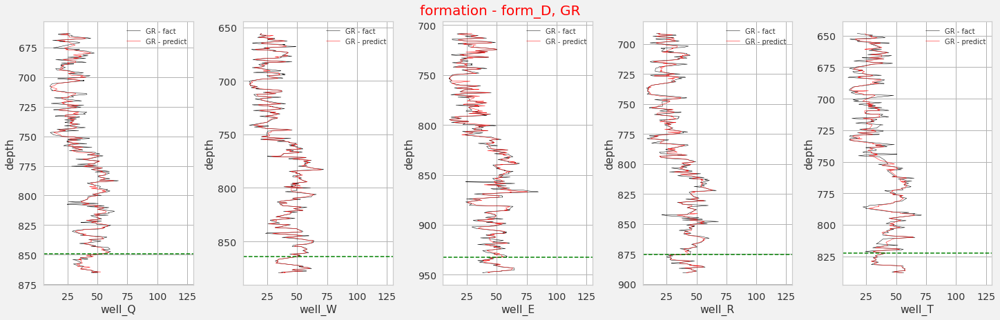

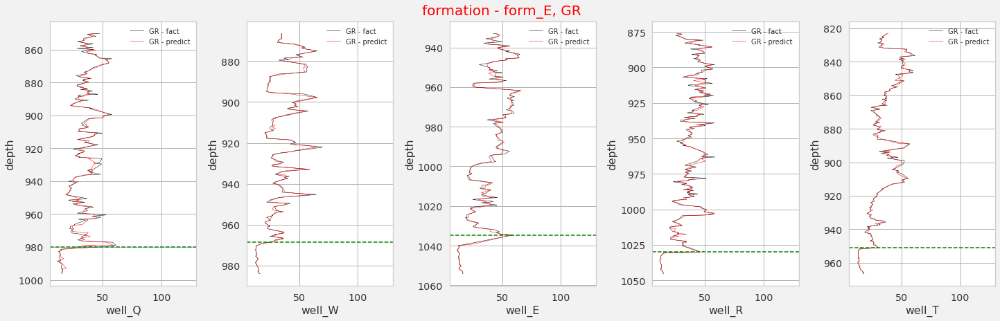

...

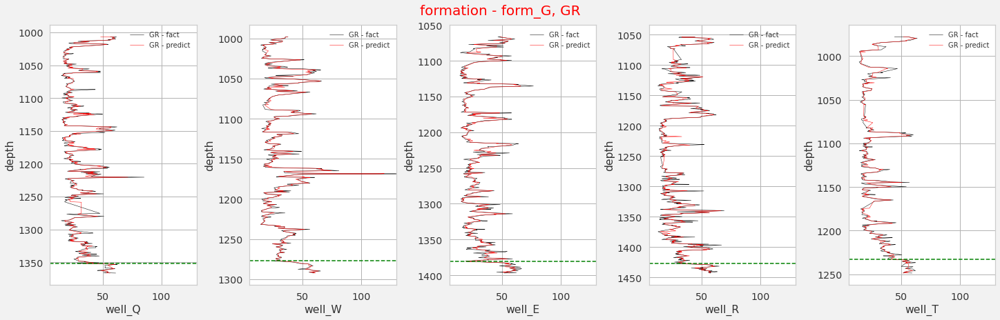

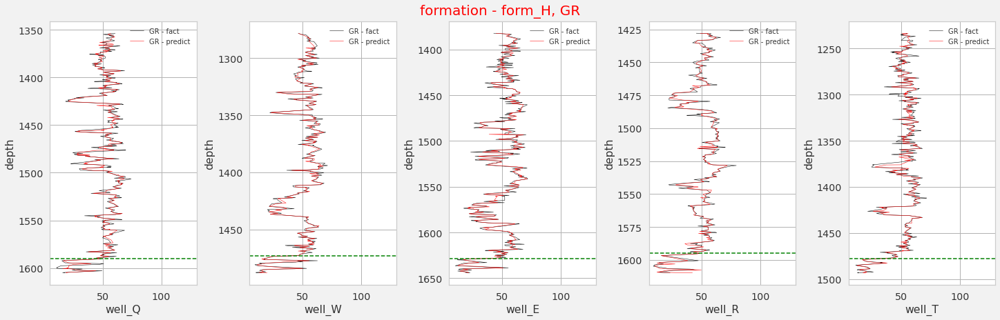

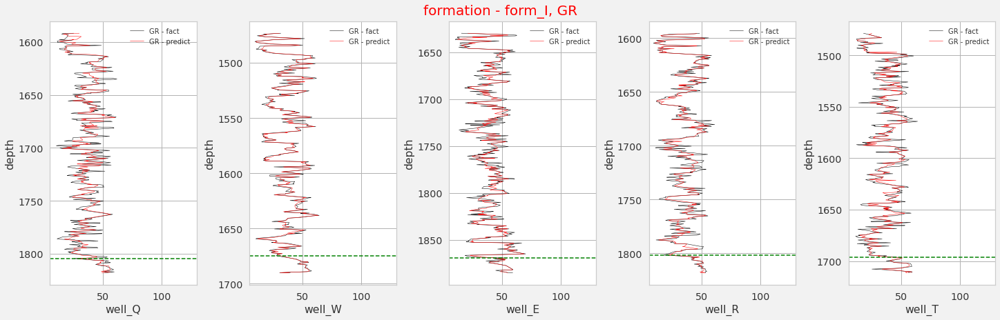

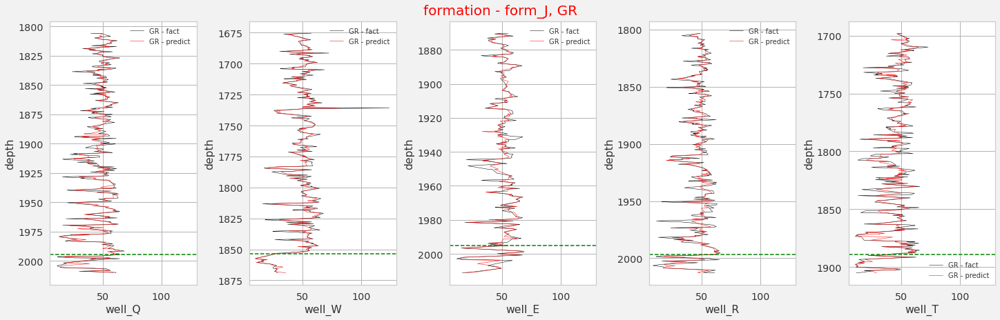

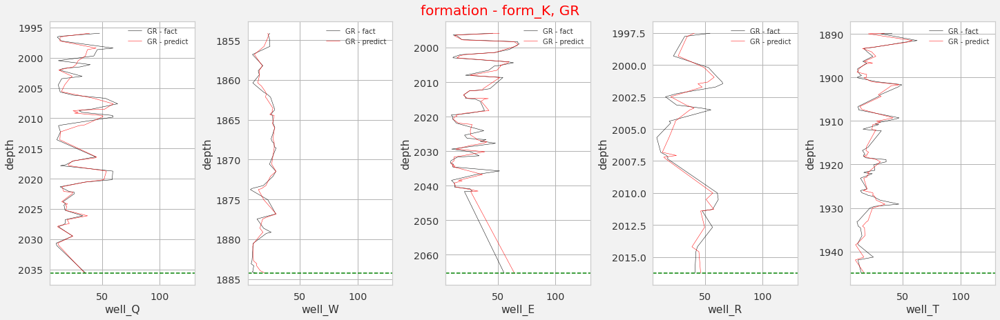

In [280]:
# test vs predict

fun_vizual_GIS(GIS_predict_GR, formation_list, wells, 5, 130,'GR', 'GR_predict')   

## RHOB

### best models selection

In [281]:
summary_final_RHOB = pd.DataFrame(index= formation_list)

for column, best_models_names, best_models_score in zip(GIS_column_list, GIS_models, GIS_model_score):
    temp_X_train = X_train_GIS.loc[X_train_GIS.loc[:, column] == 1]
    temp_y_train = y_train_GIS.loc[y_train_GIS.loc[:, column] == 1]
    temp_X_test  =  X_test_GIS.loc[X_test_GIS.loc[ :, column] == 1]
    temp_y_test  =  y_test_GIS.loc[y_test_GIS.loc[ :, column] == 1]

    summary = fun_predict_GIS(temp_X_train, temp_X_test, 
                             temp_y_train, temp_y_test,
                             GIS_drilling_param_train, 
                             formation_list, 
                             'RHOB', 
                             list_models,
                             best_models_names, best_models_score)
    
    summary_final_RHOB = pd.merge(summary_final_RHOB, summary, left_index=True, right_index=True)


In [282]:
summary_final_RHOB

,no_cln_7_feat,no_cln_7_feat_scr,cln_7_feat,cln_7_feat_scr
form_A,RandomForestRegressor,0.8353,RandomForestRegressor,0.812592
form_B,RandomForestRegressor,0.911579,RandomForestRegressor,0.914075
form_C,RandomForestRegressor,0.920022,RandomForestRegressor,0.915977
form_D,RandomForestRegressor,0.766847,RandomForestRegressor,0.758759
form_E,RandomForestRegressor,0.887589,RandomForestRegressor,0.866605
form_F,RandomForestRegressor,0.856377,RandomForestRegressor,0.823126
form_G,RandomForestRegressor,0.874035,RandomForestRegressor,0.842151
form_H,RandomForestRegressor,0.811855,RandomForestRegressor,0.795509
form_I,RandomForestRegressor,0.864794,RandomForestRegressor,0.846847
form_J,RandomForestRegressor,0.771465,RandomForestRegressor,0.754637


In [283]:
summary_final_RHOB_short = summary_final_RHOB[['no_cln_7_feat_scr', 'cln_7_feat_scr']]
new_table_summary_RHOB = pd.DataFrame(index = formation_list)

In [284]:
summary_final_RHOB_short

,no_cln_7_feat_scr,cln_7_feat_scr
form_A,0.8353,0.812592
form_B,0.911579,0.914075
form_C,0.920022,0.915977
form_D,0.766847,0.758759
form_E,0.887589,0.866605
form_F,0.856377,0.823126
form_G,0.874035,0.842151
form_H,0.811855,0.795509
form_I,0.864794,0.846847
form_J,0.771465,0.754637


In [285]:
summary_final_RHOB_short = summary_final_RHOB_short[['no_cln_7_feat_scr', 'cln_7_feat_scr']].astype('float')

In [286]:
summary_final_RHOB_short

,no_cln_7_feat_scr,cln_7_feat_scr
form_A,0.835300,0.812592
form_B,0.911579,0.914075
form_C,0.920022,0.915977
form_D,0.766847,0.758759
form_E,0.887589,0.866605
form_F,0.856377,0.823126
form_G,0.874035,0.842151
form_H,0.811855,0.795509
form_I,0.864794,0.846847
form_J,0.771465,0.754637


In [287]:
# RHOB

for formation in formation_list:
  best_model = summary_final_RHOB_short.loc[formation, :].idxmax(axis = 1) 
  
  if best_model == 'cln_7_feat_scr':
    new_table_summary_RHOB.loc[formation, 'model_7_feat'] = summary_final_RHOB.loc[formation, 'cln_7_feat']
    new_table_summary_RHOB.loc[formation, 'score_7_feat'] = summary_final_RHOB.loc[formation, 'cln_7_feat_scr']
    new_table_summary_RHOB.loc[formation, 'cln_7_feat'] = 'yes'
  else:
    new_table_summary_RHOB.loc[formation, 'model_7_feat'] = summary_final_RHOB.loc[formation, 'no_cln_7_feat']
    new_table_summary_RHOB.loc[formation, 'score_7_feat'] = summary_final_RHOB.loc[formation, 'no_cln_7_feat_scr']
    new_table_summary_RHOB.loc[formation, 'cln_7_feat'] = 'no'

In [288]:
new_table_summary_RHOB

,model_7_feat,score_7_feat,cln_7_feat
form_A,RandomForestRegressor,0.835300,no
form_B,RandomForestRegressor,0.914075,yes
form_C,RandomForestRegressor,0.920022,no
form_D,RandomForestRegressor,0.766847,no
form_E,RandomForestRegressor,0.887589,no
form_F,RandomForestRegressor,0.856377,no
form_G,RandomForestRegressor,0.874035,no
form_H,RandomForestRegressor,0.811855,no
form_I,RandomForestRegressor,0.864794,no
form_J,RandomForestRegressor,0.771465,no


### list of the best models for prediction

In [289]:
model_7_feat_GIS = new_table_summary_RHOB['model_7_feat'].tolist()
cln_7_feat_GIS   = new_table_summary_RHOB['cln_7_feat'].tolist()

In [290]:
model_7_feat_GIS

['RandomForestRegressor',
 'RandomForestRegressor',
 'RandomForestRegressor',
 'RandomForestRegressor',
 'RandomForestRegressor',
 'RandomForestRegressor',
 'RandomForestRegressor',
 'RandomForestRegressor',
 'RandomForestRegressor',
 'RandomForestRegressor',
 'RandomForestRegressor']

In [291]:
cln_7_feat_GIS

['no', 'yes', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no']

In [292]:
best_models_models_7_GIS = fun_models_best(model_7_feat_GIS, names_models_dict)

In [293]:
best_models_models_7_GIS

[RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                       max_depth=None, max_features='auto', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=None, oob_score=False,
                       random_state=None, verbose=0, warm_start=False),
 RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                       max_depth=None, max_features='auto', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=None, oob_score=False,
                       random_state=None, verbose=0, warm_star

### RHOB predict

In [294]:
GIS_predict_RHOB = fun_predict_prob_GIS(X_train_GIS, y_train_GIS, X_test_GIS, y_test_GIS,
                                  formation_list,
                                  best_models_models_7_GIS, # predict на MD, MD_form, WOB, RPM, Torque, SPP + ROP
                                  cln_7_feat_GIS, 
                                  'clean_5',            # anomalies in -  WOB, RPM, Torque, SPP + ROP 
                                  GIS_drilling_param_train, 
                                  'RHOB_predict',
                                  'RHOB')

In [295]:
GIS_predict_RHOB

,MD,MD_form,Well,Formation,RHOB,DTC,GR,clusters,no_clean,clean_5,form_GIS_train,RHOB_predict
53720,357.27,0.31,well_T,form_A,1.38,47.43,15.40,0.0,1,1,form_A,1.4979
53723,357.66,0.77,well_T,form_A,1.39,48.84,15.81,0.0,1,1,form_A,1.4001
53727,358.18,1.38,well_T,form_A,1.38,54.60,17.02,0.0,1,1,form_A,1.4641
53733,358.96,2.29,well_T,form_A,2.29,45.10,13.26,0.0,1,1,form_A,2.1144
4,359.35,0.61,well_Q,form_A,1.95,81.00,26.59,0.0,1,0,form_A,1.9337
...,...,...,...,...,...,...,...,...,...,...,...,...
67702,2041.55,53.76,well_E,form_K,1.95,66.79,28.10,3.0,1,1,form_K,2.0461
67703,2041.68,53.92,well_E,form_K,2.10,60.10,21.38,0.0,1,1,form_K,2.2081
67754,2065.24,81.63,well_E,form_K,2.24,83.85,55.58,1.0,1,1,form_K,1.9989
67757,2065.63,82.09,well_E,form_K,2.55,52.54,51.93,0.0,1,0,form_K,2.5158


### Visualization

In [296]:
GIS_predict_RHOB['RHOB_predict'].max(), GIS_predict_RHOB['RHOB_predict'].min()

(2.5407999999999955, 1.4000999999999992)

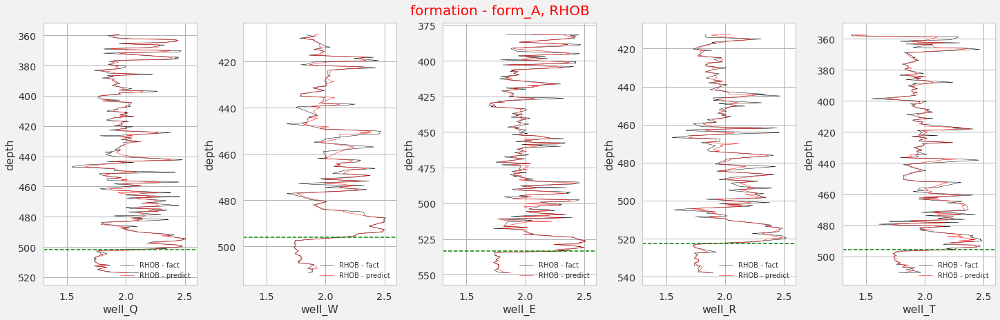

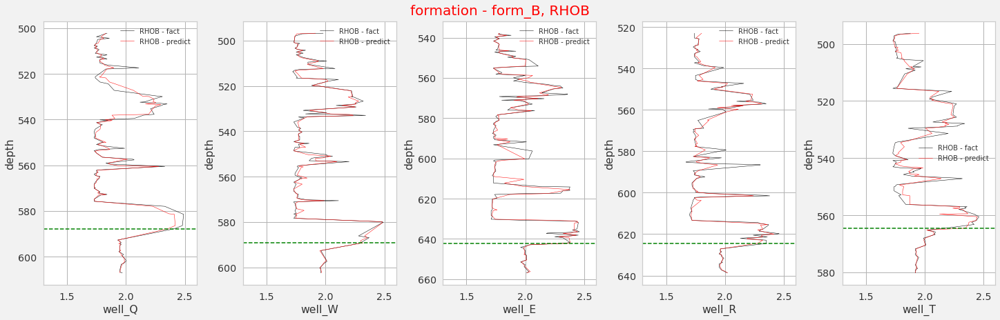

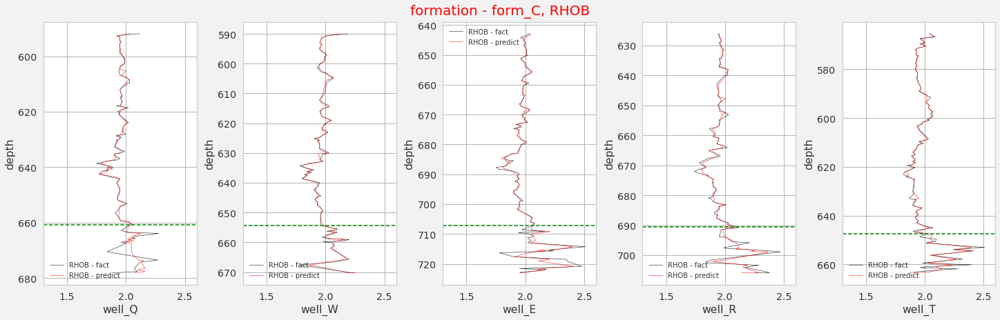

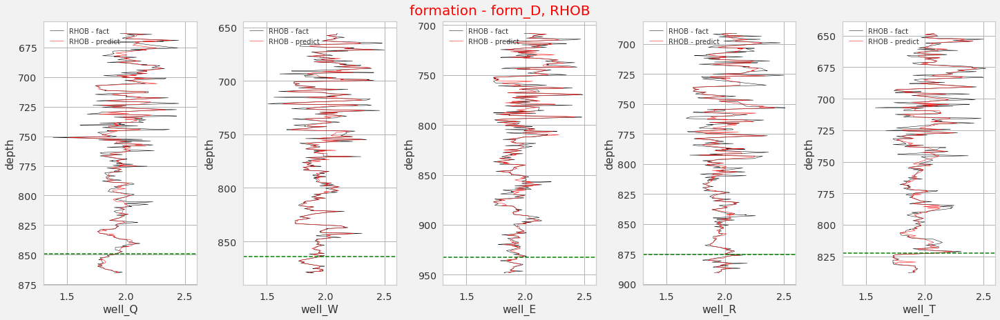

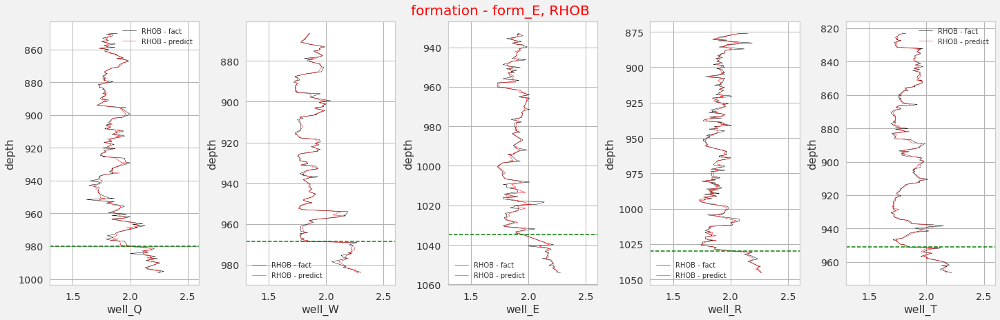

...

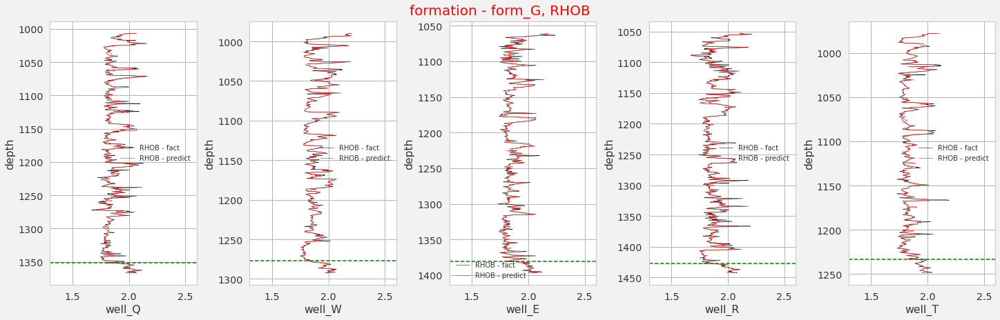

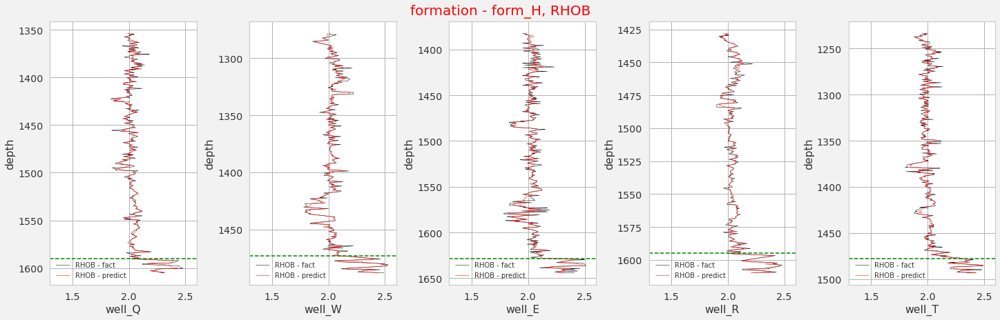

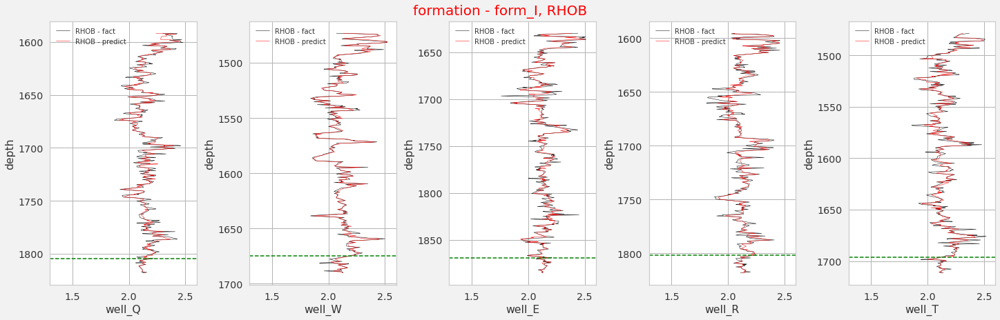

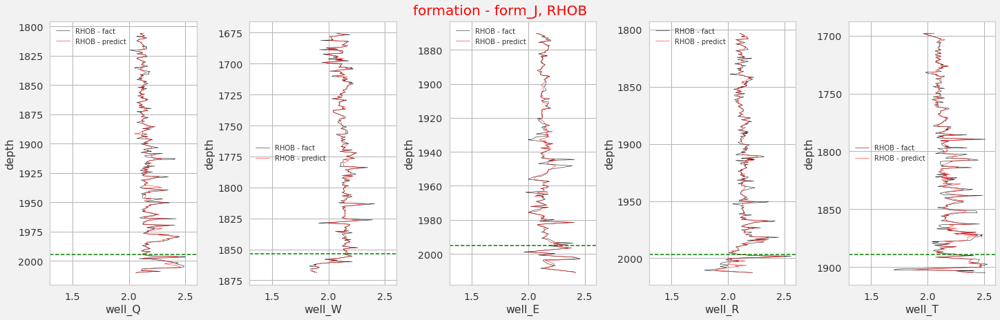

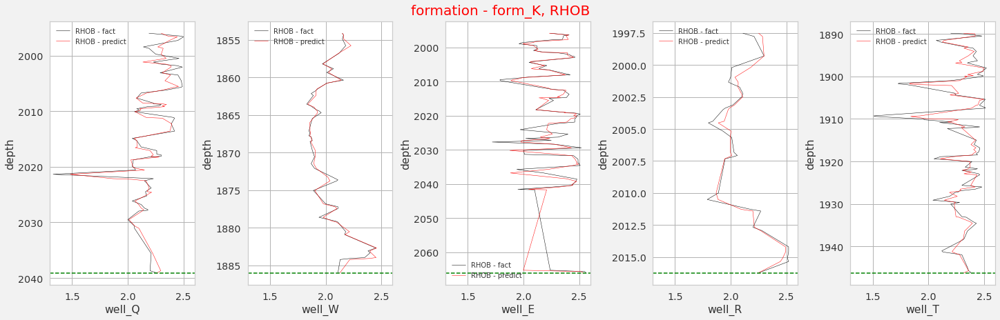

In [297]:
fun_vizual_GIS(GIS_predict_RHOB, formation_list, wells, 1.3, 2.6,'RHOB', 'RHOB_predict')   

## DTC

### best models selection

In [298]:
summary_final_DTC = pd.DataFrame(index= formation_list)

for column, best_models_names, best_models_score in zip(GIS_column_list, GIS_models, GIS_model_score):
    temp_X_train = X_train_GIS.loc[X_train_GIS.loc[:, column] == 1]
    temp_y_train = y_train_GIS.loc[y_train_GIS.loc[:, column] == 1]
    temp_X_test  =  X_test_GIS.loc[X_test_GIS.loc[ :, column] == 1]
    temp_y_test  =  y_test_GIS.loc[y_test_GIS.loc[ :, column] == 1]

    summary = fun_predict_GIS(temp_X_train, temp_X_test, 
                             temp_y_train, temp_y_test,
                             GIS_drilling_param_train, 
                             formation_list, 
                             'DTC', 
                             list_models,
                             best_models_names, best_models_score)
    
    summary_final_DTC = pd.merge(summary_final_DTC, summary, left_index=True, right_index=True)


In [299]:
summary_final_DTC

,no_cln_7_feat,no_cln_7_feat_scr,cln_7_feat,cln_7_feat_scr
form_A,RandomForestRegressor,0.880582,RandomForestRegressor,0.869445
form_B,CatBoostRegressor,0.899482,RandomForestRegressor,0.870835
form_C,RandomForestRegressor,0.910833,CatBoostRegressor,0.8476
form_D,RandomForestRegressor,0.867486,RandomForestRegressor,0.865869
form_E,RandomForestRegressor,0.934438,RandomForestRegressor,0.919249
form_F,CatBoostRegressor,0.826821,CatBoostRegressor,0.813003
form_G,RandomForestRegressor,0.905647,RandomForestRegressor,0.900436
form_H,RandomForestRegressor,0.894846,RandomForestRegressor,0.898098
form_I,RandomForestRegressor,0.827952,RandomForestRegressor,0.809058
form_J,RandomForestRegressor,0.805674,RandomForestRegressor,0.776777


In [300]:
summary_final_DTC_short = summary_final_DTC[['no_cln_7_feat_scr', 'cln_7_feat_scr']]
new_table_summary_DTC = pd.DataFrame(index = formation_list)

In [301]:
summary_final_DTC_short

,no_cln_7_feat_scr,cln_7_feat_scr
form_A,0.880582,0.869445
form_B,0.899482,0.870835
form_C,0.910833,0.8476
form_D,0.867486,0.865869
form_E,0.934438,0.919249
form_F,0.826821,0.813003
form_G,0.905647,0.900436
form_H,0.894846,0.898098
form_I,0.827952,0.809058
form_J,0.805674,0.776777


In [302]:
summary_final_DTC_short = summary_final_DTC_short[['no_cln_7_feat_scr', 'cln_7_feat_scr']].astype('float')

In [303]:
summary_final_DTC_short

,no_cln_7_feat_scr,cln_7_feat_scr
form_A,0.880582,0.869445
form_B,0.899482,0.870835
form_C,0.910833,0.847600
form_D,0.867486,0.865869
form_E,0.934438,0.919249
form_F,0.826821,0.813003
form_G,0.905647,0.900436
form_H,0.894846,0.898098
form_I,0.827952,0.809058
form_J,0.805674,0.776777


In [304]:
# DTC

for formation in formation_list:
  best_model = summary_final_DTC_short.loc[formation, :].idxmax(axis = 1) 
  
  if best_model == 'cln_7_feat_scr':
    new_table_summary_DTC.loc[formation, 'model_7_feat'] = summary_final_DTC.loc[formation, 'cln_7_feat']
    new_table_summary_DTC.loc[formation, 'score_7_feat'] = summary_final_DTC.loc[formation, 'cln_7_feat_scr']
    new_table_summary_DTC.loc[formation, 'cln_7_feat'] = 'yes'
  else:
    new_table_summary_DTC.loc[formation, 'model_7_feat'] = summary_final_DTC.loc[formation, 'no_cln_7_feat']
    new_table_summary_DTC.loc[formation, 'score_7_feat'] = summary_final_DTC.loc[formation, 'no_cln_7_feat_scr']
    new_table_summary_DTC.loc[formation, 'cln_7_feat'] = 'no'

In [305]:
new_table_summary_DTC

,model_7_feat,score_7_feat,cln_7_feat
form_A,RandomForestRegressor,0.880582,no
form_B,CatBoostRegressor,0.899482,no
form_C,RandomForestRegressor,0.910833,no
form_D,RandomForestRegressor,0.867486,no
form_E,RandomForestRegressor,0.934438,no
form_F,CatBoostRegressor,0.826821,no
form_G,RandomForestRegressor,0.905647,no
form_H,RandomForestRegressor,0.898098,yes
form_I,RandomForestRegressor,0.827952,no
form_J,RandomForestRegressor,0.805674,no


### list of the best models for prediction

In [306]:
model_7_feat_GIS = new_table_summary_DTC['model_7_feat'].tolist()
cln_7_feat_GIS   = new_table_summary_DTC['cln_7_feat'].tolist()

In [307]:
model_7_feat_GIS

['RandomForestRegressor',
 'CatBoostRegressor',
 'RandomForestRegressor',
 'RandomForestRegressor',
 'RandomForestRegressor',
 'CatBoostRegressor',
 'RandomForestRegressor',
 'RandomForestRegressor',
 'RandomForestRegressor',
 'RandomForestRegressor',
 'RandomForestRegressor']

In [308]:
cln_7_feat_GIS

['no', 'no', 'no', 'no', 'no', 'no', 'no', 'yes', 'no', 'no', 'no']

In [309]:
best_models_models_7_GIS = fun_models_best(model_7_feat_GIS, names_models_dict)

In [310]:
best_models_models_7_GIS

[RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                       max_depth=None, max_features='auto', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=None, oob_score=False,
                       random_state=None, verbose=0, warm_start=False),
 RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                       max_depth=None, max_features='auto', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=None, oob_score=False,
                       random_state=None, verbose=0, warm_star

### RHOB predict

In [311]:
GIS_predict_DTC = fun_predict_prob_GIS(X_train_GIS, y_train_GIS, X_test_GIS, y_test_GIS,
                                  formation_list,
                                  best_models_models_7_GIS,
                                  cln_7_feat_GIS, 
                                  'clean_5',            
                                  GIS_drilling_param_train, 
                                  'DTC_predict',
                                  'DTC')

In [312]:
GIS_predict_DTC

,MD,MD_form,Well,Formation,RHOB,DTC,GR,clusters,no_clean,clean_5,form_GIS_train,DTC_predict
53720,357.27,0.31,well_T,form_A,1.38,47.43,15.40,0.0,1,1,form_A,56.5195
53723,357.66,0.77,well_T,form_A,1.39,48.84,15.81,0.0,1,1,form_A,49.0906
53727,358.18,1.38,well_T,form_A,1.38,54.60,17.02,0.0,1,1,form_A,60.5595
53733,358.96,2.29,well_T,form_A,2.29,45.10,13.26,0.0,1,1,form_A,54.7662
4,359.35,0.61,well_Q,form_A,1.95,81.00,26.59,0.0,1,0,form_A,77.0339
...,...,...,...,...,...,...,...,...,...,...,...,...
67702,2041.55,53.76,well_E,form_K,1.95,66.79,28.10,3.0,1,1,form_K,70.2597
67703,2041.68,53.92,well_E,form_K,2.10,60.10,21.38,0.0,1,1,form_K,63.8090
67754,2065.24,81.63,well_E,form_K,2.24,83.85,55.58,1.0,1,1,form_K,75.4722
67757,2065.63,82.09,well_E,form_K,2.55,52.54,51.93,0.0,1,0,form_K,52.8231


### Visualization

In [313]:
GIS_predict_DTC['DTC_predict'].max(), GIS_predict_DTC['DTC_predict'].min()

(133.5510999999999, 38.75860000000004)

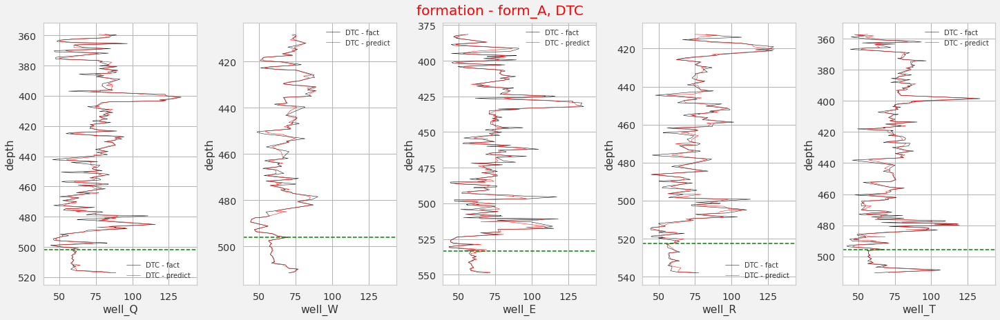

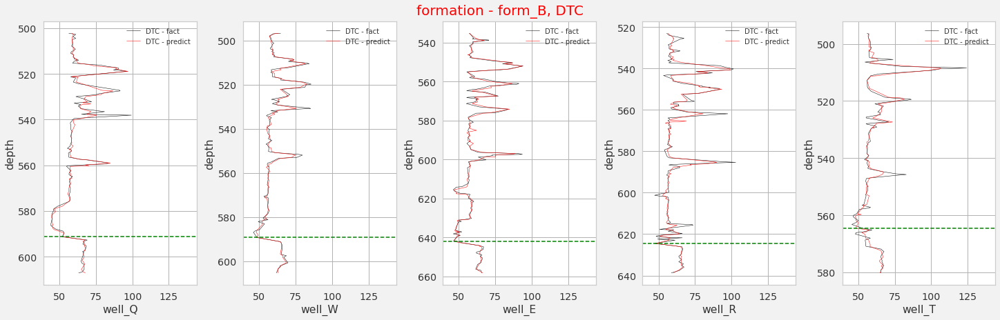

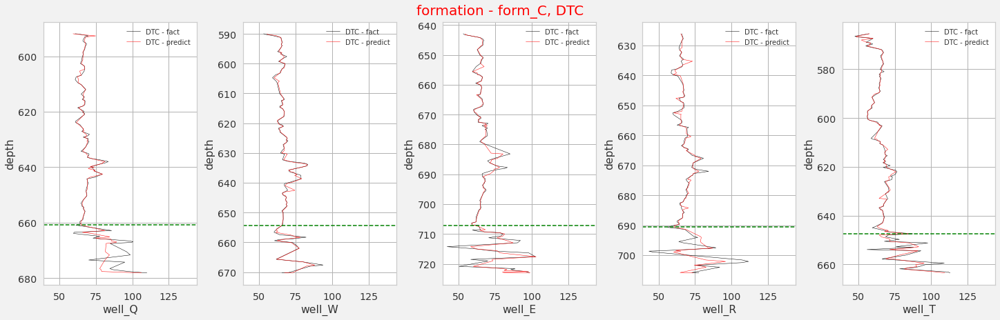

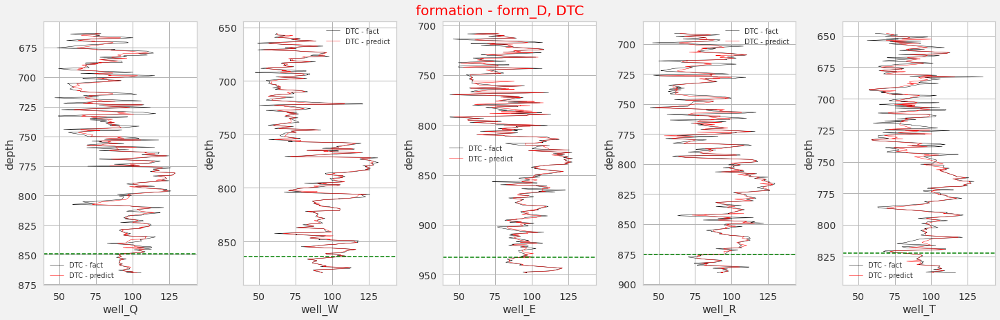

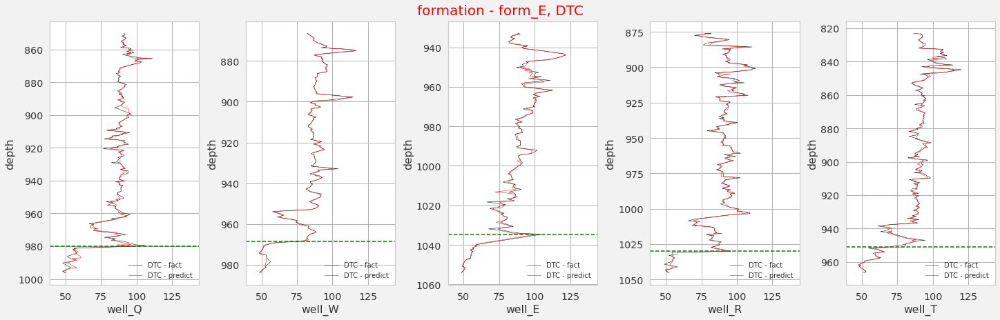

...

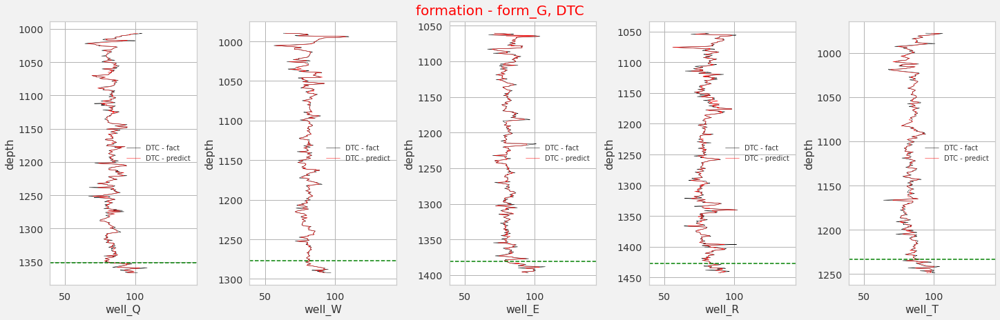

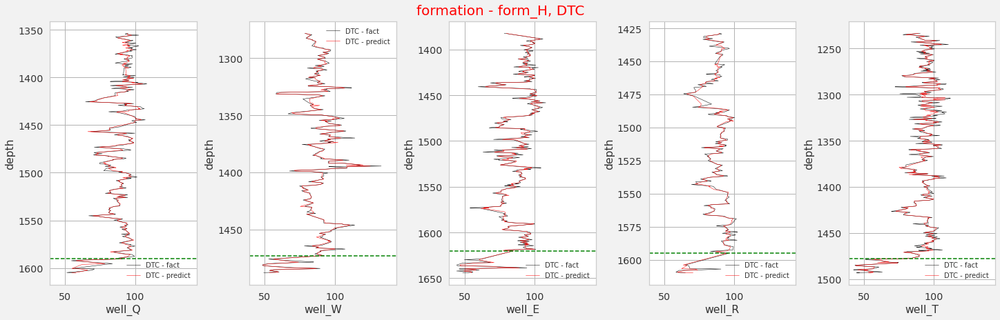

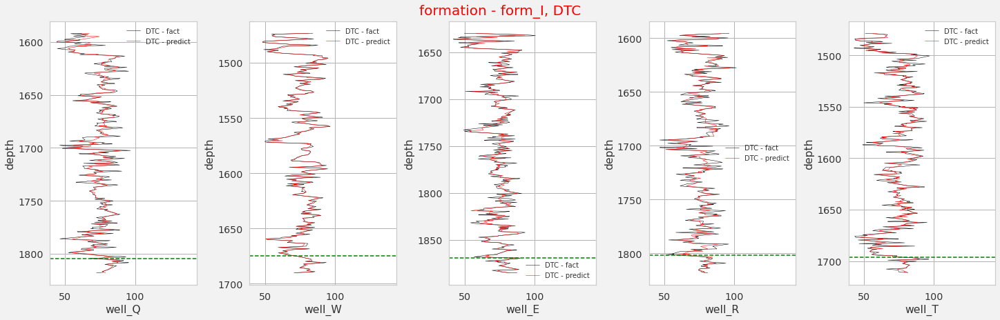

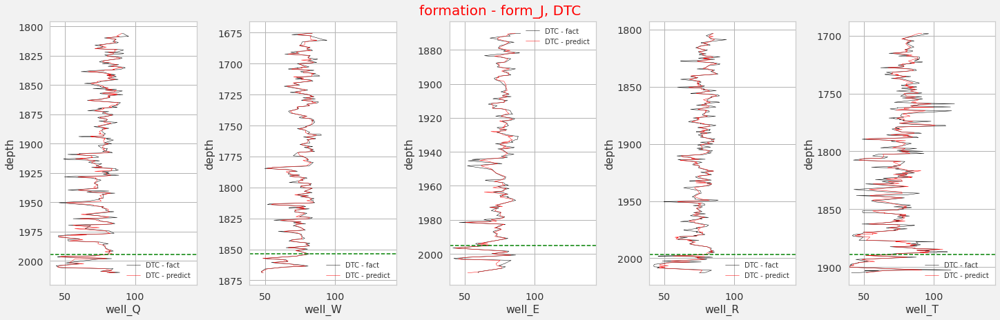

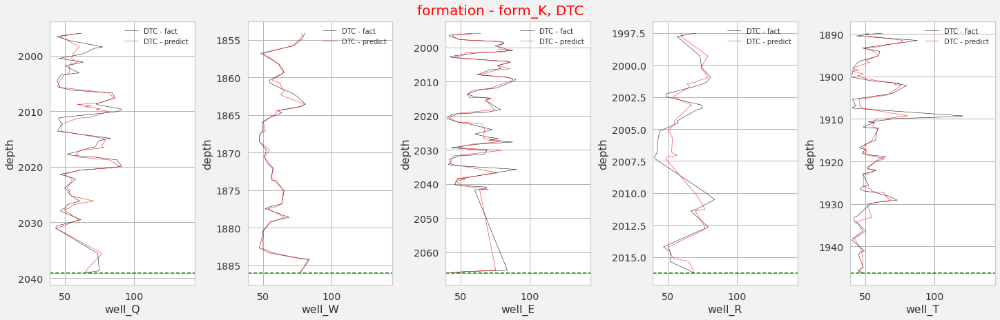

In [314]:
fun_vizual_GIS(GIS_predict_DTC, formation_list, wells, 39, 144,'DTC', 'DTC_predict')   

# PSO

### functions

In [18]:
# PSO 
def fun_pso_obj(x):
    if x[2] > 0.04:  # it's WOB with min limit in order to exclude unphysical values generated
        s = model.predict([x])
        return -s
    s = 1000000 # if WOB is less than condition above
    return s

In [19]:
# collec data for table with recommendations 
def fun_pso_curr(TOP, BOT, data, formation, well):
    curr = {
            'Index_top': TOP,
            'Index_bot' : BOT,
            'MD_top'   : data.loc[TOP, 'MD'],
            'MD_bot'    : data.loc[BOT, 'MD'],
            'MD_form_top' : data.loc[TOP, 'MD_form'], 
            'MD_form_bot'  : data.loc[BOT, 'MD_form'],
            # limits for intervals
            'SPP_min_int'  : procent_P50.loc['P50', 'SPP']*0.975,
            'SPP_max_int'  : procent_P50.loc['P50', 'SPP']*1.025,
            'WOB_min_int'  : min_max_int.loc['min', 'WOB'],
            'WOB_max_int'  : min_max_int.loc['max', 'WOB'],
            'RPM_min_int'  : procent_P50.loc['P50', 'RPM']*0.975,
            'RPM_max_int'  : procent_P50.loc['P50', 'RPM']*1.025,
            'SPP_P50'      : procent_P50.loc['P50', 'SPP'], 
            'RPM_P50'      : procent_P50.loc['P50', 'RPM'], 
            # general information
            'Formation'       : formation,
            'Well'            : well}
    return curr


In [20]:
# low and high limits for inputs generation
def fun_pso_lb(curr):
    lb = [procent_P50.loc['P50', 'SPP']*0.975, # x[0] - SPP
          procent_P50.loc['P50', 'RPM']*0.975, # x[1] - RPM
          curr['WOB_min_int']]                 # x[2] - WOB 
    return lb
def fun_pso_ub(curr):
    ub = [procent_P50.loc['P50', 'SPP']*1.025, 
          procent_P50.loc['P50', 'RPM']*1.025, 
          curr['WOB_max_int']] 
    return ub

In [21]:
# fill table with obtained results
def fun_pso_curr_2(xopt,fopt):
    # sometimes I got "fopt" in wrong type and it breaks calculations 
    # fixed as follows:  
    result = isinstance(fopt, np.ndarray)
    if result == True:
        fopt = fopt[0]
    ########################
    curr_2 = {'SPP_pso' : xopt[0].round(0),
              'RPM_pso' : xopt[1].round(1),
              'WOB_pso' : xopt[2].round(2),
              'ROP_pso' : -fopt.round(0) }
    return curr_2

In [22]:
# fill table for visualization 
def fun_pso_temp_filling(data):
    # min max for each interval
    data.loc[:, 'SPP_min_int'] = curr['SPP_min_int']
    data.loc[:, 'SPP_max_int'] = curr['SPP_max_int']
    data.loc[:, 'WOB_min_int'] = curr['WOB_min_int']
    data.loc[:, 'WOB_max_int'] = curr['WOB_max_int']
    data.loc[:, 'RPM_min_int'] = curr['RPM_min_int']
    data.loc[:, 'RPM_max_int'] = curr['RPM_max_int']
    # results of PSO
    data.loc[:, 'SPP_pso'] = curr_2['SPP_pso']
    data.loc[:, 'RPM_pso'] = curr_2['RPM_pso']
    data.loc[:, 'WOB_pso'] = curr_2['WOB_pso']
    data.loc[:, 'ROP_pso'] = curr_2['ROP_pso']
    return data

In [23]:
# compute Р50 for interval
def fun_pso_procent(data):
  procent_P50 = pd.DataFrame(index = ['P50'], columns = ('SPP', 'RPM'))
  procent_P50.loc['P50', 'SPP'] = data['SPP'].quantile(0.5)
  procent_P50.loc['P50', 'RPM'] = data['RPM'].quantile(0.5)
  return procent_P50

In [24]:
# compute limits 2.5 and 97.5%.
def fun_pso_wo_outers_2(data, drill_param):
  min_max_int = pd.DataFrame(index = ('min', 'max'), columns = ('SPP', 'RPM', 'WOB'))
  for parameter in drill_param:
    min_max_int.loc['min', parameter] = data[parameter].quantile(0.5 - 0.975/2)
    min_max_int.loc['max', parameter] = data[parameter].quantile(0.5 + 0.975/2)
  return min_max_int

## load pre-trained models for PSO

In [25]:
# load list of models

def fun_list_of_model_upload(address, list_models):
  best_model_list_big = []

  import csv
  dd = open(f'/content/drive/My Drive/ROP/{address}/{list_models}.csv')
  csv_reader = csv.reader(dd)

  for line in csv_reader:
    best_model_list_big.append(line[0])

  return best_model_list_big

In [26]:
best_model_list_3_param = fun_list_of_model_upload('!_ROP_final_code/section_16_results', 'model_3_feat_long')

In [27]:
best_model_list_3_param

['RandomForestRegressor_form_A.joblib',
 'RandomForestRegressor_form_B.joblib',
 'RandomForestRegressor_form_C.joblib',
 'RandomForestRegressor_form_D.joblib',
 'RandomForestRegressor_form_E.joblib',
 'CatBoostRegressor_form_F.joblib',
 'RandomForestRegressor_form_G.joblib',
 'RandomForestRegressor_form_H.joblib',
 'RandomForestRegressor_form_I.joblib',
 'RandomForestRegressor_form_J.joblib',
 'CatBoostRegressor_form_K.joblib']

In [28]:
# load pre-trained models

def fun_model_upload(address, list_of_models):
  models_trained = []

  for model_name in list_of_models:
    models_trained.append(joblib.load(f'/content/drive/My Drive/ROP/{address}/{model_name}'))
  
  return models_trained

In [29]:
models_trained_3 = fun_model_upload('!_ROP_final_code/section_16_models/models_article/models_3_features', best_model_list_3_param)

In [30]:
models_trained_3

[RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                       max_depth=None, max_features='auto', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=None, oob_score=False,
                       random_state=None, verbose=0, warm_start=False),
 RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                       max_depth=None, max_features='auto', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=None, oob_score=False,
                       random_state=None, verbose=0, warm_star

## calculations

In [31]:
section_cl =  pd.read_csv('/content/drive/My Drive/ROP/!_ROP_final_code/section_16_data/section_prob_art.csv')

In [32]:
drilling_param_train_3 = ['SPP', 'RPM', 'WOB'] 

In [33]:
section_pso = pd.DataFrame()
# ---------- set the length of the interval --------------------
N = 150        #(150 rows ~ 22 m)

# ---------- set number of iterations for PSO --------------------
Max_Iter = 50  

# template for table with recommendations
table_recomendation = pd.DataFrame(columns = ('Index_top', 'Index_bot',
                                             'MD_top', 'MD_bot',
                                             'MD_form_top', 'MD_form_bot',
                                             'SPP_min_int', 'SPP_max_int',
                                             'WOB_min_int', 'WOB_max_int',
                                             'RPM_min_int', 'RPM_max_int',
                                             'Formation', 'Well', 
                                             'SPP_P50', 'RPM_P50'
                                              ))

for formation, model in zip(formation_list, models_trained_3):
  temp_1 = section_cl.query('Formation == @formation')

  for well in wells:
    temp_2 = temp_1.query('Well == @well').reset_index(drop=True)
    QQQ = len(temp_2) // N
 # *********************************************************************************************   
    # for cases when interval is less than 150 rows or there are just 2 intervals in formation
    if QQQ == 1 or QQQ == 0: 
      TOP = 0
      BOT = len(temp_2)-1
      temp_3 = temp_2.loc[TOP:BOT, :]

      min_max_int = fun_pso_wo_outers_2(temp_3, drilling_param_train_3)
      procent_P50 = fun_pso_procent(temp_3)
      curr        = fun_pso_curr(TOP, BOT, temp_3, formation, well)
      lb          = fun_pso_lb(curr)                       
      ub          = fun_pso_ub(curr)
      xopt, fopt  = pso(fun_pso_obj, lb, ub, maxiter = Max_Iter)
      curr_2      = fun_pso_curr_2(xopt, fopt)
      curr_final  = {**curr, **curr_2}
      table_recomendation = table_recomendation.append(curr_final, ignore_index=True)
      temp_3        = fun_pso_temp_filling(temp_3)
      section_pso = pd.concat([section_pso, temp_3])

    else:
      A = -1
      
      for i in range(0, len(temp_2), N):
        A = A+1
        if A == QQQ-1:  
          TOP = (QQQ-1)*N
          BOT = (QQQ-1)*N + (len(temp_2) - (QQQ-1)*N)-1
          temp_3 = temp_2.loc[TOP:BOT, :]
          
          min_max_int = fun_pso_wo_outers_2(temp_3, drilling_param_train_3)
          procent_P50 = fun_pso_procent(temp_3)
          curr        = fun_pso_curr(TOP, BOT, temp_3, formation, well)
          lb          = fun_pso_lb(curr)                       
          ub          = fun_pso_ub(curr)
          xopt, fopt  = pso(fun_pso_obj, lb, ub, maxiter = Max_Iter)
          curr_2      = fun_pso_curr_2(xopt, fopt)
          curr_final  = {**curr, **curr_2}
          table_recomendation = table_recomendation.append(curr_final, ignore_index=True)
          temp_3        = fun_pso_temp_filling(temp_3)
          section_pso = pd.concat([section_pso, temp_3])
            
        
        else:
          if A < QQQ:
            TOP = i
            BOT = i+N 
            temp_3 = temp_2.loc[TOP:BOT, :]
            print(formation, well, QQQ)
            min_max_int = fun_pso_wo_outers_2(temp_3, drilling_param_train_3)
            procent_P50 = fun_pso_procent(temp_3)
            curr        = fun_pso_curr(TOP, BOT, temp_3, formation, well)
            lb          = fun_pso_lb(curr)                       
            ub          = fun_pso_ub(curr)
            xopt, fopt  = pso(fun_pso_obj, lb, ub, maxiter = Max_Iter)
            curr_2      = fun_pso_curr_2(xopt, fopt)
            curr_final  = {**curr, **curr_2}
            table_recomendation = table_recomendation.append(curr_final, ignore_index=True)
            temp_3        = fun_pso_temp_filling(temp_3)
            section_pso = pd.concat([section_pso, temp_3])

form_A well_Q 7
Stopping search: maximum iterations reached --> 50
form_A well_Q 7


KeyboardInterrupt: ignored

In [ ]:
section_pso

,MD,LM,LM_DLM,DLM,DLM_C,E_GA,E_KMN,EXTR,SHC,SHS,SILT,UNS,SND,GR,DTC,RHOB,SPP,ROP,Torque,RPM,WOB,Formation,Well,MD_form,label,clusters,SPP_prb,ROP_prb,Torque_prb,RPM_prb,WOB_prb,SPP_prb_vld,ROP_prb_vld,Torque_prb_vld,RPM_prb_vld,WOB_prb_vld,clean_5,clean_4,clean_3,no_clean,SPP_min_int,SPP_max_int,WOB_min_int,WOB_max_int,RPM_min_int,RPM_max_int,SPP_pso,RPM_pso,WOB_pso,ROP_pso
0,358.83,0.49,0.0,0.0,38.77,55.00,0.0,0.0,5.74,0.0,0.0,0.0,0.0,15.46,58.20,2.35,627.62,0.46,1601.82,48.97,9.50,form_A,well_Q,0.00,2,2.0,0.000008,0.005608,0.000151,0.002028,0.051914,0,1,1,0,1,0,0,0,1,1179.447750,1239.932250,0.000,12.93000,83.1285,87.3915,1208.0,87.4,4.70,28.0
1,358.96,1.00,0.0,0.0,37.50,55.00,0.0,0.0,6.50,0.0,0.0,0.0,0.0,20.07,63.45,2.22,406.22,0.78,870.23,38.25,3.25,form_A,well_Q,0.15,2,2.0,0.000252,0.006098,0.000082,0.001618,0.096730,0,1,1,0,1,0,0,0,1,1179.447750,1239.932250,0.000,12.93000,83.1285,87.3915,1208.0,87.4,4.70,28.0
2,359.08,1.51,0.0,0.0,36.22,55.00,0.0,0.0,7.26,0.0,0.0,0.0,0.0,24.11,69.39,2.07,392.69,2.40,765.67,33.05,2.21,form_A,well_Q,0.30,0,0.0,0.000284,0.008120,0.000072,0.001116,0.073416,0,1,1,0,1,0,0,0,1,1179.447750,1239.932250,0.000,12.93000,83.1285,87.3915,1208.0,87.4,4.70,28.0
3,359.21,2.02,0.0,0.0,34.96,55.00,0.0,0.0,8.02,0.0,0.0,0.0,0.0,26.26,75.44,1.95,388.57,2.86,742.12,34.66,2.54,form_A,well_Q,0.45,0,0.0,0.000289,0.008548,0.000070,0.001264,0.081929,0,1,1,0,1,0,0,0,1,1179.447750,1239.932250,0.000,12.93000,83.1285,87.3915,1208.0,87.4,4.70,28.0
4,359.35,2.52,0.0,0.0,33.69,55.00,0.0,0.0,8.78,0.0,0.0,0.0,0.0,26.59,81.00,1.95,388.62,2.73,752.28,39.10,3.42,form_A,well_Q,0.61,0,0.0,0.000289,0.008432,0.000071,0.001723,0.099535,0,1,1,0,1,0,0,0,1,1179.447750,1239.932250,0.000,12.93000,83.1285,87.3915,1208.0,87.4,4.70,28.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
435,1945.95,0.00,0.0,0.0,0.00,83.53,0.0,0.0,16.47,0.0,0.0,0.0,0.0,12.66,45.03,2.36,1938.12,4.06,9502.70,118.46,15.23,form_K,well_T,66.29,2,2.0,0.001520,0.183603,0.000192,0.049112,0.504936,0,1,1,1,1,0,0,1,1,1926.760875,2025.569125,12.049,15.90775,119.3400,125.4600,1996.0,125.1,12.05,6.0
436,1946.08,0.00,0.0,0.0,0.00,85.05,0.0,0.0,14.95,0.0,0.0,0.0,0.0,13.21,45.92,2.38,1939.74,4.99,10074.40,116.45,15.14,form_K,well_T,66.45,2,2.0,0.001648,0.103803,0.000135,0.039694,0.523024,0,1,1,1,1,0,0,1,1,1926.760875,2025.569125,12.049,15.90775,119.3400,125.4600,1996.0,125.1,12.05,6.0
437,1946.21,0.00,0.0,0.0,0.00,86.58,0.0,0.0,13.42,0.0,0.0,0.0,0.0,13.68,47.20,2.37,1925.84,4.16,10005.49,116.45,15.27,form_K,well_T,66.60,2,2.0,0.000823,0.173585,0.000143,0.039694,0.492609,0,1,1,1,1,0,0,1,1,1926.760875,2025.569125,12.049,15.90775,119.3400,125.4600,1996.0,125.1,12.05,6.0
438,1946.34,0.00,0.0,0.0,0.00,88.10,0.0,0.0,11.90,0.0,0.0,0.0,0.0,14.70,48.70,2.33,1917.11,3.82,10054.68,116.04,15.36,form_K,well_T,66.75,2,2.0,0.000994,0.208394,0.000137,0.037510,0.456345,0,1,1,1,1,0,0,1,1,1926.760875,2025.569125,12.049,15.90775,119.3400,125.4600,1996.0,125.1,12.05,6.0


In [ ]:
table_recomendation

,Index_верх,Index_ниж,MD_верх,MD_низ,MD_form_верх,MD_form_низ,SPP_min_int,SPP_max_int,WOB_min_int,WOB_max_int,RPM_min_int,RPM_max_int,Formation,Well,SPP_P50,RPM_P50,ROP_pso,RPM_pso,SPP_pso,WOB_pso
0,0,150,358.83,378.26,0.00,22.86,1179.447750,1239.932250,0.00000,12.930000,83.128500,87.391500,form_A,well_Q,1209.690,85.260,28.0,87.4,1208.0,4.70
1,150,300,378.26,397.69,22.86,45.72,1184.166750,1244.893250,0.91750,10.620000,116.853750,122.846250,form_A,well_Q,1214.530,119.850,32.0,122.8,1184.0,6.75
2,300,450,397.69,417.12,45.72,68.58,1312.330500,1379.629500,1.04875,10.492500,120.168750,126.331250,form_A,well_Q,1345.980,123.250,34.0,125.5,1368.0,2.49
3,450,600,417.12,436.55,68.58,91.44,1293.844500,1360.195500,1.10375,15.351250,118.511250,124.588750,form_A,well_Q,1327.020,121.550,30.0,121.4,1331.0,5.87
4,600,750,436.55,455.98,91.44,114.30,1326.321750,1394.338250,0.86750,12.662500,118.511250,124.588750,form_A,well_Q,1360.330,121.550,33.0,124.1,1366.0,5.38
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
384,0,150,1995.85,2015.27,0.00,22.85,2047.314750,2152.305250,7.68500,13.761250,132.229500,139.010500,form_K,well_E,2099.810,135.620,24.0,133.9,2071.0,10.58
385,150,413,2015.27,2066.27,22.85,82.85,2018.269500,2121.770500,7.59875,13.254250,126.784125,133.285875,form_K,well_E,2070.020,130.035,25.0,130.6,2100.0,8.21
386,0,153,1997.51,2017.02,0.00,22.95,2403.428625,2526.681375,7.78825,17.637875,152.490000,160.310000,form_K,well_R,2465.055,156.400,24.0,157.3,2527.0,7.81
387,0,150,1889.60,1909.03,0.00,22.86,1923.236250,2021.863750,9.01000,15.493750,114.123750,119.976250,form_K,well_T,1972.550,117.050,10.0,117.1,1953.0,10.53


In [332]:
table_recomendation.loc[(table_recomendation.loc[:,'Well'] == 'well_E') & (table_recomendation.loc[:,'Formation'] == 'form_A')].drop(['SPP_min_int',
                                                                                                                                      'SPP_max_int',
                                                                                                                                      'WOB_min_int',
                                                                                                                                      'WOB_max_int',
                                                                                                                                      'RPM_min_int',
                                                                                                                                      'RPM_max_int',
                                                                                                                                      'SPP_P50','RPM_P50'], axis='columns')

,Index_верх,Index_ниж,MD_верх,MD_низ,MD_form_верх,MD_form_низ,Formation,Well,ROP_pso,RPM_pso,SPP_pso,WOB_pso
11,0,150,381.29,400.71,0.00,22.84,form_A,well_E,29.0,74.1,659.0,1.87
12,150,300,400.71,420.13,22.84,45.69,form_A,well_E,45.0,129.3,1175.0,5.54
13,300,450,420.13,439.54,45.69,68.53,form_A,well_E,43.0,129.2,1289.0,7.18
14,450,600,439.54,458.97,68.53,91.38,form_A,well_E,42.0,131.3,1433.0,4.62
15,600,750,458.97,478.38,91.38,114.22,form_A,well_E,43.0,136.3,1553.0,7.38
16,750,900,478.38,497.80,114.22,137.07,form_A,well_E,40.0,134.6,1493.0,8.96
17,900,1177,497.80,533.66,137.07,179.25,form_A,well_E,40.0,134.6,1493.0,8.95


## Visualization

### functions

In [344]:
# for logs

def fun_pso_results_vizual(data):
  fig = plt.figure(figsize=(50,8))

  # указать размерность - сколько будет графиков 
  gs1 = GridSpec(1, 22, left=0.05, right=0.95, hspace=0.05, wspace=0.1, width_ratios=[
                          0.4, 0.7, 1, 1, 1, 1, 1, 1, 1, 1, 1,1,1,1,1,1,1,1,1,1,1,1])
  #plt.tight_layout(fig)

  ax0 = fig.add_subplot(gs1[0,0]) # MD
  ax1 = fig.add_subplot(gs1[0,1], sharey=ax0) # GR # sharey - чтобы сетка была как в ах0
  ax2 = fig.add_subplot(gs1[0,2], sharey=ax0) # DTC 
  ax3 = fig.add_subplot(gs1[0,3], sharey=ax0) # RHOB
#-----------------------------------------------------------------------------------------------  
  ax4 = fig.add_subplot(gs1[0,4], sharey=ax0) # SPP
  #ax5 = ax4.twiny()                           # SPP - pso
  ax6 = ax4.twiny()                           # SPP - ограничение по интервалу - мин
  ax7 = ax4.twiny()                           # SPP - ограничение по интервалу - макс
#-----------------------------------------------------------------------------------------------
  ax8 = fig.add_subplot(gs1[0,5], sharey=ax0)  # Torque
  # ax10 = ax8.twiny()                           # Torque - predict
  #ax9 =  ax8.twiny()                           # Torque - pso
  # ax11 = ax8.twiny()                           # Torque - ограничение по интервалу - мин
  # ax12 = ax8.twiny()                           # Torque - ограничение по интервалу - макс
#-----------------------------------------------------------------------------------------------
  ax13 = fig.add_subplot(gs1[0,6], sharey=ax0)  # RPM
  #ax14 = ax13.twiny()                           # RPM - pso
  ax15 = ax13.twiny()                           # RPM - ограничение по интервалу - мин
  ax16 = ax13.twiny()                           # RPM - ограничение по интервалу - макс
#-----------------------------------------------------------------------------------------------
  ax17 = fig.add_subplot(gs1[0,7], sharey=ax0)  # WOB
  #ax18 = ax17.twiny()                           # WOB - pso
  ax19 = ax17.twiny()                           # WOB - ограничение по интервалу - мин
  ax20 = ax17.twiny()                           # WOB - ограничение по интервалу - макс
#-----------------------------------------------------------------------------------------------
  ax21 = fig.add_subplot(gs1[0,8], sharey=ax0) # ROP
  #ax22 = ax21.twiny()                          # ROP - pso
  
#-----------------------------------------------------------------------------------------------
  ax_list =    [ax1, ax2, ax3, ax4, ax8, ax13, ax17, ax21]
  track_list = [ax1, ax2, ax3, ax4, ax8, ax13, ax17, ax21] # линии сетки

############################ фон для всех графиков ############################################
  for ax in track_list:
    #ax.grid(True, color='0.8', dashes=(5,2,1,2))
    ax.grid(True, color='#EEEEEE', linestyle=':', linewidth=0.5)
    ax.set_facecolor('#ffffed')
  
  for ax in ax_list:
    plt.setp(ax.get_yticklabels(), visible = False)

  ############################ track 0: depth ############################################
  ax0.plot(np.zeros(len(data['MD'])), data['MD'], color='k', alpha=.1, lw=1, ls= '-') # по Х всё заполнили нулями
  
  ax0.tick_params(axis="y",direction="in", pad=-38)
  
  ax0.set_xlabel('MD(m)', fontsize = '12' )
  ax0.xaxis.set_label_position("top")
  ax0.set_xticklabels('')
  ax0.tick_params(axis='y', colors="lightyellow", labelsize=12)
  ax0.set_facecolor('k')
  ax0.set_xticks([0, 1])
  ax0.set_xlim(0, 1)
 ############################ track 1: GR ############################################
  ax1.plot(data['GR'], data['MD'], color='red', alpha=1, lw=0.4, ls= '-')
  ax1.fill_betweenx(data['MD'], data['GR'],0, facecolor='gray', alpha=.4)

  ax1.set_xlabel("Gamma Ray", fontsize = '8' )
  ax1.xaxis.set_label_position("top")
  ax1.xaxis.set_ticks_position("top")
  ax1.xaxis.label.set_color("g")
  
  ax1.set_xlim(0, 100)
 
  ax1.tick_params(axis='x', colors="g") # шкала по Х
  ax1.spines["top"].set_edgecolor("g") # цвет оси по Х
  ax1.spines["top"].set_position(("axes", 1.0)) # расстояние между именем и линией 
  ax1.set_xticks([0, 50, 100])    # шкала 
  ax1.tick_params(labelsize=8) # размер шрифта шкалы по Х
  ax1.invert_yaxis()           # переворот 
  
  ############################ tracks ЛОГИ  ############################################
  log_method(data, ax2, 'DTC', 'blue', 1.0, 'DTC', 'DTC')
  log_method(data, ax3, 'RHOB', 'blue', 1.0, 'RHOB', 'RHOB')
    
  ############################ tracks БУРЕНИЕ  ############################################
  
  # --------------------- SPP ---------------
  log_method(data, ax4, 'SPP',     'red',  1.0, 'SPP', 'SPP')
  #log_method(data, ax5, 'SPP_pso', 'blue', 1.1, 'SPP', 'SPP_pso')
  log_method(data, ax6, 'SPP_min_int', 'green', 1.1,'SPP', 'min - max')
  log_method(data, ax7, 'SPP_max_int', 'green', 1.1,'SPP', '')
  
  # --------------------- Torque ---------------
  log_method(data, ax8,  'Torque',     'red',  1.0,    'Torque', 'Torque')
  #log_method(data, ax9,  'Torque_avg_pso', 'blue', 1.1,    'Torque_avg', 'Torque_avg_pso')
  #log_method(data, ax10, 'Torque_predict', 'blue', 1.3, 'Torque_avg', 'Torque_predict')
  # log_method(data, ax11, 'Torque_min_int', 'green', 1.2,   'Torque_avg', 'min - max')
  # log_method(data, ax12, 'Torque_max_int', 'green', 1.2,   'Torque_avg', '')
  
  # --------------------- RPM ---------------
  log_method(data, ax13, 'RPM',     'red',  1.0,  'RPM', 'RPM')
  #log_method(data, ax14, 'RPM_pso', 'blue', 1.1,  'RPM', 'RPM_pso')
  log_method(data, ax15, 'RPM_min_int', 'green', 1.1, 'RPM', 'min - max')
  log_method(data, ax16, 'RPM_max_int', 'green', 1.1, 'RPM', '')
  
  # --------------------- WOB ---------------
  log_method(data, ax17, 'WOB',     'red',  1.0,  'WOB', 'WOB')
  #log_method(data, ax18, 'WOB_pso', 'blue', 1.1,  'WOB', 'WOB_pso')
  log_method(data, ax19, 'WOB_min_int', 'green', 1.1, 'WOB', 'min - max')
  log_method(data, ax20, 'WOB_max_int', 'green', 1.1, 'WOB', '')

  # --------------------- ROP ---------------
  log_method(data, ax21, 'ROP',     'red',  1.0, 'ROP', 'ROP')
  #log_method(data, ax22, 'ROP_pso', 'blue', 1.1, 'ROP', 'ROP_pso')
    



In [345]:
# subfunction for logs visualization

def log_method(data, number_plot, method, color, second, method_scale, legend):
  number_plot.plot(data[method], data['MD'], color=color, alpha=1, lw=0.8, ls= '-')

  number_plot.set_xlabel(legend, fontsize = '8' )
  number_plot.xaxis.set_label_position("top")
  number_plot.xaxis.set_ticks_position("top")
  number_plot.xaxis.label.set_color(color)
  
  number_plot.set_xlim(data[method_scale].min()*0.45, data[method_scale].max()*1.1)
  
  number_plot.tick_params(axis='x', colors=color) # шкала по Х
  number_plot.spines["top"].set_edgecolor(color) # цвет оси по Х
  number_plot.spines["top"].set_position(("axes", second)) # расстояние между именем и линией
  
  number_plot.tick_params(labelsize=7)    # размер шрифта шкалы по Х

In [338]:
# remove outliers detected in 2 features and ROP
proba =  section_pso.query('clean_3 == 1')

### well_Q

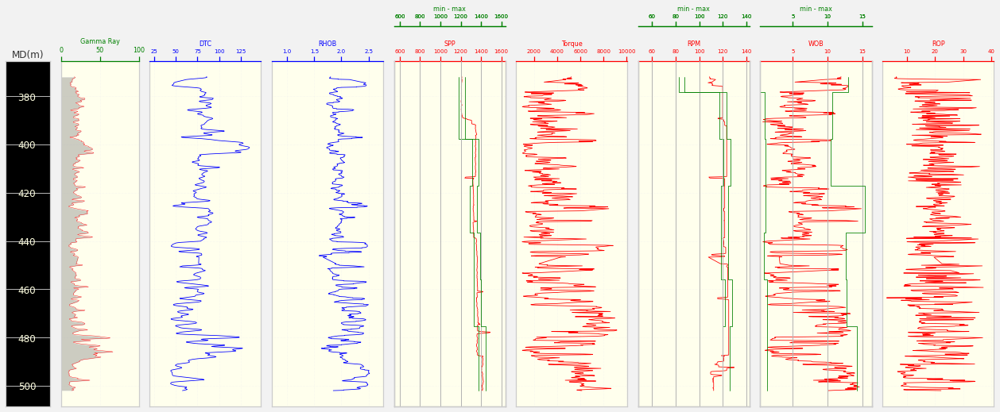

In [346]:
well_Q = proba.loc[(proba.loc[:,'Well'] == 'well_Q') & (proba.loc[:,'Formation'] == 'form_A')]
fun_pso_results_vizual(well_Q)

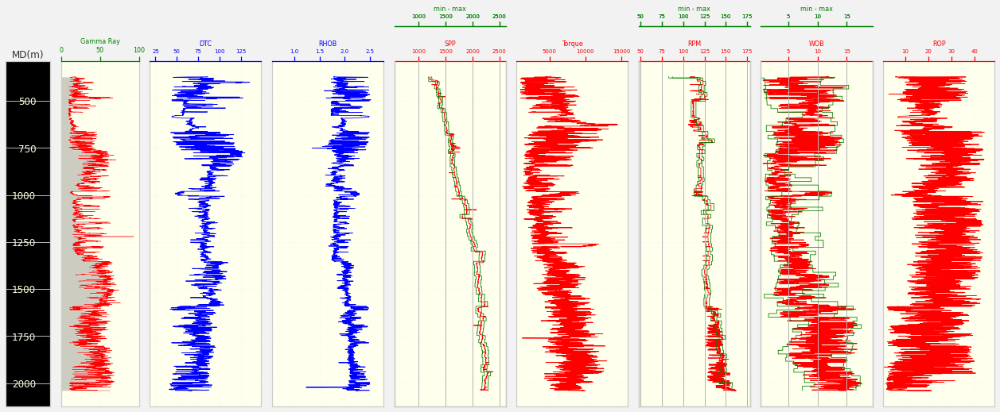

In [347]:
well_Q = proba.loc[(proba.loc[:,'Well'] == 'well_Q') ]
fun_pso_results_vizual(well_Q)

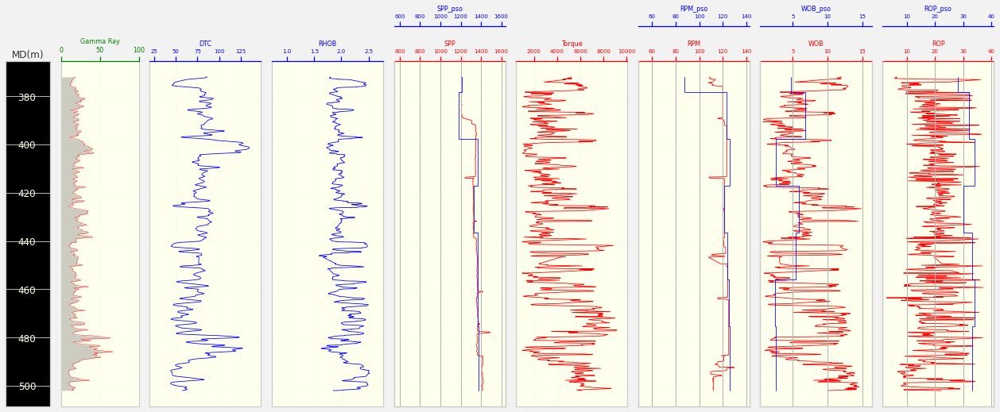

In [343]:
well_Q = proba.loc[(proba.loc[:,'Well'] == 'well_Q') & (proba.loc[:,'Formation'] == 'form_A')]
fun_pso_results_vizual(well_Q)

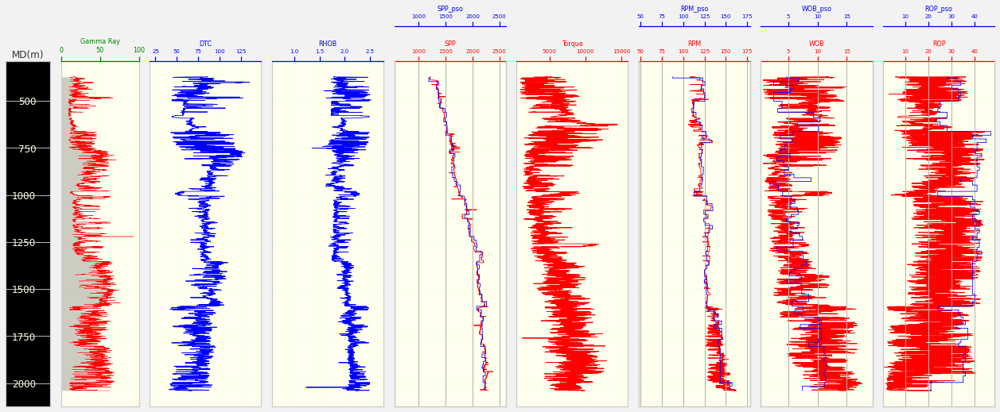

In [341]:
well_Q = proba.loc[(proba.loc[:,'Well'] == 'well_Q') ]
fun_pso_results_vizual(well_Q)

### well_W

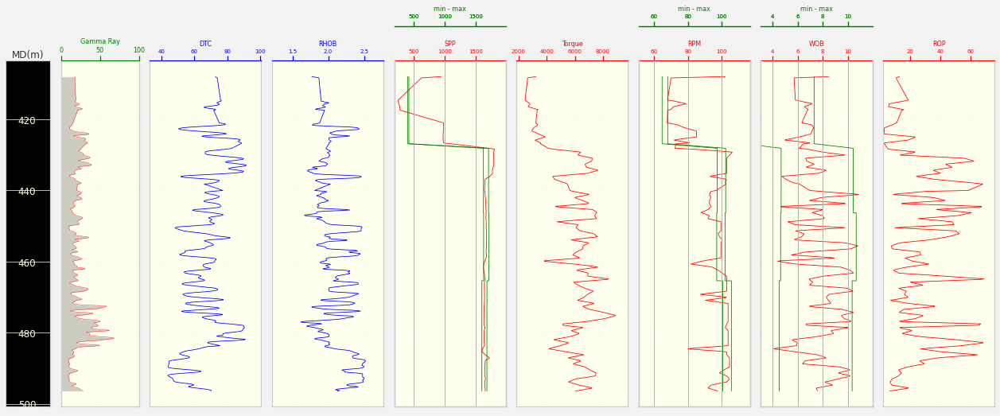

In [ ]:
well_W = proba.loc[(proba.loc[:,'Well'] == 'well_W') & (proba.loc[:,'Formation'] == 'form_A')]
fun_pso_results_vizual(well_W)

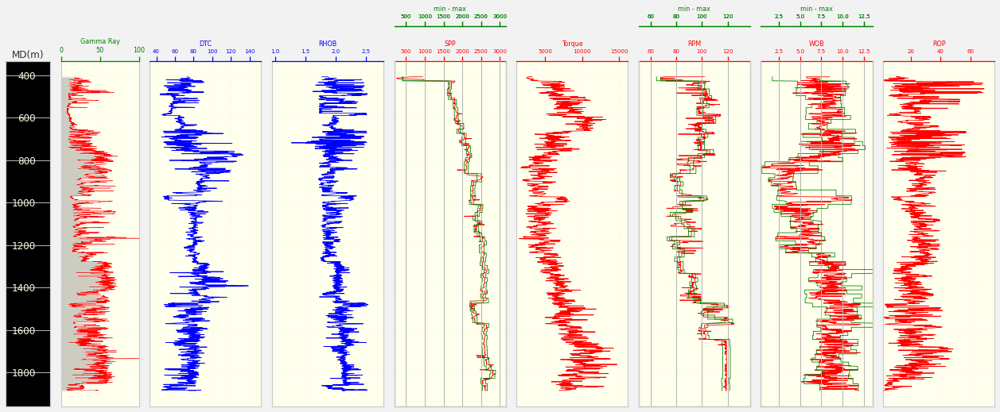

In [ ]:
well_W = proba.loc[(proba.loc[:,'Well'] == 'well_W') ]
fun_pso_results_vizual(well_W)

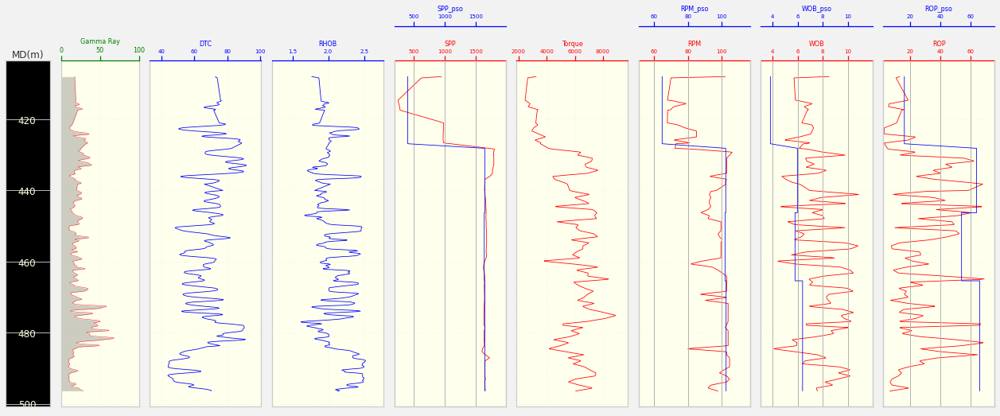

In [ ]:
well_W = proba.loc[(proba.loc[:,'Well'] == 'well_W') & (proba.loc[:,'Formation'] == 'form_A')]
fun_pso_results_vizual(well_W)

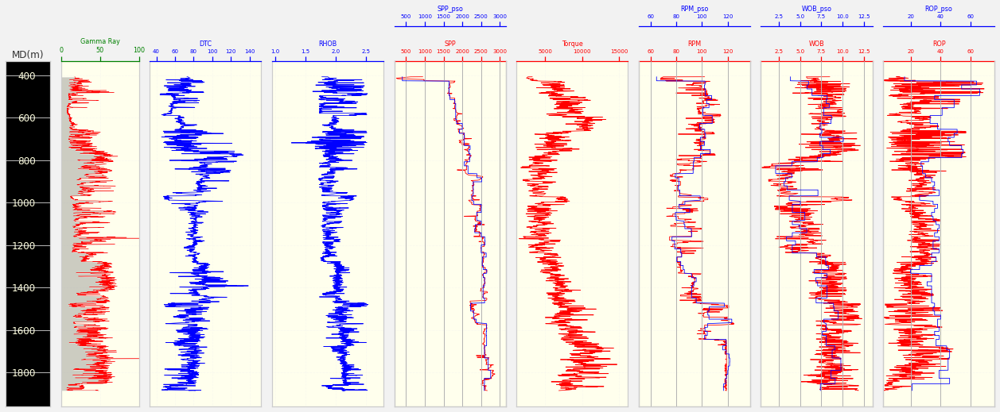

In [ ]:
well_W = proba.loc[(proba.loc[:,'Well'] == 'well_W') ]
fun_pso_results_vizual(well_W)

### well_E

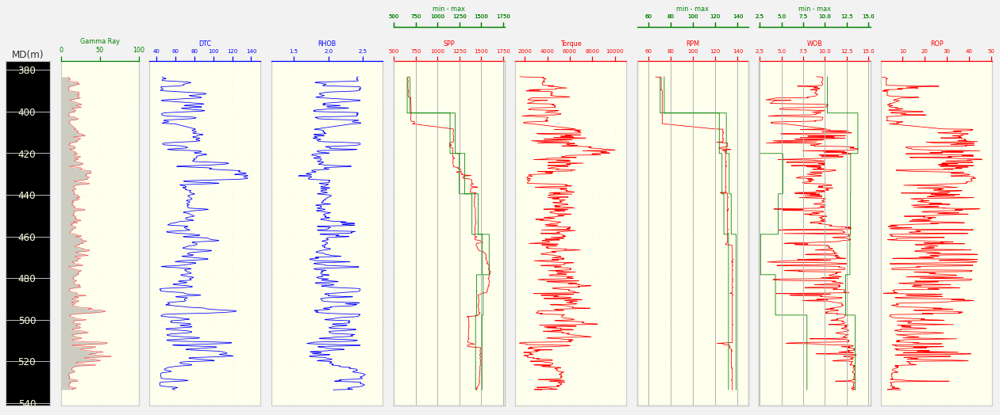

In [ ]:
well_E = proba.loc[(proba.loc[:,'Well'] == 'well_E') & (proba.loc[:,'Formation'] == 'form_A')]
fun_pso_results_vizual(well_E)

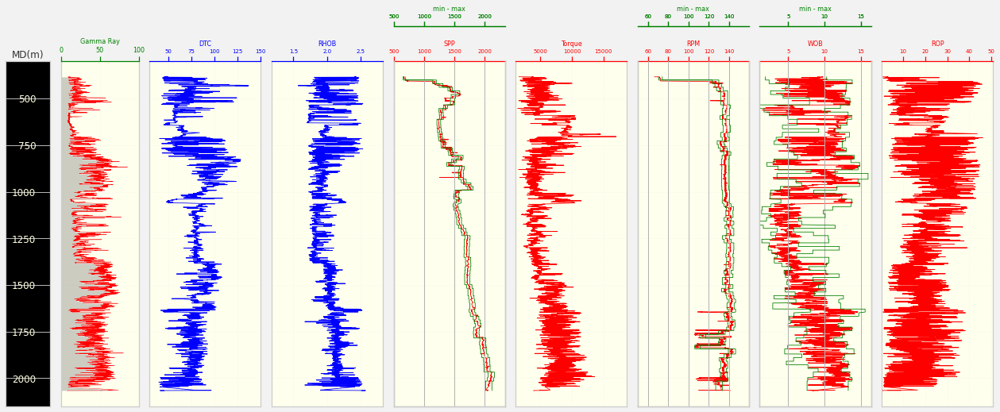

In [ ]:
well_E = proba.loc[(proba.loc[:,'Well'] == 'well_E') ]
fun_pso_results_vizual(well_E)

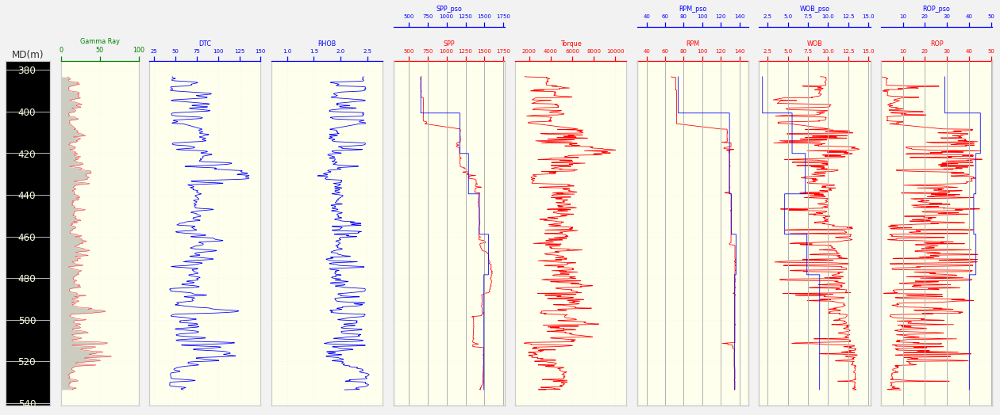

In [ ]:
well_E = proba.loc[(proba.loc[:,'Well'] == 'well_E') & (proba.loc[:,'Formation'] == 'form_A')]
fun_pso_results_vizual(well_E)

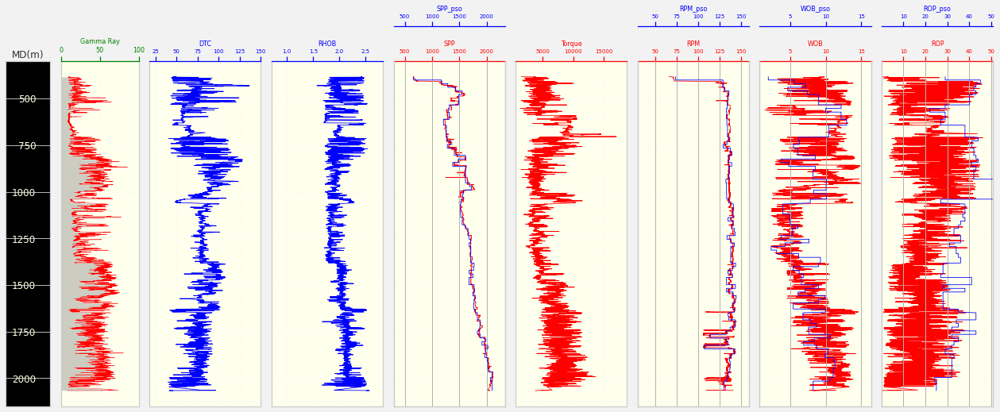

In [ ]:
well_E = proba.loc[(proba.loc[:,'Well'] == 'well_E') ]
fun_pso_results_vizual(well_E)

### well_R

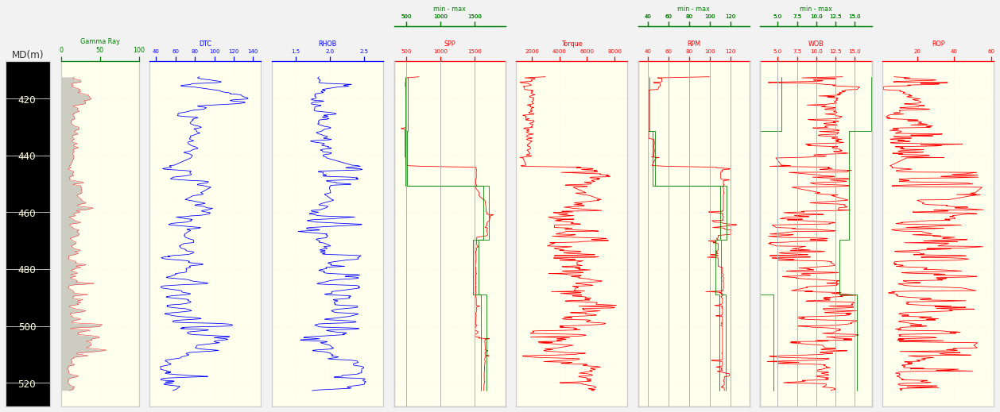

In [ ]:
well_R = proba.loc[(proba.loc[:,'Well'] == 'well_R') & (proba.loc[:,'Formation'] == 'form_A')]
fun_pso_results_vizual(well_R)

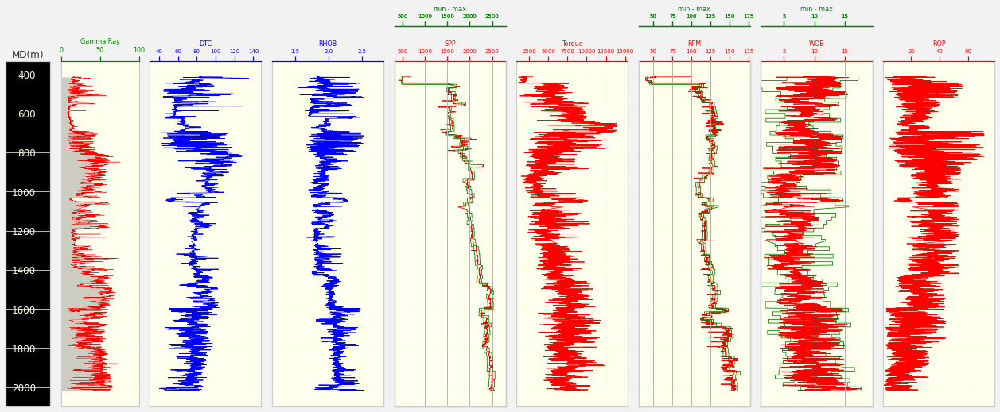

In [ ]:
well_R = proba.loc[(proba.loc[:,'Well'] == 'well_R') ]
fun_pso_results_vizual(well_R)

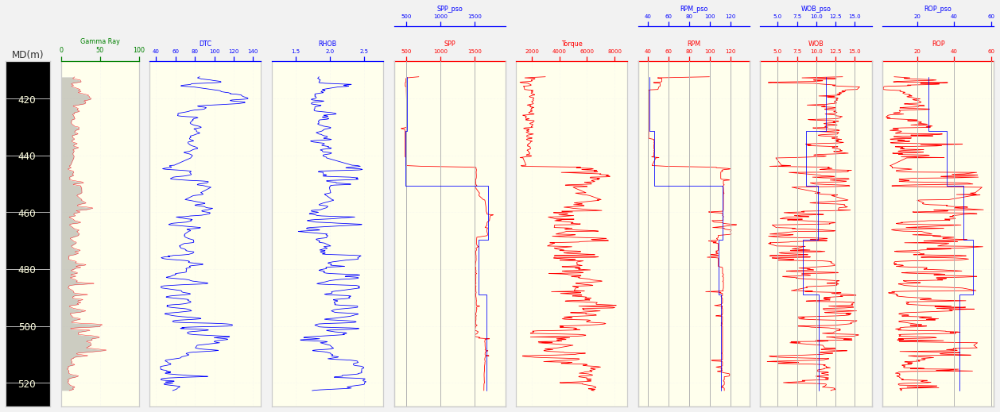

In [ ]:
well_R = proba.loc[(proba.loc[:,'Well'] == 'well_R') & (proba.loc[:,'Formation'] == 'form_A')]
fun_pso_results_vizual(well_R)

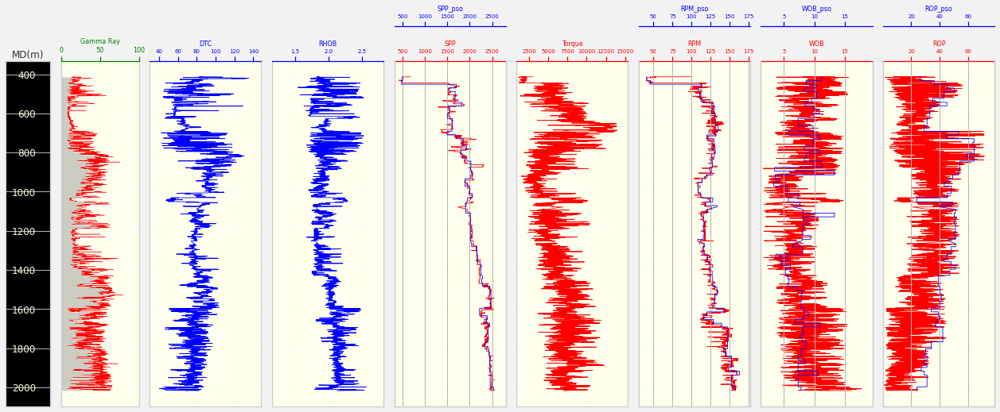

In [ ]:
well_R = proba.loc[(proba.loc[:,'Well'] == 'well_R') ]
fun_pso_results_vizual(well_R)

### well_T

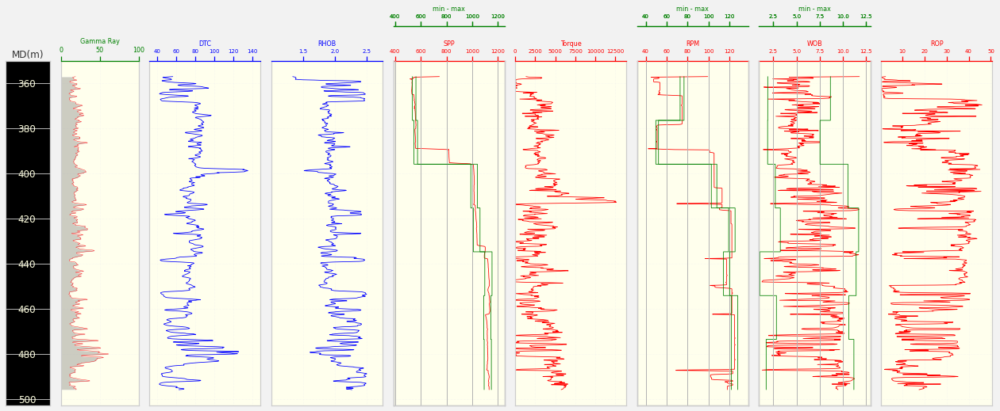

In [ ]:
well_T = proba.loc[(proba.loc[:,'Well'] == 'well_T') & (proba.loc[:,'Formation'] == 'form_A')]
fun_pso_results_vizual(well_T)

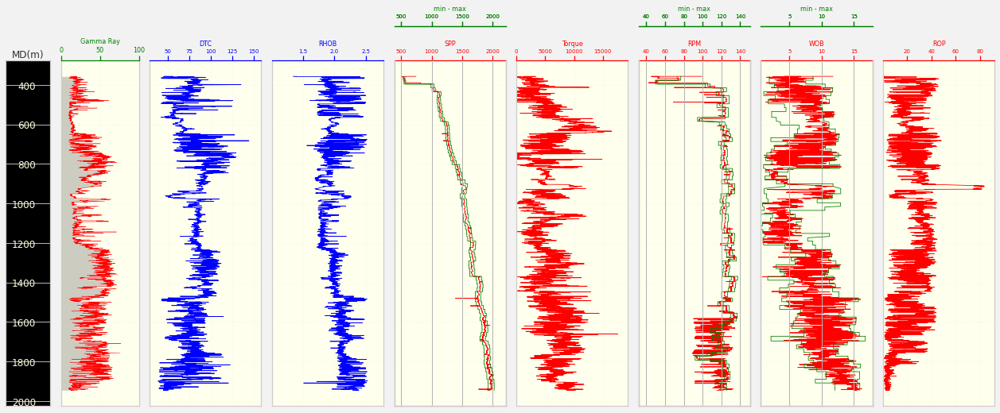

In [ ]:
well_T = proba.loc[(proba.loc[:,'Well'] == 'well_T') ]
fun_pso_results_vizual(well_T)

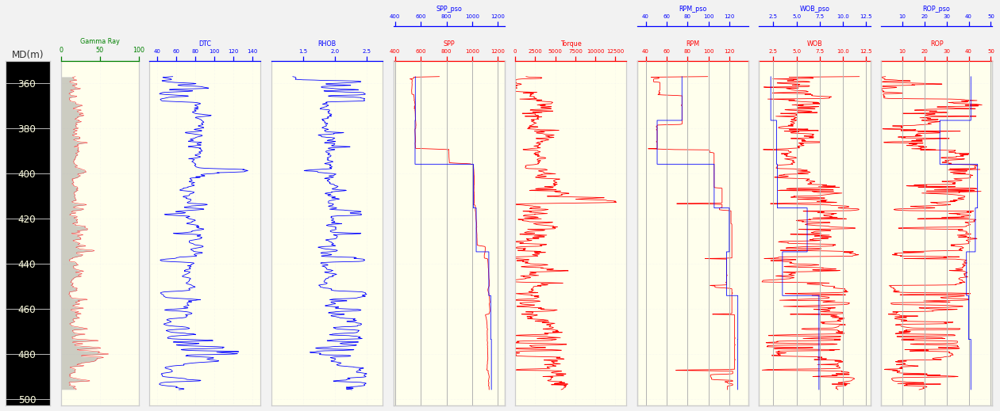

In [ ]:
well_T = proba.loc[(proba.loc[:,'Well'] == 'well_T') & (proba.loc[:,'Formation'] == 'form_A')]
fun_pso_results_vizual(well_T)

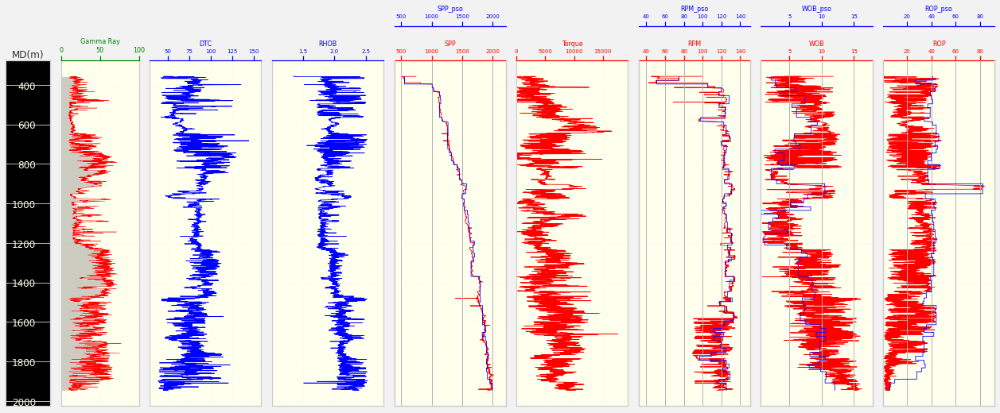

In [ ]:
well_T = proba.loc[(proba.loc[:,'Well'] == 'well_T') ]
fun_pso_results_vizual(well_T)